In [1]:
import os
import random
import shutil
import xml.etree.ElementTree as ET
from PIL import Image
from skimage.feature import hog
from skimage.io import imread
from skimage.color import rgb2gray
import numpy as np
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    classification_report,
    average_precision_score
)
from joblib import dump, load
import optuna
from skimage.transform import resize
from PIL import Image, ImageDraw
from IPython.display import Image as IPImage

In [2]:
base_path = "/kaggle/input/inriaperson"
train_img_dir = os.path.join(base_path, "Train", "JPEGImages")
train_ann_dir = os.path.join(base_path, "Train", "Annotations")
test_img_dir = os.path.join(base_path, "Test", "JPEGImages")
test_ann_dir = os.path.join(base_path, "Test", "Annotations")

positive_dir_train = "/kaggle/working/positive_train"
negative_dir_train = "/kaggle/working/negative_train"
positive_dir_test = "/kaggle/working/positive_test"
negative_dir_test = "/kaggle/working/negative_test"

os.makedirs(positive_dir_train, exist_ok=True)
os.makedirs(negative_dir_train, exist_ok=True)
os.makedirs(positive_dir_test, exist_ok=True)
os.makedirs(negative_dir_test, exist_ok=True)

def generate_positive_samples(image_path, annotation_path, save_dir):
    try:
        image = Image.open(image_path)
        tree = ET.parse(annotation_path)
        root = tree.getroot()
        for idx, obj in enumerate(root.findall('object')):
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)
            crop = image.crop((xmin, ymin, xmax, ymax))
            crop = crop.resize((64, 128))
            filename = f"{os.path.splitext(os.path.basename(image_path))[0]}_pos_{idx}.jpg"
            crop.save(os.path.join(save_dir, filename))
    except:
        pass

def generate_negative_samples(image_path, annotation_path, save_dir, num_samples=20):
    try:
        image = Image.open(image_path)
        width, height = image.size
        tree = ET.parse(annotation_path)
        root = tree.getroot()
        boxes = []
        for obj in root.findall('object'):
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)
            boxes.append((xmin, ymin, xmax, ymax))

        def is_overlap(x, y, w, h):
            for (xmin, ymin, xmax, ymax) in boxes:
                if not (x + w < xmin or x > xmax or y + h < ymin or y > ymax):
                    return True
            return False

        count = 0
        for _ in range(num_samples * 3):
            w, h = 64, 128
            x = random.randint(0, width - w)
            y = random.randint(0, height - h)
            if not is_overlap(x, y, w, h):
                crop = image.crop((x, y, x + w, y + h))
                filename = f"{os.path.splitext(os.path.basename(image_path))[0]}_neg_{count}.jpg"
                crop.save(os.path.join(save_dir, filename))
                count += 1
                if count >= num_samples:
                    break
    except:
        pass

for img_file in os.listdir(train_img_dir):
    if img_file.endswith((".jpg", ".png")):
        img_path = os.path.join(train_img_dir, img_file)
        ann_path = os.path.join(train_ann_dir, os.path.splitext(img_file)[0] + ".xml")
        if os.path.exists(ann_path):
            generate_positive_samples(img_path, ann_path, positive_dir_train)
            generate_negative_samples(img_path, ann_path, negative_dir_train)

for img_file in os.listdir(test_img_dir):
    if img_file.endswith((".jpg", ".png")):
        img_path = os.path.join(test_img_dir, img_file)
        ann_path = os.path.join(test_ann_dir, os.path.splitext(img_file)[0] + ".xml")
        if os.path.exists(ann_path):
            generate_positive_samples(img_path, ann_path, positive_dir_test)
            generate_negative_samples(img_path, ann_path, negative_dir_test)


In [3]:
positive_count_train = len([f for f in os.listdir(positive_dir_train) if f.endswith('.jpg')])
negative_count_train = len([f for f in os.listdir(negative_dir_train) if f.endswith('.jpg')])

positive_count_test = len([f for f in os.listdir(positive_dir_test) if f.endswith('.jpg')])
negative_count_test = len([f for f in os.listdir(negative_dir_test) if f.endswith('.jpg')])

print("Số lượng ảnh trong tập train:")
print(f"  Số ảnh positive: {positive_count_train}")
print(f"  Số ảnh negative: {negative_count_train}")

print("\nSố lượng ảnh trong tập test:")
print(f"  Số ảnh positive: {positive_count_test}")
print(f"  Số ảnh negative: {negative_count_test}")


Số lượng ảnh trong tập train:
  Số ảnh positive: 1240
  Số ảnh negative: 12004

Số lượng ảnh trong tập test:
  Số ảnh positive: 597
  Số ảnh negative: 5519


In [4]:
def extract_hog_features(image_dir, label):
    features = []
    labels = []
    for filename in os.listdir(image_dir):
        if filename.endswith((".jpg", ".png")):
            img_path = os.path.join(image_dir, filename)
            try:
                image = imread(img_path)
                image = rgb2gray(image)
                image = np.resize(image, (128, 64))

                hog_feat = hog(image, orientations=9, pixels_per_cell=(8, 8),
                               cells_per_block=(2, 2), block_norm='L2-Hys')
                features.append(hog_feat)
                labels.append(label)
            except:
                pass
    return features, labels

pos_features_train, pos_labels_train = extract_hog_features(positive_dir_train, 1)
neg_features_train, neg_labels_train = extract_hog_features(negative_dir_train, 0)

X_train = np.array(pos_features_train + neg_features_train)
y_train = np.array(pos_labels_train + neg_labels_train)

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

pos_features_test, pos_labels_test = extract_hog_features(positive_dir_test, 1)
neg_features_test, neg_labels_test = extract_hog_features(negative_dir_test, 0)

X_test = np.array(pos_features_test + neg_features_test)
y_test = np.array(pos_labels_test + neg_labels_test)

print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)

X_train shape: (13244, 3780)
y_train shape: (13244,)
X_test shape: (6116, 3780)
y_test shape: (6116,)


In [5]:
def objective(trial):
    C = trial.suggest_float("C", 1e-4, 1e2, log=True)
    kernel = trial.suggest_categorical("kernel", ["linear", "rbf"])
    gamma = trial.suggest_categorical("gamma", ["scale", "auto"]) if kernel == "rbf" else "scale"
    max_iter = trial.suggest_int("max_iter", 100, 1000, step=100)
    model = make_pipeline(
        StandardScaler(),
        SVC(
            C=C,
            kernel=kernel,
            gamma=gamma,
            class_weight='balanced',
            max_iter=max_iter,
            probability=True
        )
    )
    model.fit(X_train, y_train)

    preds_test = model.predict(X_test)

    test_acc = accuracy_score(y_test, preds_test)
    precision = precision_score(y_test, preds_test)
    recall = recall_score(y_test, preds_test)
    f1 = f1_score(y_test, preds_test)

    print(f"[Trial {trial.number}] C={C:.5f}, kernel={kernel}, gamma={gamma}, max_iter={max_iter}")
    print(f"  Test Acc: {test_acc:.3f}")
    print(f"  Precision: {precision:.3f}, Recall: {recall:.3f}, F1: {f1:.3f}\n")

    return f1

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=10)

print("\nBest parameters:", study.best_params)
print("Best F1-score:", study.best_value)

final_model = make_pipeline(
    StandardScaler(),
    SVC(
        C=study.best_params["C"],
        kernel=study.best_params["kernel"],
        gamma=study.best_params.get("gamma", "scale"),
        class_weight='balanced',
        max_iter=study.best_params["max_iter"],
        probability=True
    )
)
final_model.fit(X_train, y_train)

dump(final_model, "/kaggle/working/hog_svm_model_optuna.joblib")

[I 2025-06-18 08:01:34,191] A new study created in memory with name: no-name-934f2bd6-26e0-4f48-9ac6-d85a17ac6ca4
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=900).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:04:29,612] Trial 0 finished with value: 0.8986254295532646 and parameters: {'C': 36.72637377930161, 'kernel': 'linear', 'max_iter': 900}. Best is trial 0 with value: 0.8986254295532646.


[Trial 0] C=36.72637, kernel=linear, gamma=scale, max_iter=900
  Test Acc: 0.981
  Precision: 0.922, Recall: 0.876, F1: 0.899



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=900).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:09:40,810] Trial 1 finished with value: 0.17786384626843435 and parameters: {'C': 0.011487359243638398, 'kernel': 'rbf', 'gamma': 'scale', 'max_iter': 900}. Best is trial 0 with value: 0.8986254295532646.


[Trial 1] C=0.01149, kernel=rbf, gamma=scale, max_iter=900
  Test Acc: 0.098
  Precision: 0.098, Recall: 1.000, F1: 0.178



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:14:37,146] Trial 2 finished with value: 0.8897576231430805 and parameters: {'C': 0.00025515745844082463, 'kernel': 'linear', 'max_iter': 1000}. Best is trial 0 with value: 0.8986254295532646.


[Trial 2] C=0.00026, kernel=linear, gamma=scale, max_iter=1000
  Test Acc: 0.977
  Precision: 0.834, Recall: 0.953, F1: 0.890



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=200).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:15:44,119] Trial 3 finished with value: 0.17786384626843435 and parameters: {'C': 0.00403821282679083, 'kernel': 'rbf', 'gamma': 'auto', 'max_iter': 200}. Best is trial 0 with value: 0.8986254295532646.


[Trial 3] C=0.00404, kernel=rbf, gamma=auto, max_iter=200
  Test Acc: 0.098
  Precision: 0.098, Recall: 1.000, F1: 0.178



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=300).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:17:37,313] Trial 4 finished with value: 0.17786384626843435 and parameters: {'C': 0.02692356270820606, 'kernel': 'rbf', 'gamma': 'auto', 'max_iter': 300}. Best is trial 0 with value: 0.8986254295532646.


[Trial 4] C=0.02692, kernel=rbf, gamma=auto, max_iter=300
  Test Acc: 0.098
  Precision: 0.098, Recall: 1.000, F1: 0.178



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=100).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:18:26,117] Trial 5 finished with value: 0.8465690053970701 and parameters: {'C': 13.467692489975883, 'kernel': 'rbf', 'gamma': 'scale', 'max_iter': 100}. Best is trial 0 with value: 0.8986254295532646.


[Trial 5] C=13.46769, kernel=rbf, gamma=scale, max_iter=100
  Test Acc: 0.967
  Precision: 0.784, Recall: 0.920, F1: 0.847



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=200).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:19:42,491] Trial 6 finished with value: 0.856447688564477 and parameters: {'C': 20.88293417211081, 'kernel': 'linear', 'max_iter': 200}. Best is trial 0 with value: 0.8986254295532646.


[Trial 6] C=20.88293, kernel=linear, gamma=scale, max_iter=200
  Test Acc: 0.971
  Precision: 0.830, Recall: 0.884, F1: 0.856



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=300).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:21:27,382] Trial 7 finished with value: 0.8760611205432937 and parameters: {'C': 0.03244513392250442, 'kernel': 'linear', 'max_iter': 300}. Best is trial 0 with value: 0.8986254295532646.


[Trial 7] C=0.03245, kernel=linear, gamma=scale, max_iter=300
  Test Acc: 0.976
  Precision: 0.888, Recall: 0.864, F1: 0.876



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:27:37,079] Trial 8 finished with value: 0.17786384626843435 and parameters: {'C': 0.025495216435827195, 'kernel': 'rbf', 'gamma': 'scale', 'max_iter': 1000}. Best is trial 0 with value: 0.8986254295532646.


[Trial 8] C=0.02550, kernel=rbf, gamma=scale, max_iter=1000
  Test Acc: 0.098
  Precision: 0.098, Recall: 1.000, F1: 0.178



/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=200).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(
[I 2025-06-18 08:29:20,928] Trial 9 finished with value: 0.9246401354784082 and parameters: {'C': 64.44528408885347, 'kernel': 'rbf', 'gamma': 'auto', 'max_iter': 200}. Best is trial 9 with value: 0.9246401354784082.


[Trial 9] C=64.44528, kernel=rbf, gamma=auto, max_iter=200
  Test Acc: 0.985
  Precision: 0.935, Recall: 0.915, F1: 0.925


Best parameters: {'C': 64.44528408885347, 'kernel': 'rbf', 'gamma': 'auto', 'max_iter': 200}
Best F1-score: 0.9246401354784082


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=200).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


['/kaggle/working/hog_svm_model_optuna.joblib']

Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


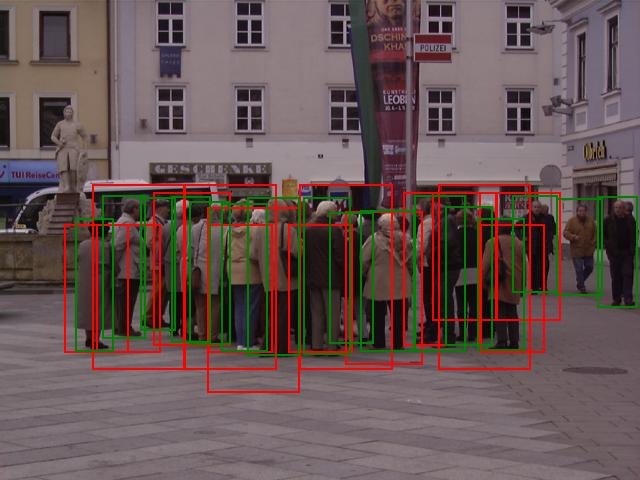

In [6]:
model = load("/kaggle/input/model_hogsvm/scikitlearn/default/1/hog_svm_model_optuna.joblib")

def extract_hog(image):
    image = rgb2gray(image)
    image = resize(image, (128, 64))
    hog_feat = hog(
        image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm='L2-Hys'
    )
    return hog_feat

def non_max_suppression(boxes, scores, iou_threshold=0.5):
    if len(boxes) == 0:
        return [], []
    
    boxes = np.array(boxes)
    scores = np.array(scores)
    
    x1, y1, x2, y2 = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    areas = (x2 - x1 + 1) * (y2 - y1 + 1)
    
    order = scores.argsort()[::-1]
    
    keep = []
    while order.size > 0:
        i = order[0]
        keep.append(i)
        
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])
        
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)
        inter = w * h
        iou = inter / (areas[i] + areas[order[1:]] - inter)
        
        inds = np.where(iou <= iou_threshold)[0]
        order = order[inds + 1]
    
    return boxes[keep].tolist(), scores[keep].tolist()

def sliding_window(image, step_size=16, window_size=(128, 64)):
    h, w = image.shape[:2]
    boxes = []
    scores = []
    for y in range(0, h - window_size[0] + 1, step_size):
        for x in range(0, w - window_size[1] + 1, step_size):
            window = image[y:y + window_size[0], x:x + window_size[1]]
            if window.shape[:2] == window_size:
                hog_feat = extract_hog(window)
                score = model.predict_proba([hog_feat])[0][1]
                if score > 0.5:
                    boxes.append([x, y, x + window_size[1], y + window_size[0]])
                    scores.append(score)
    
    return boxes, scores

def get_ground_truth(annotation_path):
    try:
        tree = ET.parse(annotation_path)
        root = tree.getroot()
        gt_boxes = []
        for obj in root.findall('object'):
            bbox = obj.find('bndbox')
            xmin = int(bbox.find('xmin').text)
            ymin = int(bbox.find('ymin').text)
            xmax = int(bbox.find('xmax').text)
            ymax = int(bbox.find('ymax').text)
            gt_boxes.append([xmin, ymin, xmax, ymax])
        return gt_boxes
    except Exception as e:
        print(f"Lỗi khi đọc file annotation {annotation_path}: {str(e)}")
        return []

def detect_persons(image_path, step_size=16, scale_factor=1.2, min_size=(128, 64), max_size=None):
    try:
        image = imread(image_path)
        orig_h, orig_w = image.shape[:2]
        all_boxes = []
        all_scores = []
        
        pyramid = [image]
        current_h, current_w = orig_h, orig_w
        while (max_size is None or (current_h > min_size[0] and current_w > min_size[1])) and (max_size is None or (current_h <= max_size[0] and current_w <= max_size[1])):
            current_h = int(current_h / scale_factor)
            current_w = int(current_w / scale_factor)
            if current_h < min_size[0] or current_w < min_size[1]:
                break
            scaled_image = resize(image, (current_h, current_w))
            pyramid.append(scaled_image)
        
        for scaled_image in pyramid:
            h, w = scaled_image.shape[:2]
            boxes, scores = sliding_window(scaled_image, step_size=step_size, window_size=(128, 64))
            scale = orig_h / h
            boxes = [[int(x * scale) for x in box] for box in boxes]
            all_boxes.extend(boxes)
            all_scores.extend(scores)
        
        final_boxes, final_scores = non_max_suppression(all_boxes, all_scores, iou_threshold=0.5)
        
        annotation_path = os.path.join("/kaggle/input/inriaperson/Test/Annotations",
                                       os.path.splitext(os.path.basename(image_path))[0] + ".xml")
        gt_boxes = get_ground_truth(annotation_path)
        
        image_pil = Image.fromarray(image)
        draw = ImageDraw.Draw(image_pil)
        
        for box in final_boxes:
            draw.rectangle(box, outline="red", width=2)
        
        for gt_box in gt_boxes:
            draw.rectangle(gt_box, outline="green", width=2)
        
        output_path = "/kaggle/working/output_image.jpg"
        image_pil.save(output_path)
        print(f"Ảnh kết quả đã được lưu tại: {output_path}")
        
        display(IPImage(output_path))
        
        return final_boxes, final_scores
    except Exception as e:
        print(f"Lỗi khi xử lý ảnh {image_path}: {str(e)}")
        return [], []

image_path = "/kaggle/input/inriaperson/Test/JPEGImages/person_200.png"
final_boxes, final_scores = detect_persons(image_path, step_size=16, scale_factor=1.2, min_size=(128, 64))


Tổng số ảnh trong tập test: 288
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


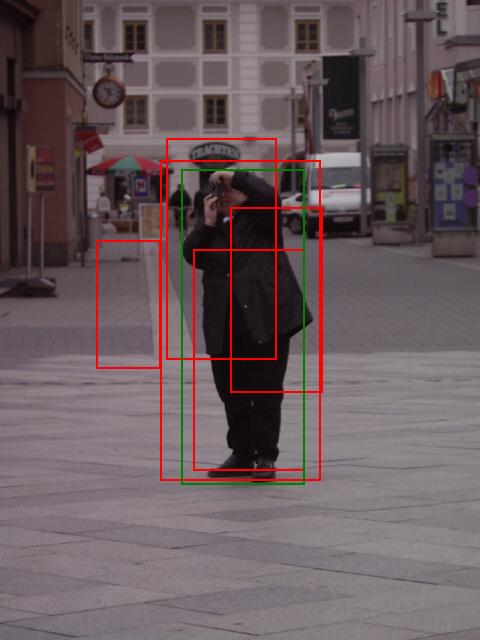

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_089.png (Ảnh thứ 1/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


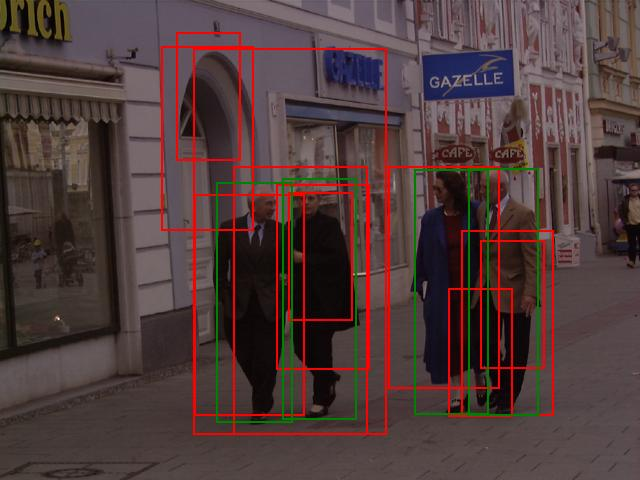

AP@IoU=0.50: 0.5242
AP@IoU=0.55: 0.5242
AP@IoU=0.60: 0.5242
AP@IoU=0.65: 0.0227
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_249.png (Ảnh thứ 2/288): Precision=0.3636, Recall=1.0000, F1=0.5333, Accuracy=0.3636, mAP@0.5:0.95=0.1595, mAR@0.5:0.95=0.3250
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


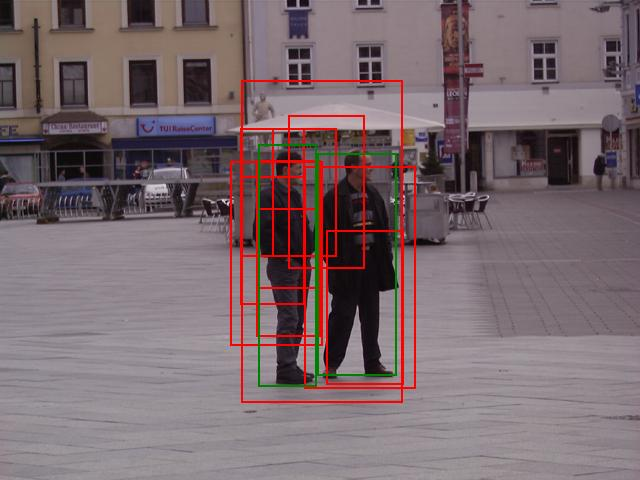

AP@IoU=0.50: 0.5833
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_247.png (Ảnh thứ 3/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.1083, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


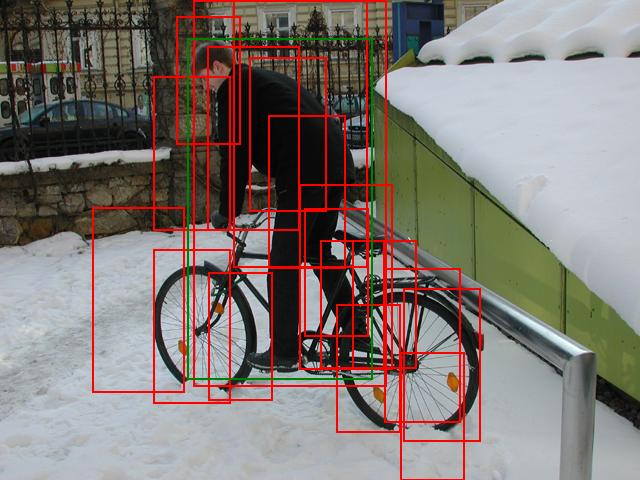

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_109.png (Ảnh thứ 4/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


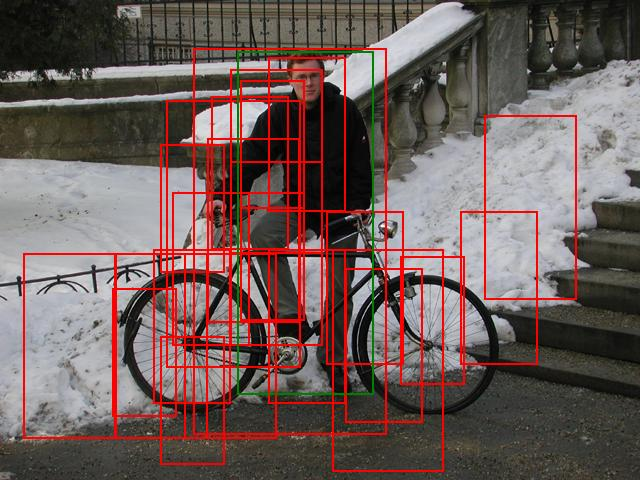

AP@IoU=0.50: 0.0833
AP@IoU=0.55: 0.0833
AP@IoU=0.60: 0.0833
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_094.png (Ảnh thứ 5/288): Precision=0.0417, Recall=1.0000, F1=0.0800, Accuracy=0.0417, mAP@0.5:0.95=0.0250, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


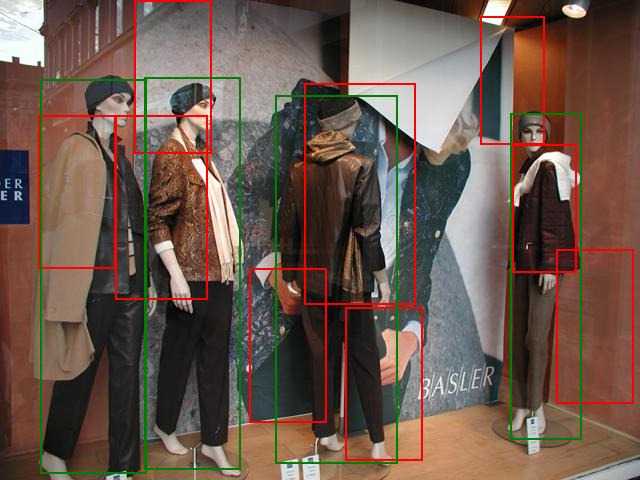

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_350.png (Ảnh thứ 6/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


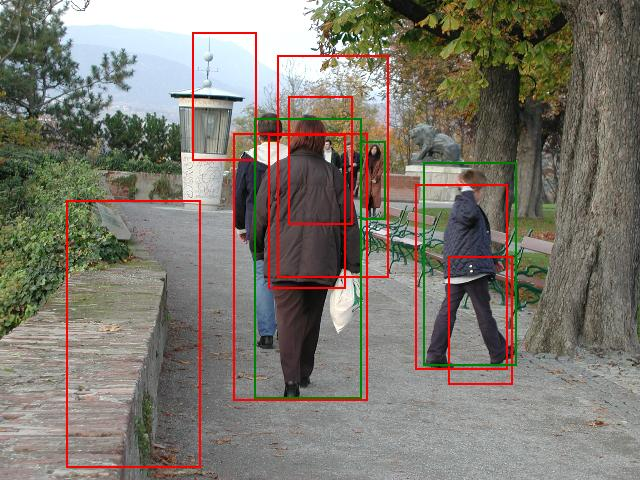

AP@IoU=0.50: 0.2778
AP@IoU=0.55: 0.2778
AP@IoU=0.60: 0.2778
AP@IoU=0.65: 0.2778
AP@IoU=0.70: 0.2778
AP@IoU=0.75: 0.0556
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.6667
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_347.png (Ảnh thứ 7/288): Precision=0.2500, Recall=0.6667, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.1444, mAR@0.5:0.95=0.3667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


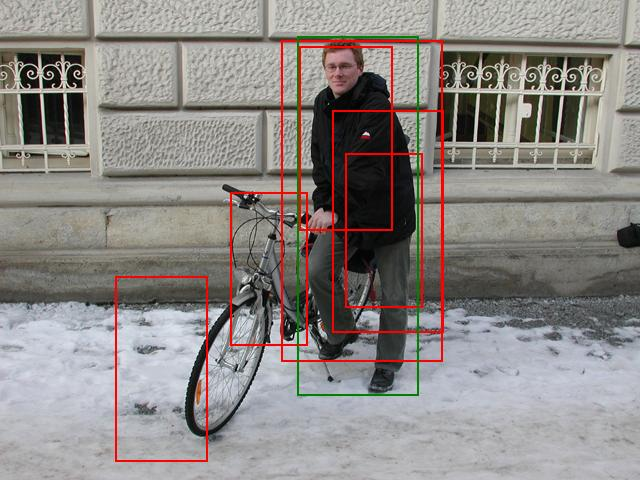

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_049.png (Ảnh thứ 8/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


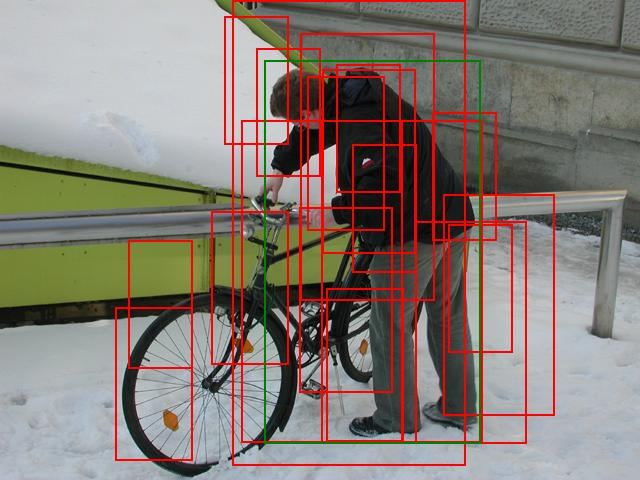

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_104.png (Ảnh thứ 9/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.3333, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


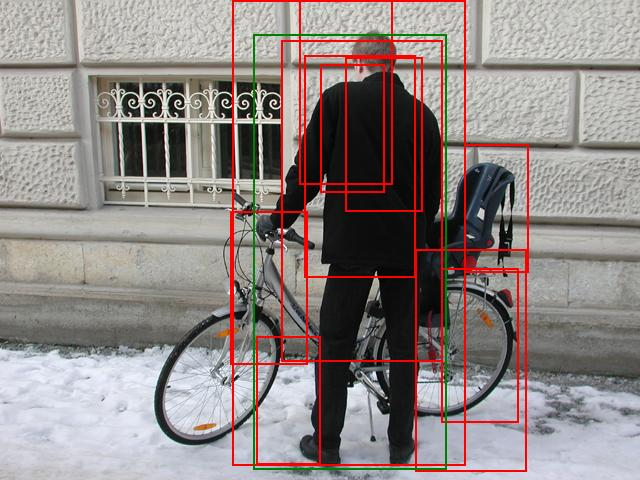

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_050.png (Ảnh thứ 10/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


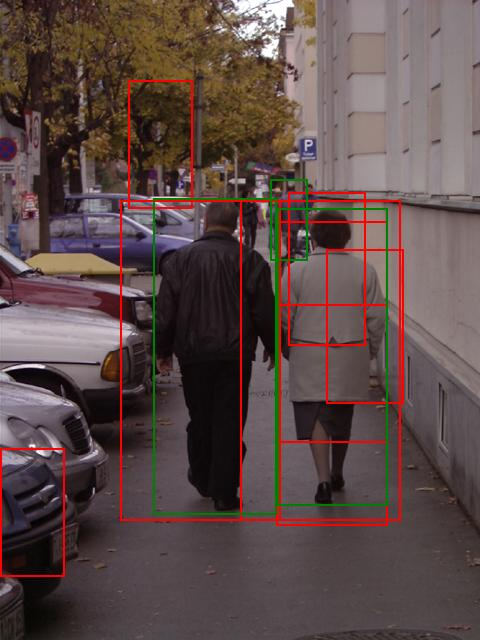

AP@IoU=0.50: 0.5556
AP@IoU=0.55: 0.5556
AP@IoU=0.60: 0.5556
AP@IoU=0.65: 0.2222
AP@IoU=0.70: 0.2222
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.6667
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_104.png (Ảnh thứ 11/288): Precision=0.2500, Recall=0.6667, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.2222, mAR@0.5:0.95=0.3667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


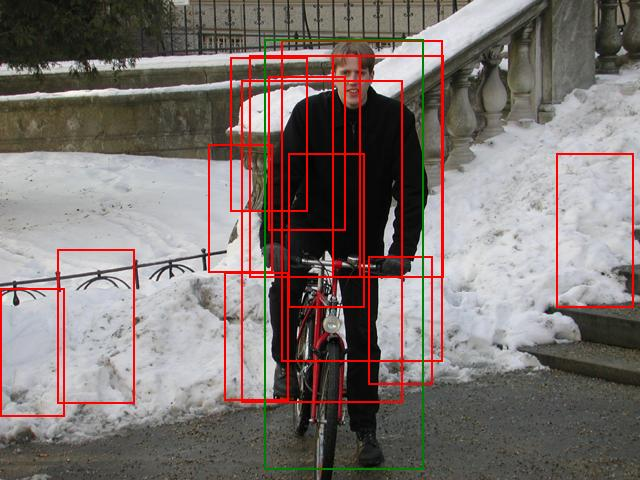

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_160.png (Ảnh thứ 12/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.0750, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


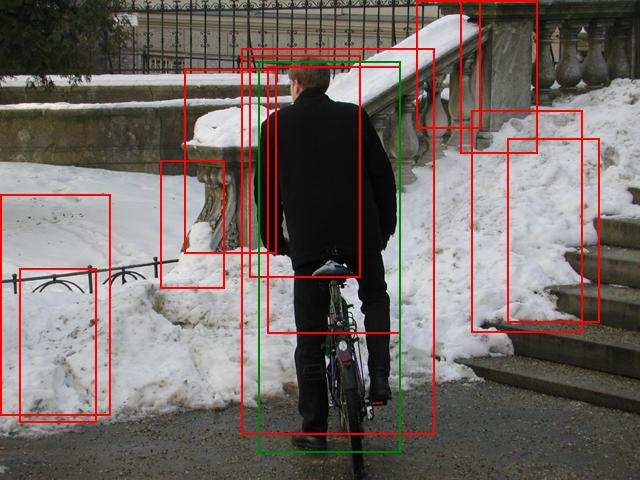

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_159.png (Ảnh thứ 13/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


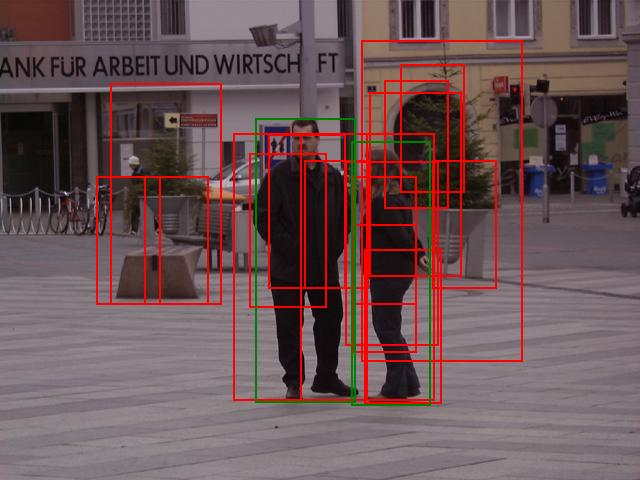

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_133.png (Ảnh thứ 14/288): Precision=0.1176, Recall=1.0000, F1=0.2105, Accuracy=0.1176, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


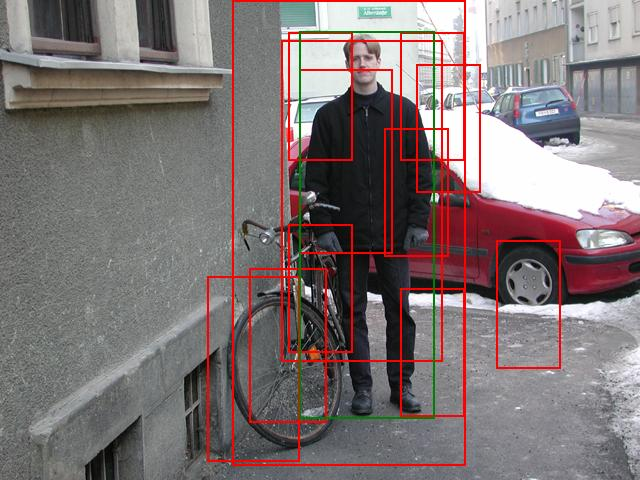

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_082.png (Ảnh thứ 15/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


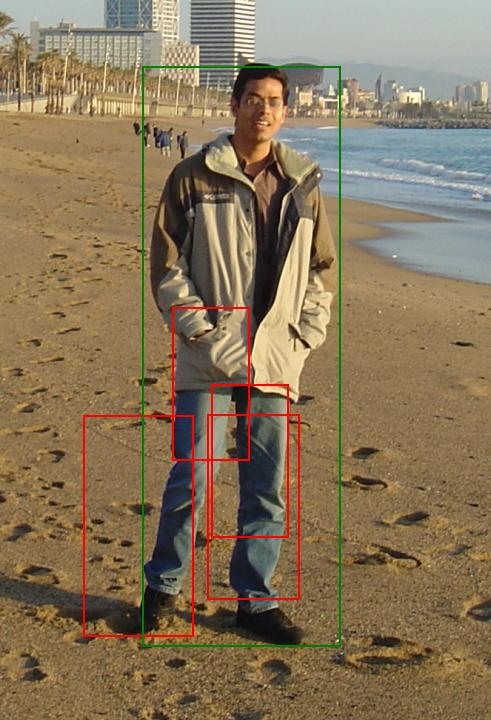

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000001.png (Ảnh thứ 16/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


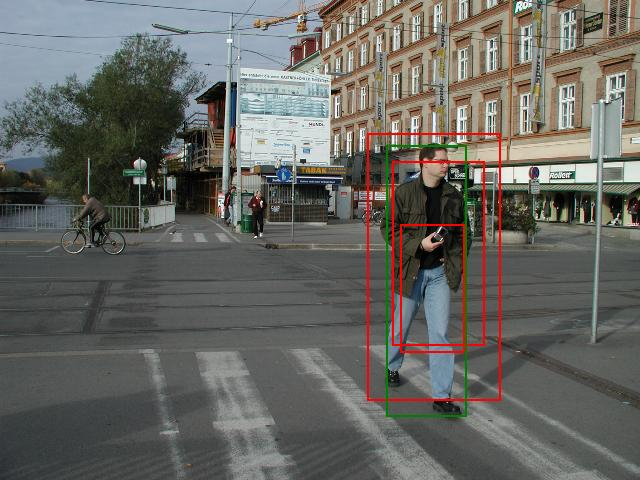

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_153.png (Ảnh thứ 17/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


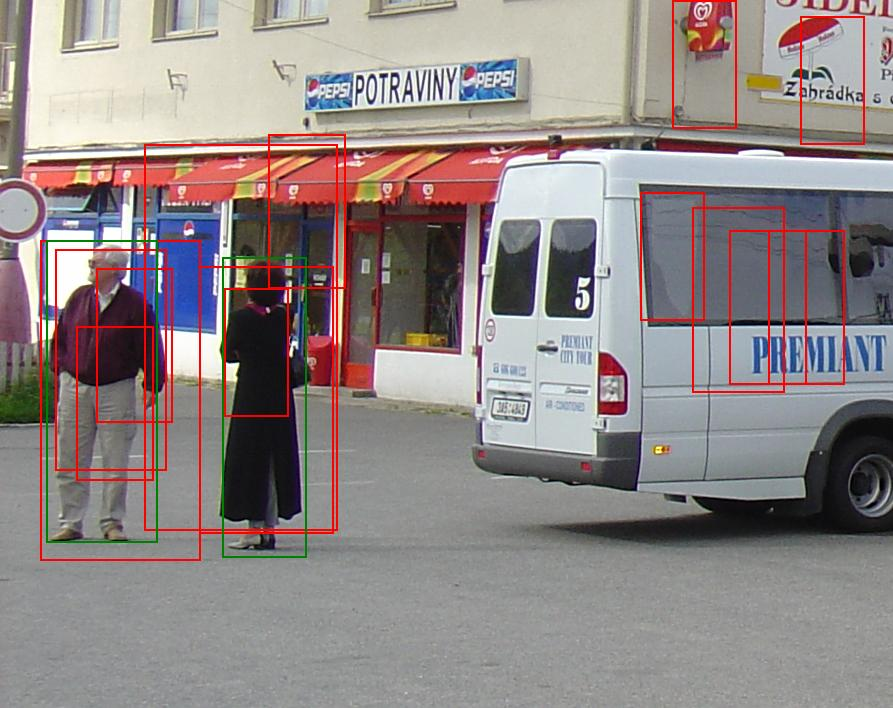

AP@IoU=0.50: 0.5909
AP@IoU=0.55: 0.5909
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001716.png (Ảnh thứ 18/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2182, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


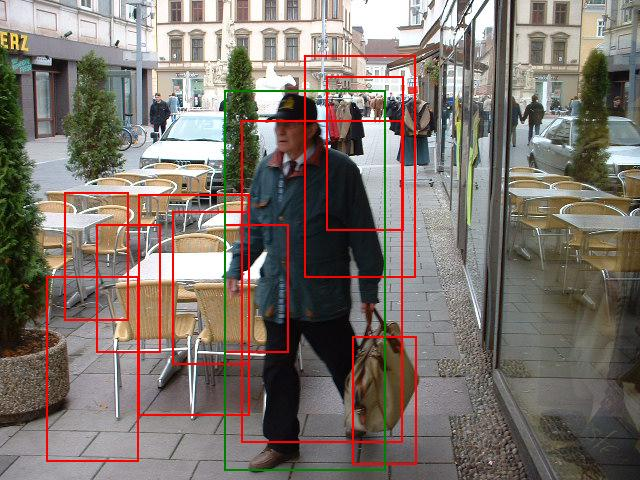

AP@IoU=0.50: 0.1429
AP@IoU=0.55: 0.1429
AP@IoU=0.60: 0.1429
AP@IoU=0.65: 0.1429
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_189.png (Ảnh thứ 19/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.0571, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


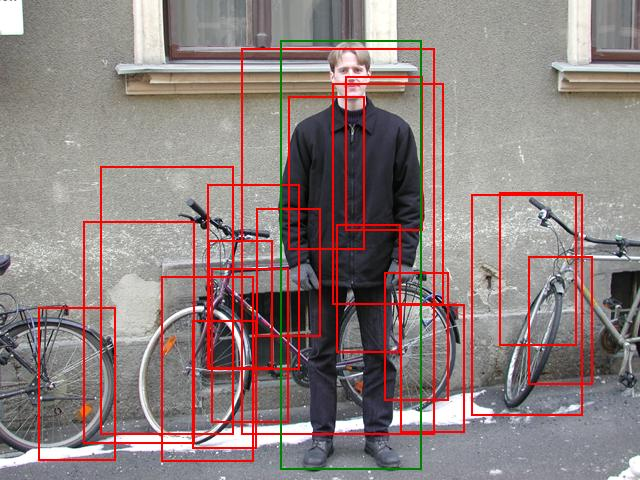

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_081.png (Ảnh thứ 20/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


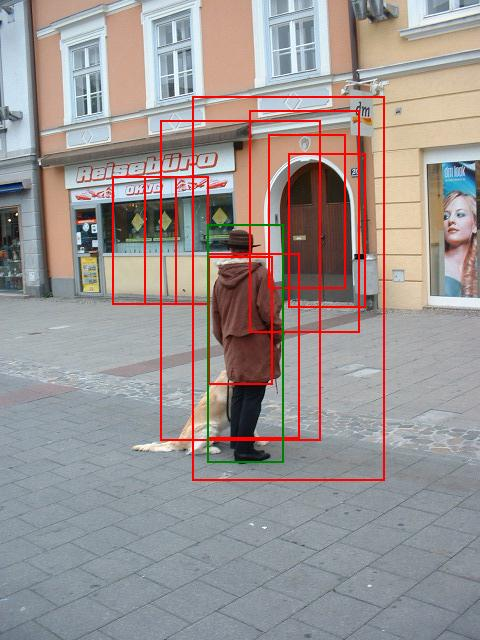

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_122.png (Ảnh thứ 21/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.1333, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


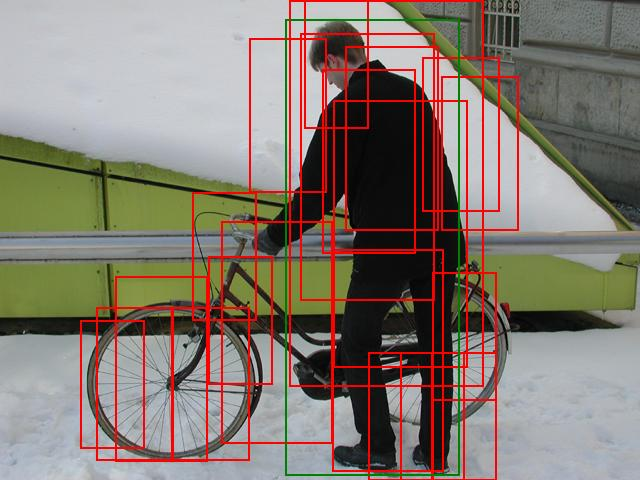

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_097.png (Ảnh thứ 22/288): Precision=0.0476, Recall=1.0000, F1=0.0909, Accuracy=0.0476, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


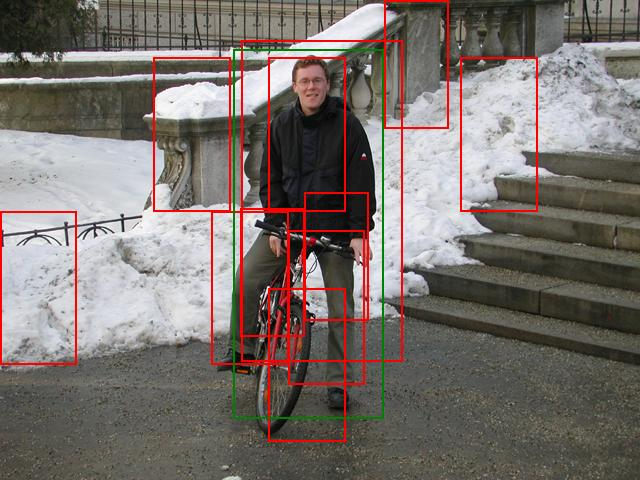

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_161.png (Ảnh thứ 23/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


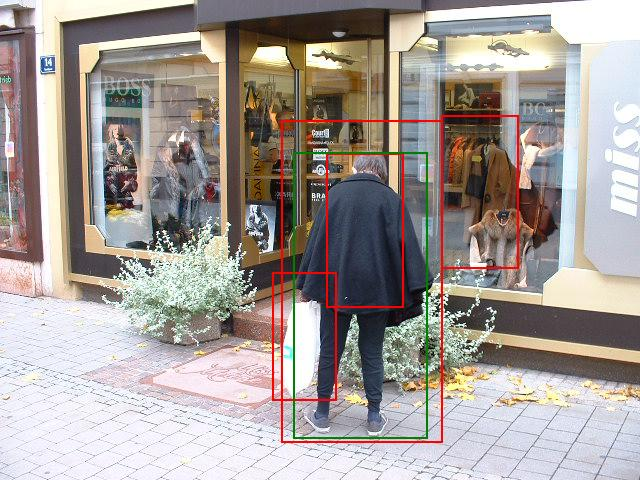

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_290.png (Ảnh thứ 24/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


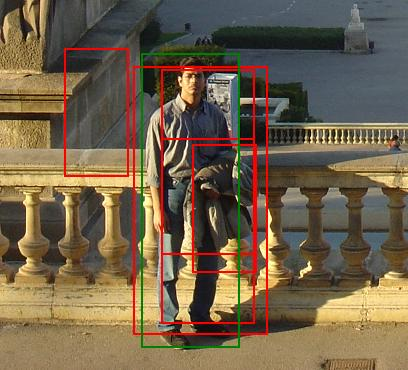

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000004.png (Ảnh thứ 25/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


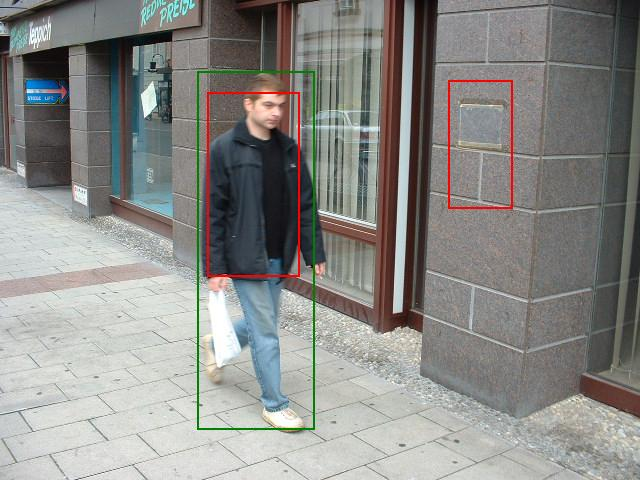

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_071.png (Ảnh thứ 26/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


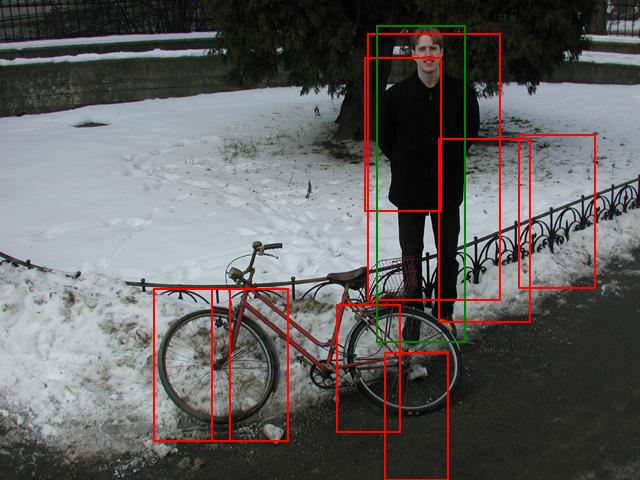

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_077.png (Ảnh thứ 27/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


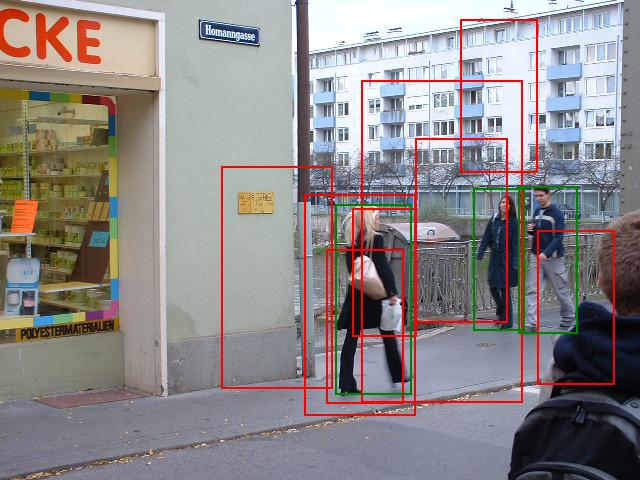

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.3333
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_315.png (Ảnh thứ 28/288): Precision=0.1250, Recall=0.3333, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


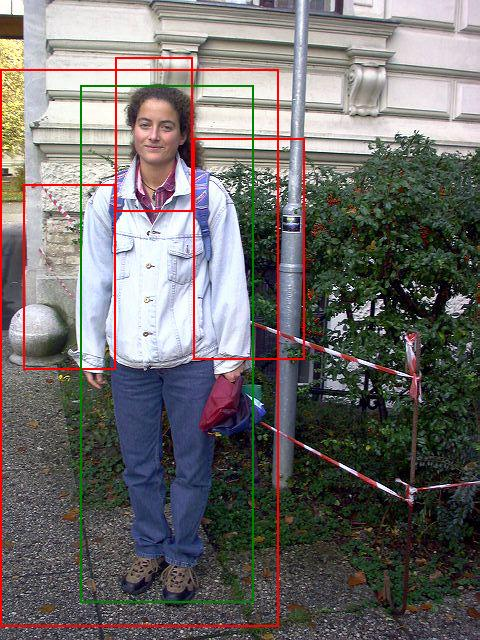

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_029.png (Ảnh thứ 29/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


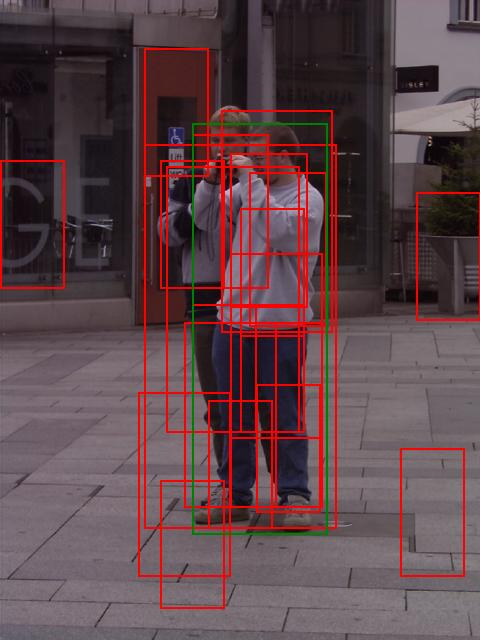

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_092.png (Ảnh thứ 30/288): Precision=0.0476, Recall=1.0000, F1=0.0909, Accuracy=0.0476, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


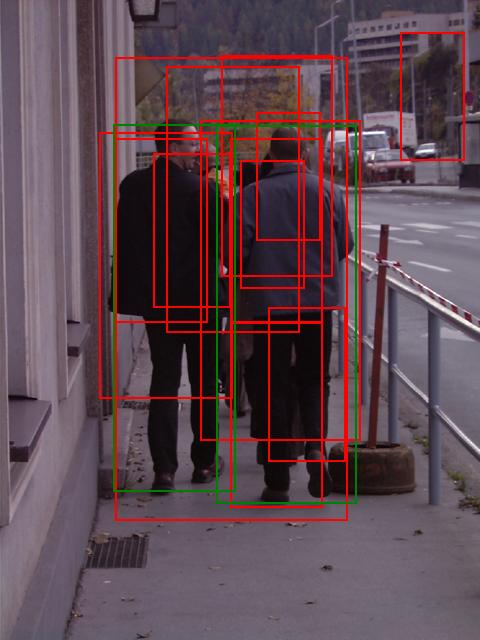

AP@IoU=0.50: 0.1833
AP@IoU=0.55: 0.1833
AP@IoU=0.60: 0.1833
AP@IoU=0.65: 0.1833
AP@IoU=0.70: 0.0833
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_105.png (Ảnh thứ 31/288): Precision=0.1538, Recall=1.0000, F1=0.2667, Accuracy=0.1538, mAP@0.5:0.95=0.0817, mAR@0.5:0.95=0.4500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


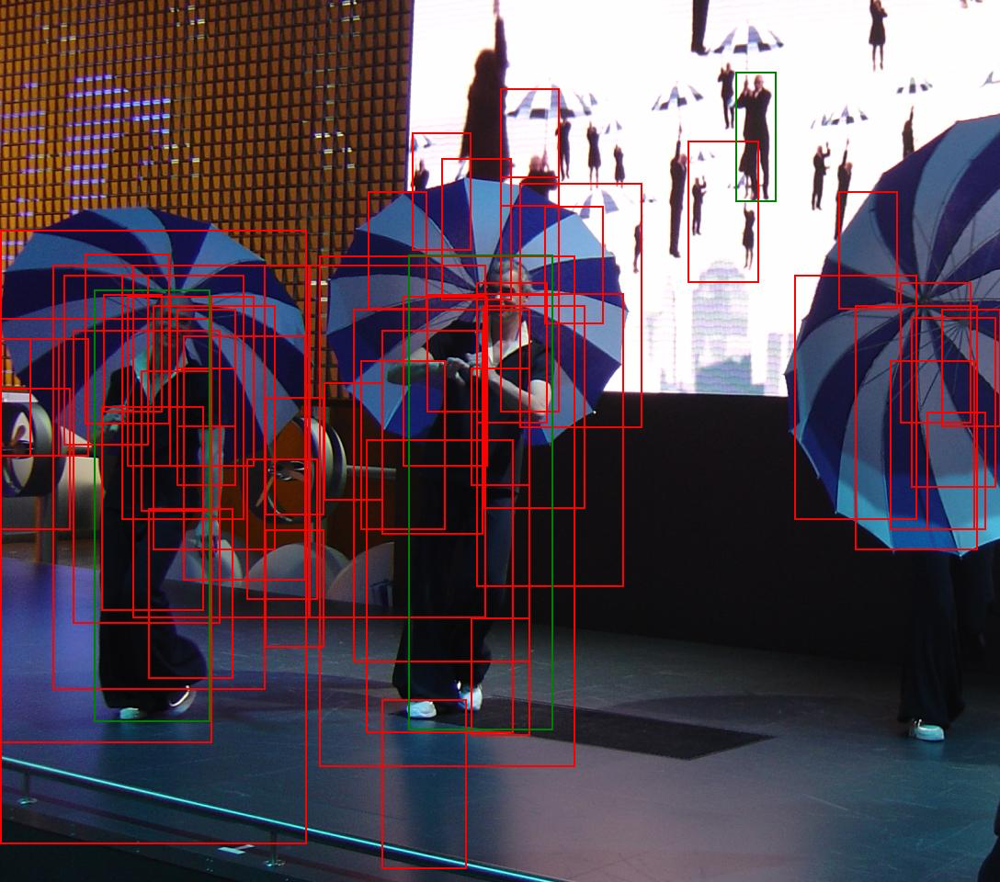

AP@IoU=0.50: 0.0525
AP@IoU=0.55: 0.0303
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001704.png (Ảnh thứ 32/288): Precision=0.0357, Recall=0.6667, F1=0.0678, Accuracy=0.0351, mAP@0.5:0.95=0.0083, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


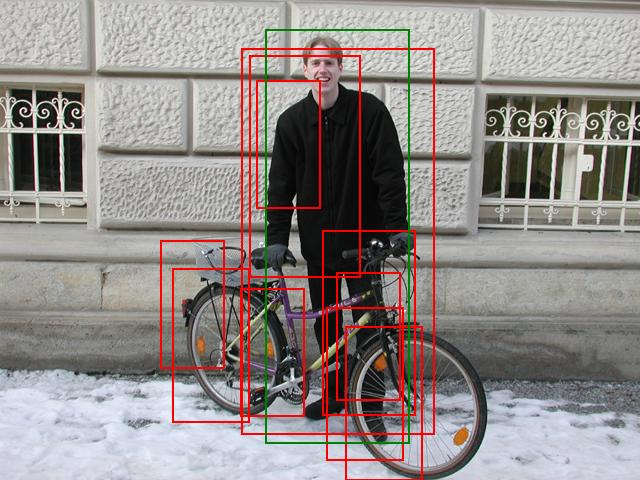

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_052.png (Ảnh thứ 33/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


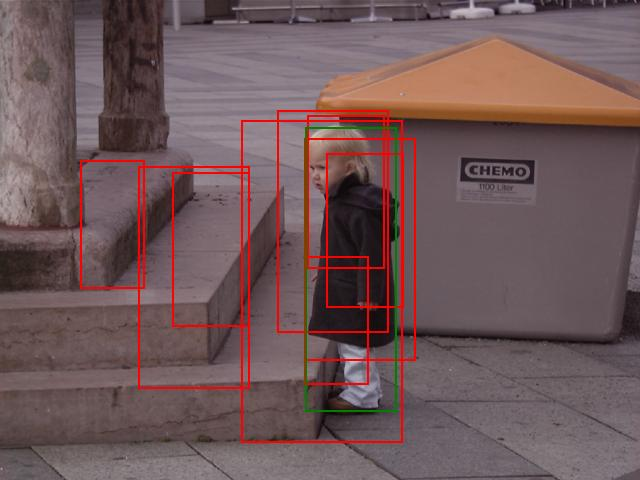

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.1250
AP@IoU=0.65: 0.1250
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_059.png (Ảnh thứ 34/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.0542, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


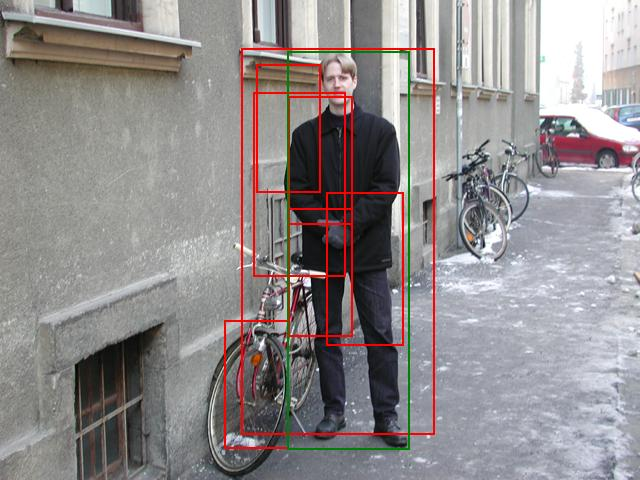

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_079.png (Ảnh thứ 35/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


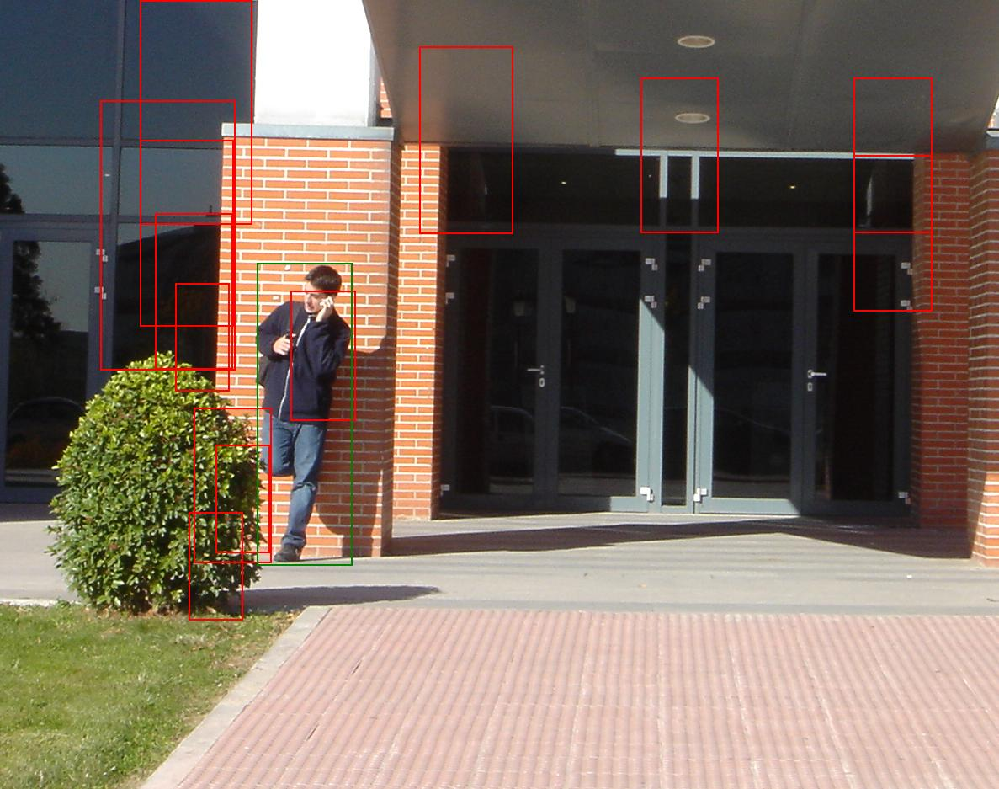

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001660.png (Ảnh thứ 36/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


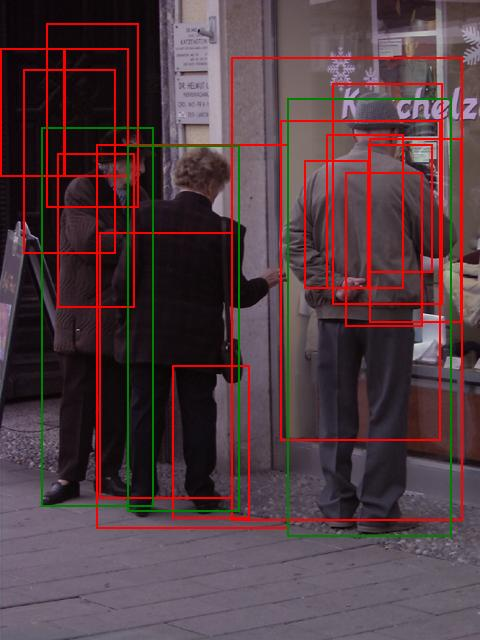

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.6667
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_098.png (Ảnh thứ 37/288): Precision=0.1250, Recall=0.6667, F1=0.2105, Accuracy=0.1176, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


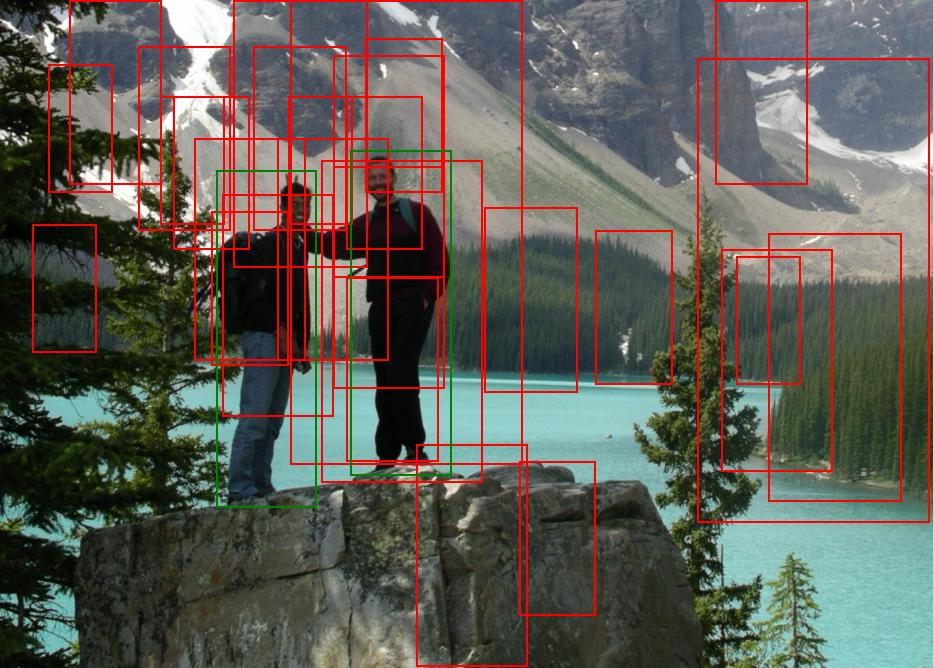

AP@IoU=0.50: 0.5714
AP@IoU=0.55: 0.5714
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001683.png (Ảnh thứ 38/288): Precision=0.0690, Recall=1.0000, F1=0.1290, Accuracy=0.0690, mAP@0.5:0.95=0.1643, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


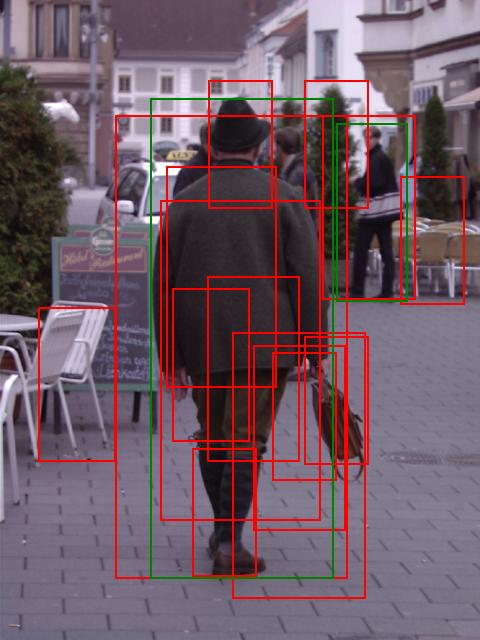

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.8333
AP@IoU=0.60: 0.8333
AP@IoU=0.65: 0.8333
AP@IoU=0.70: 0.8333
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_095.png (Ảnh thứ 39/288): Precision=0.1333, Recall=1.0000, F1=0.2353, Accuracy=0.1333, mAP@0.5:0.95=0.4667, mAR@0.5:0.95=0.5500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


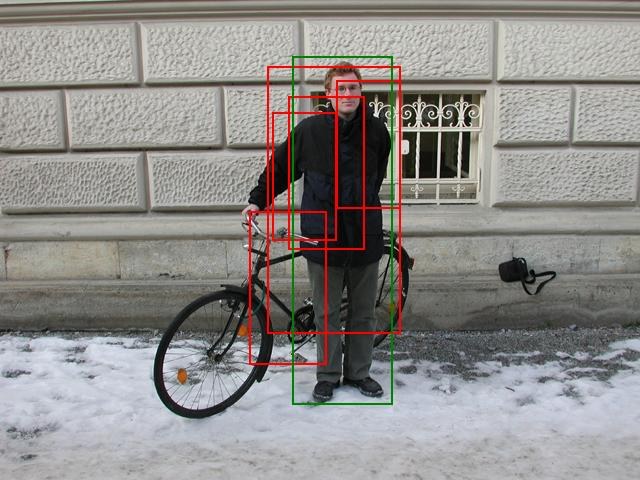

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_047.png (Ảnh thứ 40/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


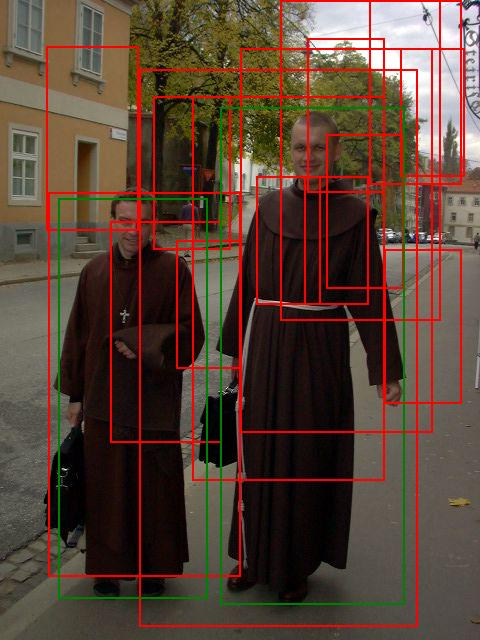

AP@IoU=0.50: 0.2917
AP@IoU=0.55: 0.2917
AP@IoU=0.60: 0.0625
AP@IoU=0.65: 0.0625
AP@IoU=0.70: 0.0625
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_107.png (Ảnh thứ 41/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.0771, mAR@0.5:0.95=0.3500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


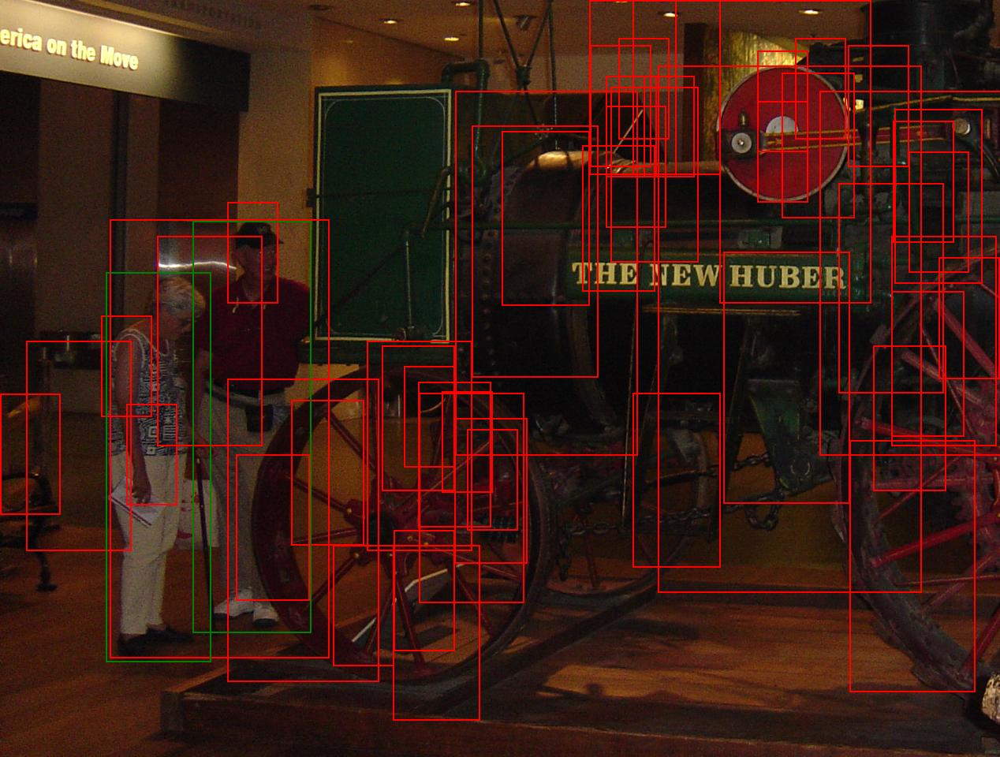

AP@IoU=0.50: 0.0179
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001722.png (Ảnh thứ 42/288): Precision=0.0192, Recall=0.5000, F1=0.0370, Accuracy=0.0189, mAP@0.5:0.95=0.0018, mAR@0.5:0.95=0.0500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


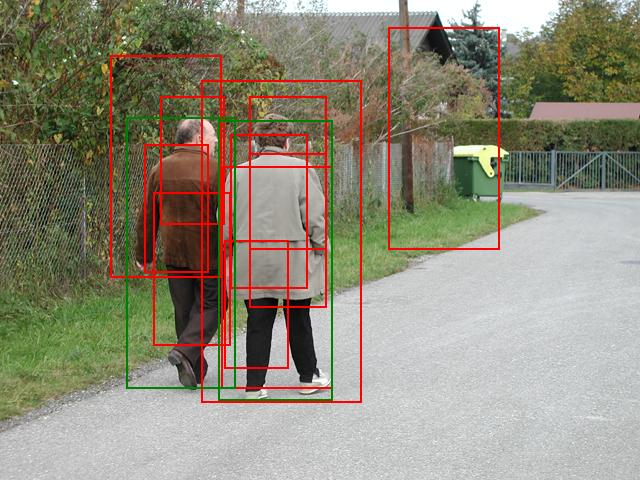

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_325.png (Ảnh thứ 43/288): Precision=0.0909, Recall=0.5000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.2250, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


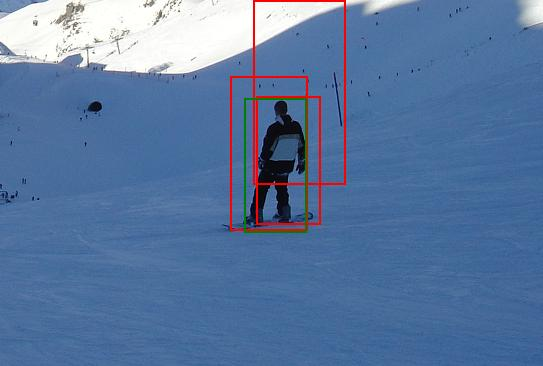

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001684.png (Ảnh thứ 44/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.3500, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


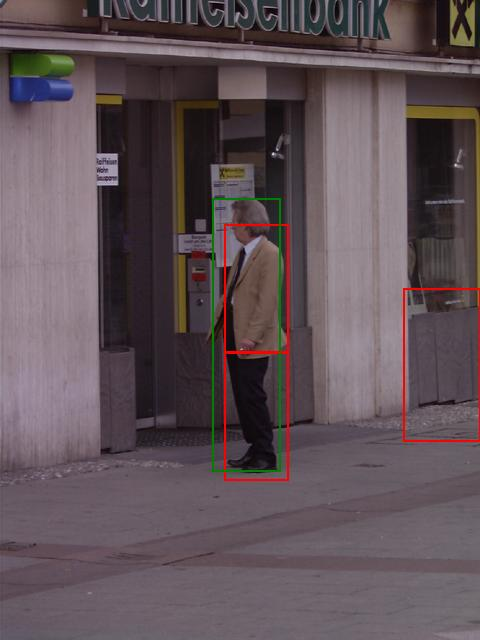

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_012.png (Ảnh thứ 45/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


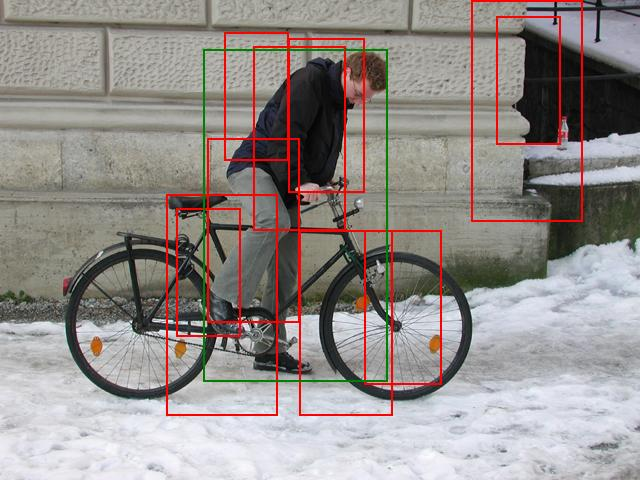

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_101.png (Ảnh thứ 46/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


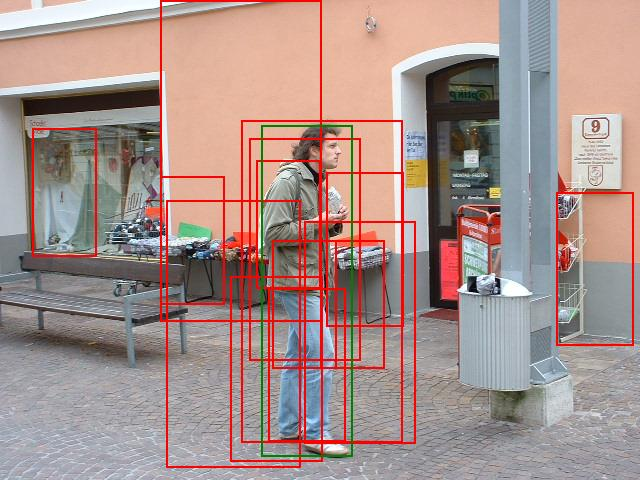

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_065.png (Ảnh thứ 47/288): Precision=0.0714, Recall=1.0000, F1=0.1333, Accuracy=0.0714, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


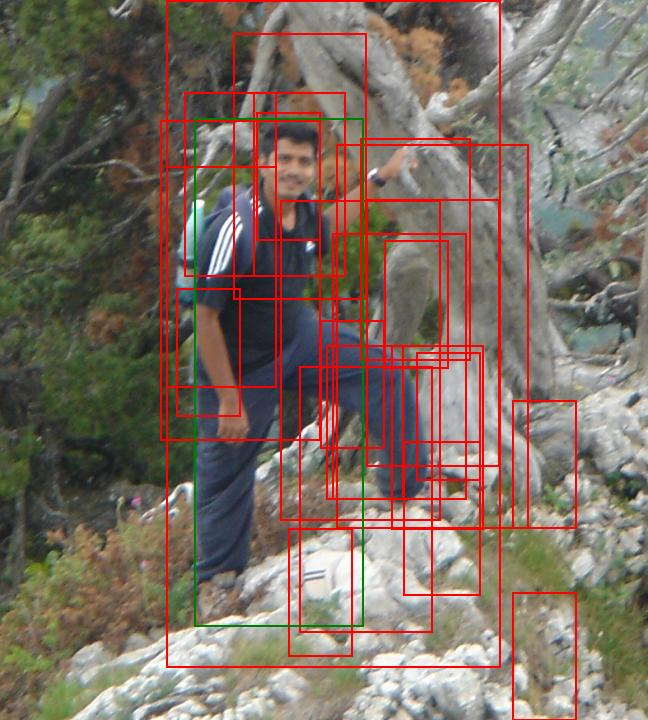

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000013.png (Ảnh thứ 48/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


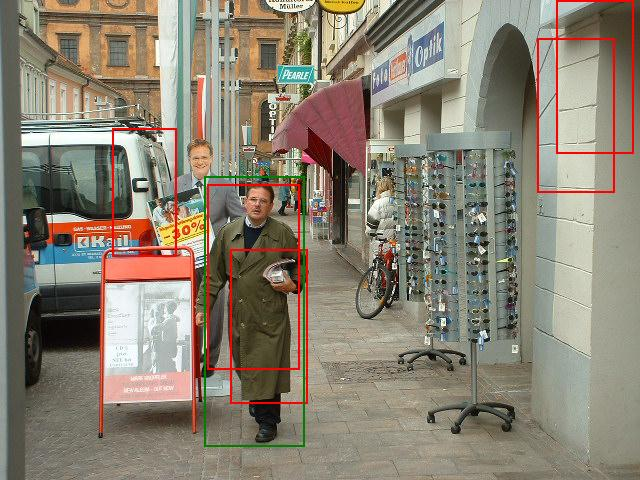

AP@IoU=0.50: 0.2000
AP@IoU=0.55: 0.2000
AP@IoU=0.60: 0.2000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_149.png (Ảnh thứ 49/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.0600, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


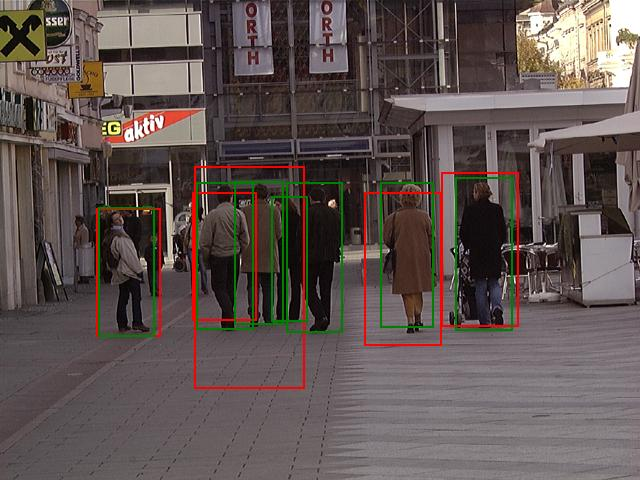

AP@IoU=0.50: 0.5071
AP@IoU=0.55: 0.5071
AP@IoU=0.60: 0.3714
AP@IoU=0.65: 0.3714
AP@IoU=0.70: 0.3714
AP@IoU=0.75: 0.2857
AP@IoU=0.80: 0.0714
AP@IoU=0.85: 0.0714
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5714
Recall@IoU=0.55: 0.5714
Recall@IoU=0.60: 0.4286
Recall@IoU=0.65: 0.4286
Recall@IoU=0.70: 0.4286
Recall@IoU=0.75: 0.2857
Recall@IoU=0.80: 0.1429
Recall@IoU=0.85: 0.1429
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_132.png (Ảnh thứ 50/288): Precision=0.8000, Recall=0.5714, F1=0.6667, Accuracy=0.5000, mAP@0.5:0.95=0.2557, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


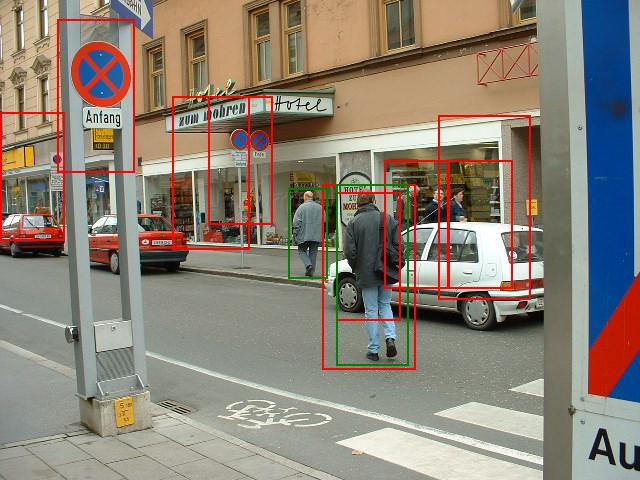

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1250
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.1250
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_188.png (Ảnh thứ 51/288): Precision=0.1111, Recall=0.5000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.0875, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


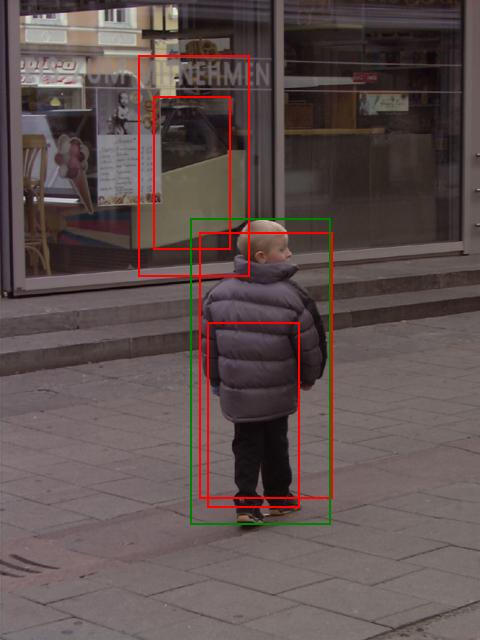

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_013.png (Ảnh thứ 52/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


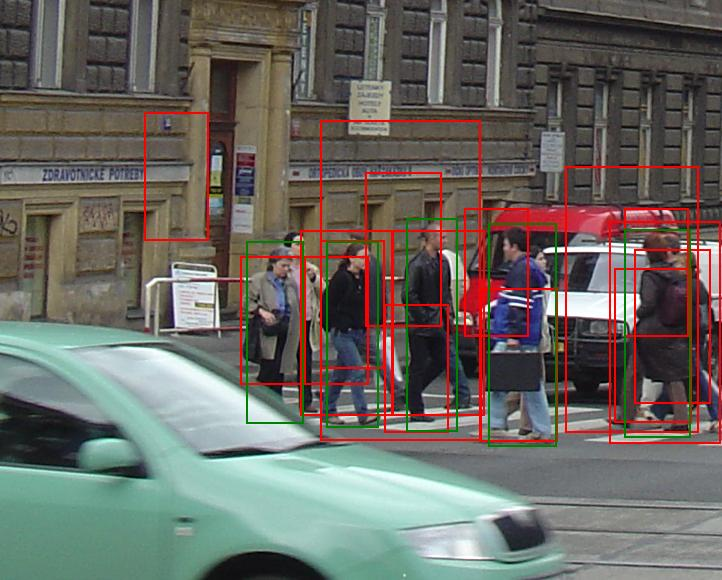

AP@IoU=0.50: 0.8369
AP@IoU=0.55: 0.6615
AP@IoU=0.60: 0.1628
AP@IoU=0.65: 0.0250
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.8000
Recall@IoU=0.60: 0.6000
Recall@IoU=0.65: 0.2000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001593.png (Ảnh thứ 53/288): Precision=0.3125, Recall=1.0000, F1=0.4762, Accuracy=0.3125, mAP@0.5:0.95=0.1686, mAR@0.5:0.95=0.2600
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


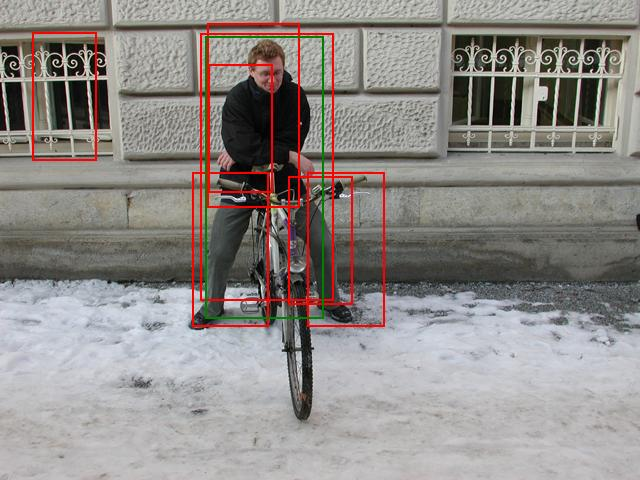

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_065.png (Ảnh thứ 54/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


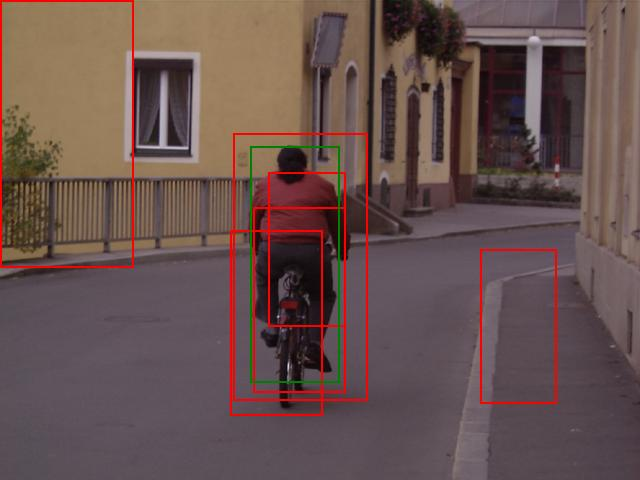

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_140.png (Ảnh thứ 55/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


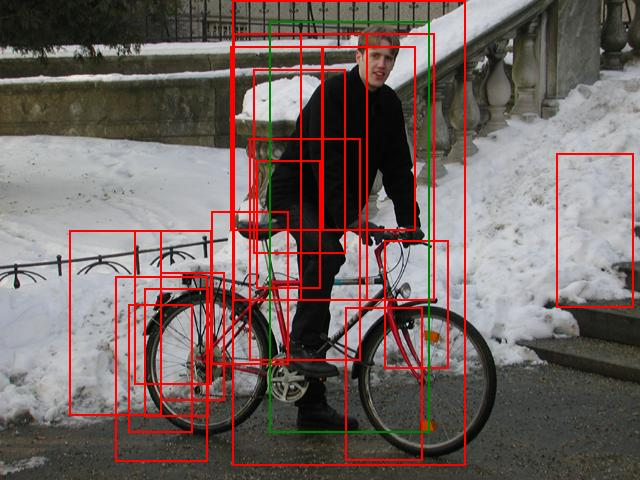

AP@IoU=0.50: 0.2000
AP@IoU=0.55: 0.0769
AP@IoU=0.60: 0.0769
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_087.png (Ảnh thứ 56/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.0354, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


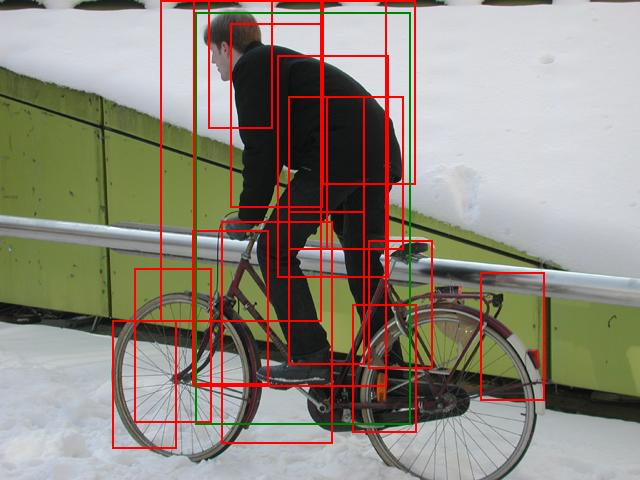

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.1667
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_098.png (Ảnh thứ 57/288): Precision=0.0625, Recall=1.0000, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


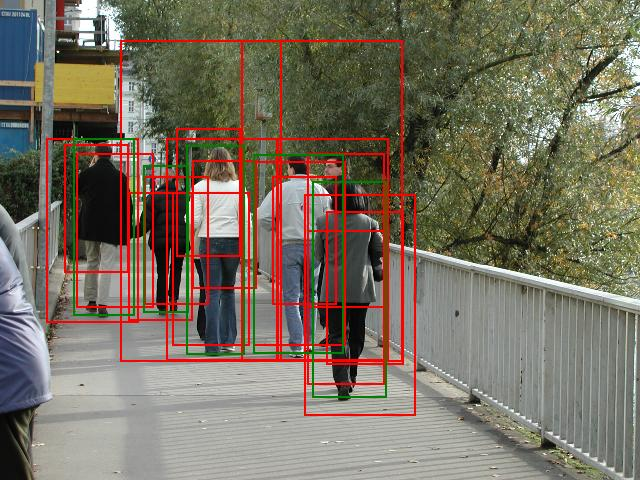

AP@IoU=0.50: 0.6636
AP@IoU=0.55: 0.6636
AP@IoU=0.60: 0.5215
AP@IoU=0.65: 0.2775
AP@IoU=0.70: 0.2000
AP@IoU=0.75: 0.2000
AP@IoU=0.80: 0.2000
AP@IoU=0.85: 0.2000
AP@IoU=0.90: 0.2000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.8000
Recall@IoU=0.65: 0.6000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.2000
Recall@IoU=0.80: 0.2000
Recall@IoU=0.85: 0.2000
Recall@IoU=0.90: 0.2000
Recall@IoU=0.95: 0.0000
Ảnh person_337.png (Ảnh thứ 58/288): Precision=0.2778, Recall=1.0000, F1=0.4348, Accuracy=0.2778, mAP@0.5:0.95=0.3126, mAR@0.5:0.95=0.4400
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


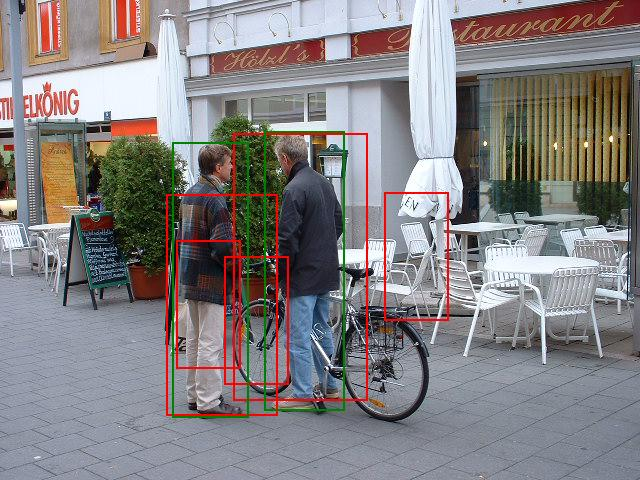

AP@IoU=0.50: 0.7500
AP@IoU=0.55: 0.7500
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_035.png (Ảnh thứ 59/288): Precision=0.4000, Recall=1.0000, F1=0.5714, Accuracy=0.4000, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


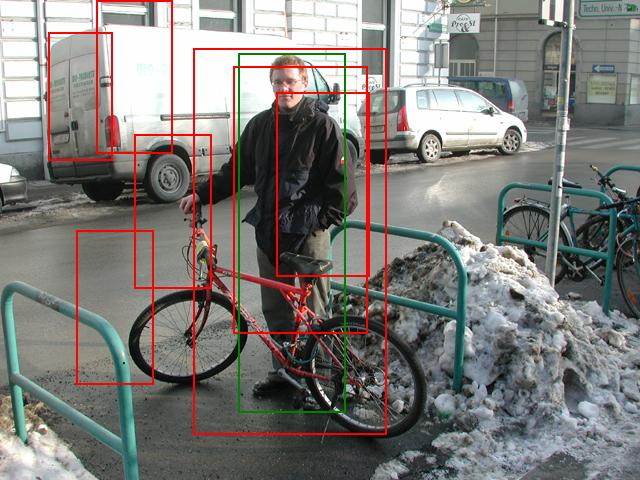

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_070.png (Ảnh thứ 60/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


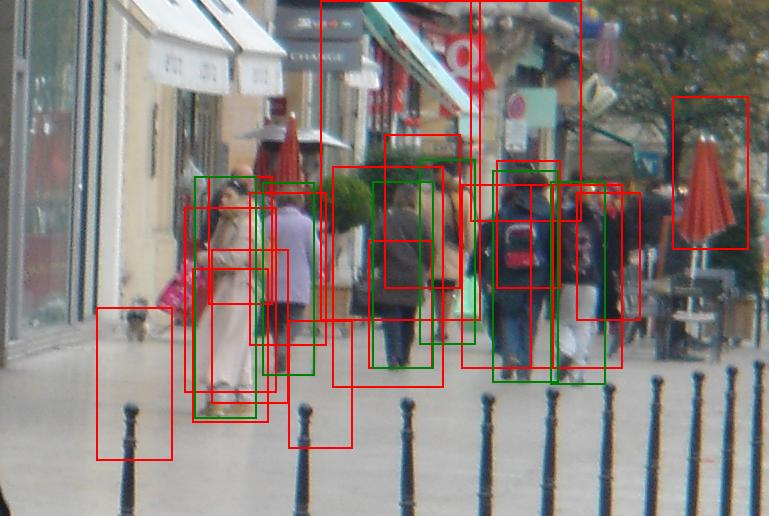

AP@IoU=0.50: 0.6944
AP@IoU=0.55: 0.6944
AP@IoU=0.60: 0.0278
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8333
Recall@IoU=0.55: 0.8333
Recall@IoU=0.60: 0.1667
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001521.png (Ảnh thứ 61/288): Precision=0.2941, Recall=0.8333, F1=0.4348, Accuracy=0.2778, mAP@0.5:0.95=0.1417, mAR@0.5:0.95=0.1833
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


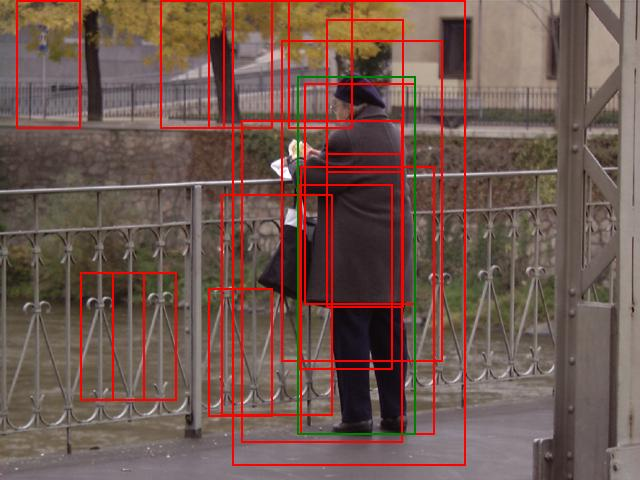

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_056.png (Ảnh thứ 62/288): Precision=0.0625, Recall=1.0000, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


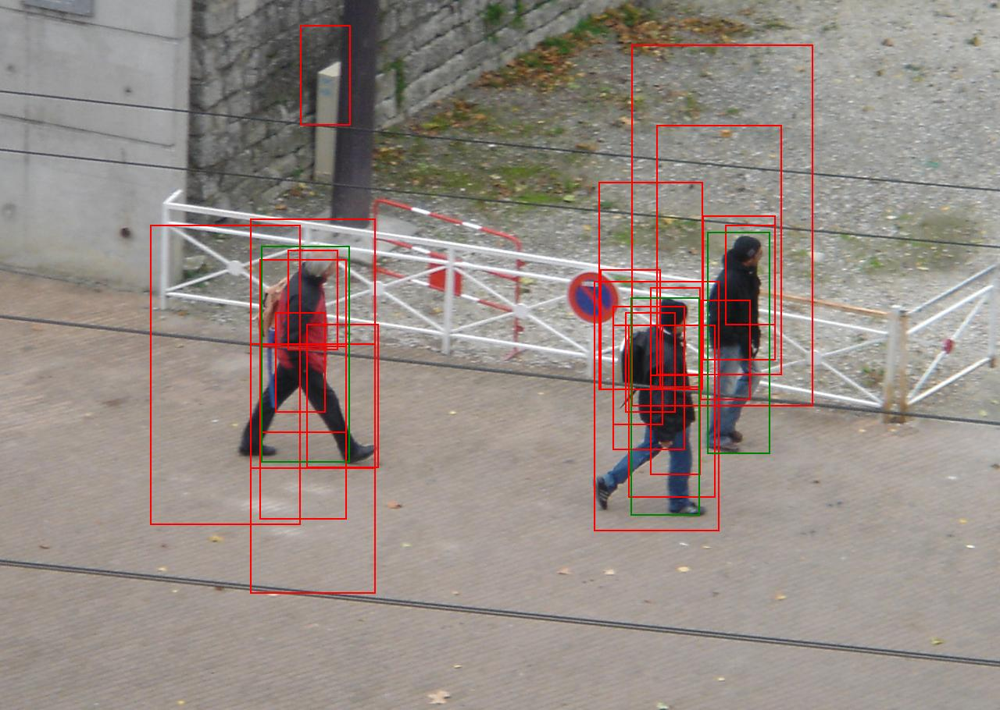

AP@IoU=0.50: 0.2018
AP@IoU=0.55: 0.2018
AP@IoU=0.60: 0.2018
AP@IoU=0.65: 0.1462
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001633.png (Ảnh thứ 63/288): Precision=0.0870, Recall=0.6667, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.0974, mAR@0.5:0.95=0.3333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


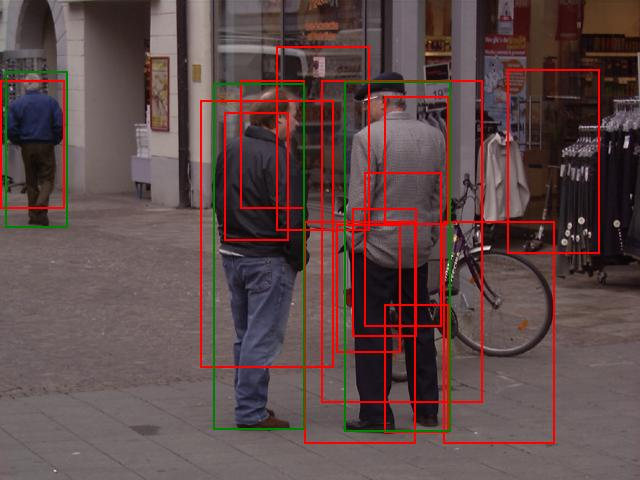

AP@IoU=0.50: 0.8056
AP@IoU=0.55: 0.8056
AP@IoU=0.60: 0.5556
AP@IoU=0.65: 0.1111
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_012.png (Ảnh thứ 64/288): Precision=0.2143, Recall=1.0000, F1=0.3529, Accuracy=0.2143, mAP@0.5:0.95=0.2389, mAR@0.5:0.95=0.3333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


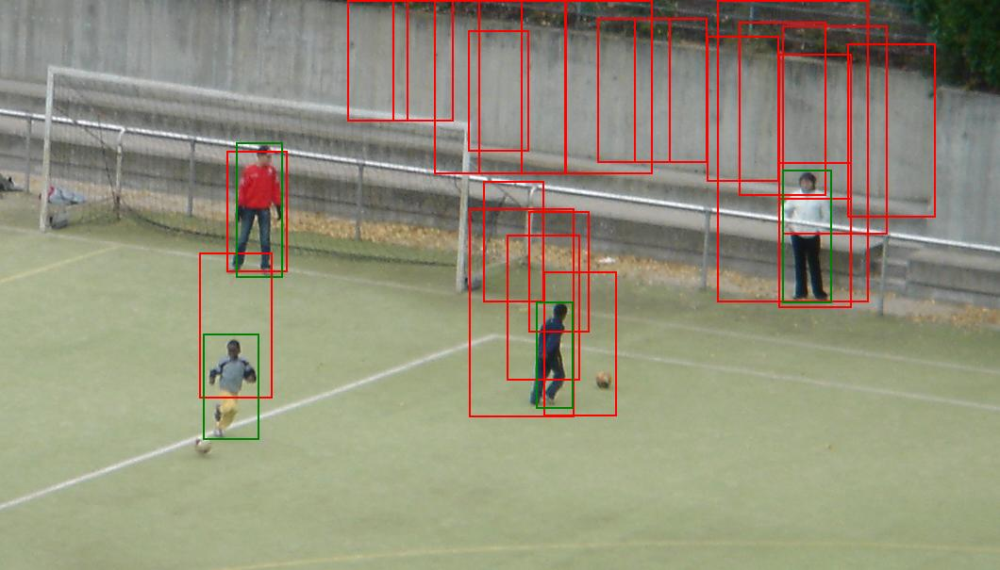

AP@IoU=0.50: 0.2917
AP@IoU=0.55: 0.2917
AP@IoU=0.60: 0.2917
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.2500
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001501.png (Ảnh thứ 65/288): Precision=0.0909, Recall=0.5000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.1375, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


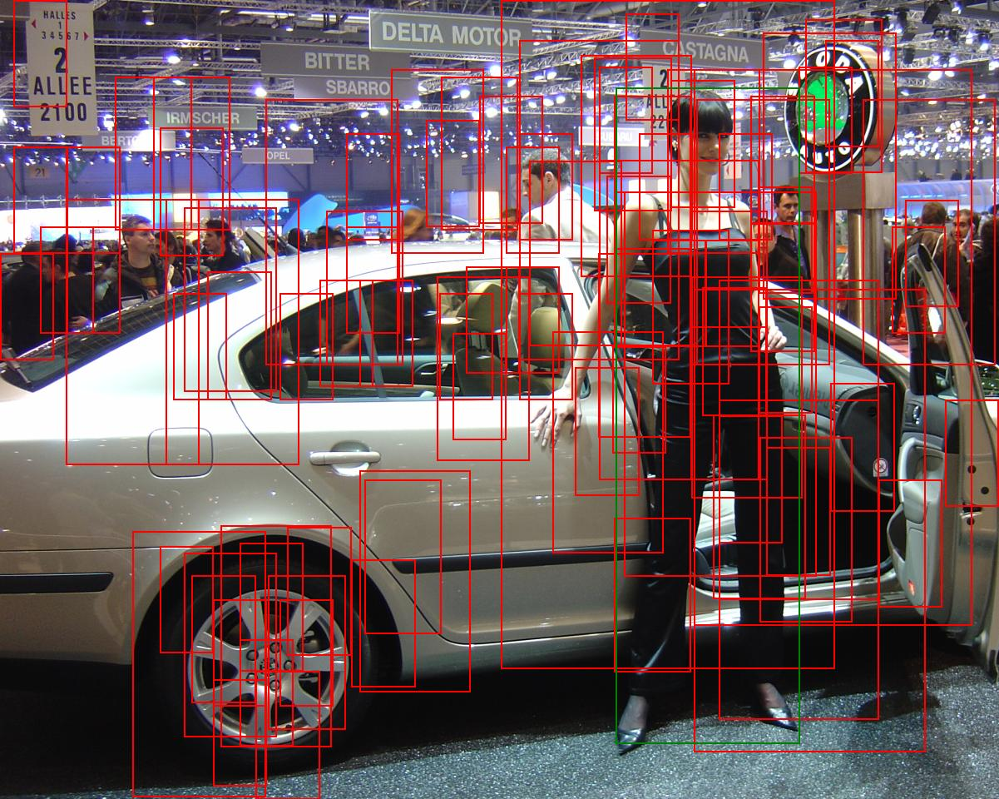

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001706.png (Ảnh thứ 66/288): Precision=0.0100, Recall=1.0000, F1=0.0198, Accuracy=0.0100, mAP@0.5:0.95=0.0500, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


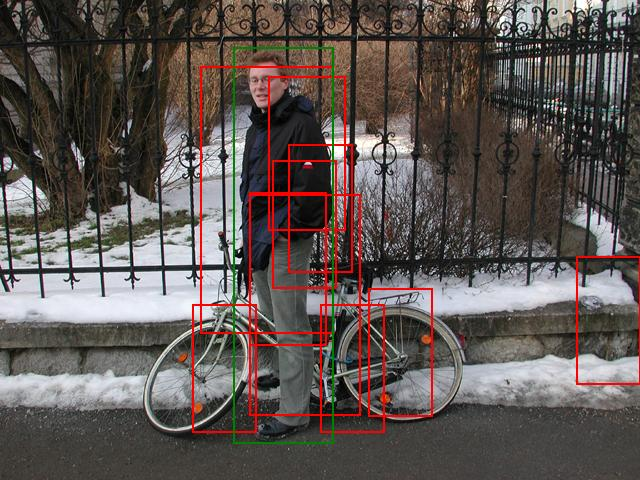

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_073.png (Ảnh thứ 67/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.0333, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


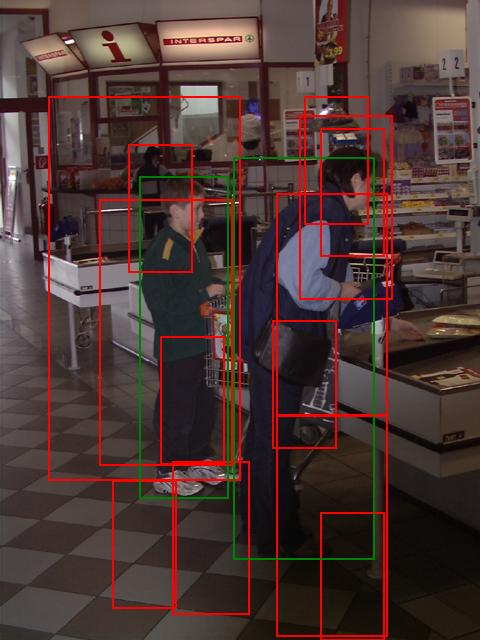

AP@IoU=0.50: 0.0714
AP@IoU=0.55: 0.0714
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_085.png (Ảnh thứ 68/288): Precision=0.0769, Recall=0.5000, F1=0.1333, Accuracy=0.0714, mAP@0.5:0.95=0.0143, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


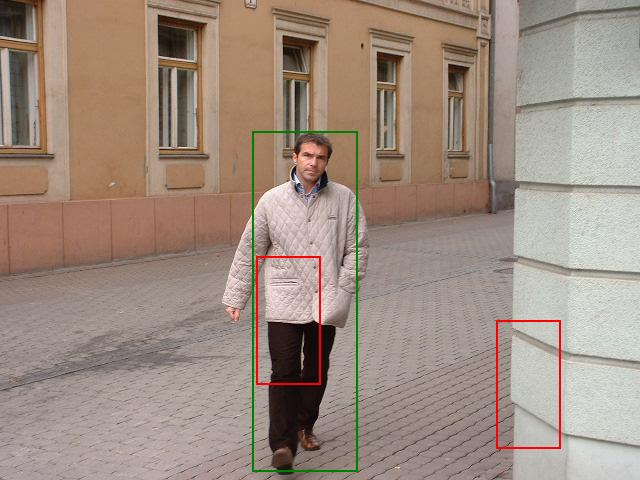

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_064.png (Ảnh thứ 69/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


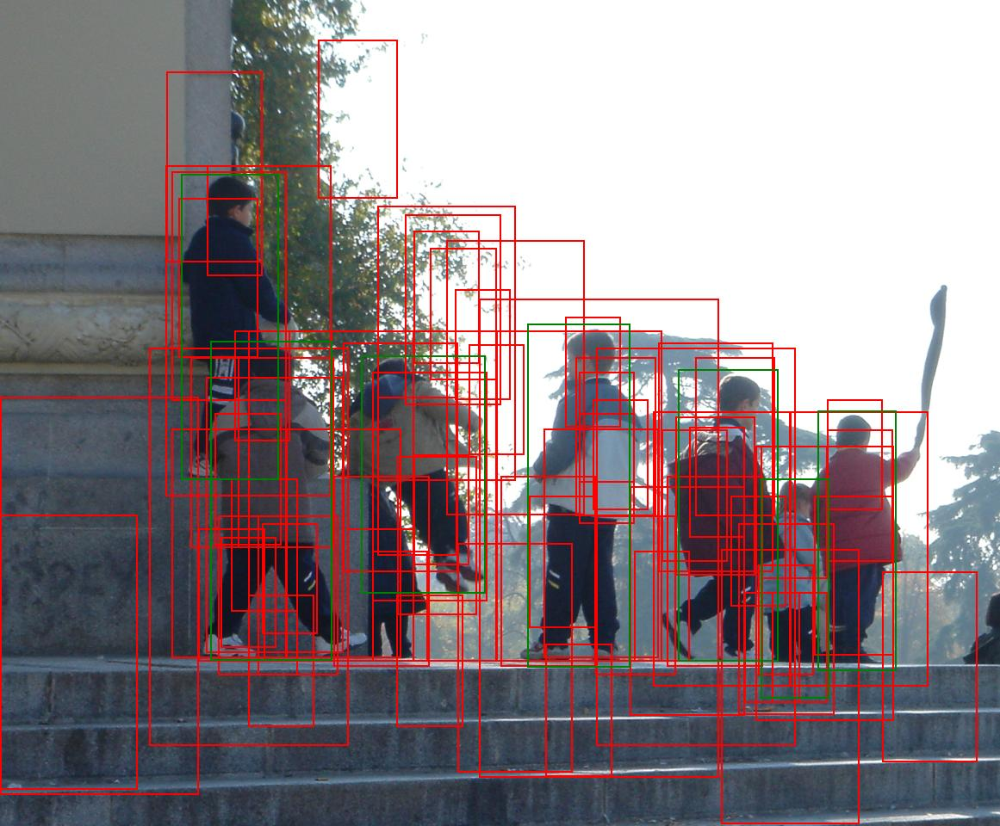

AP@IoU=0.50: 0.5281
AP@IoU=0.55: 0.4282
AP@IoU=0.60: 0.1282
AP@IoU=0.65: 0.0848
AP@IoU=0.70: 0.0446
AP@IoU=0.75: 0.0446
AP@IoU=0.80: 0.0045
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5714
Recall@IoU=0.65: 0.4286
Recall@IoU=0.70: 0.2857
Recall@IoU=0.75: 0.2857
Recall@IoU=0.80: 0.1429
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001676.png (Ảnh thứ 70/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.1263, mAR@0.5:0.95=0.3714
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


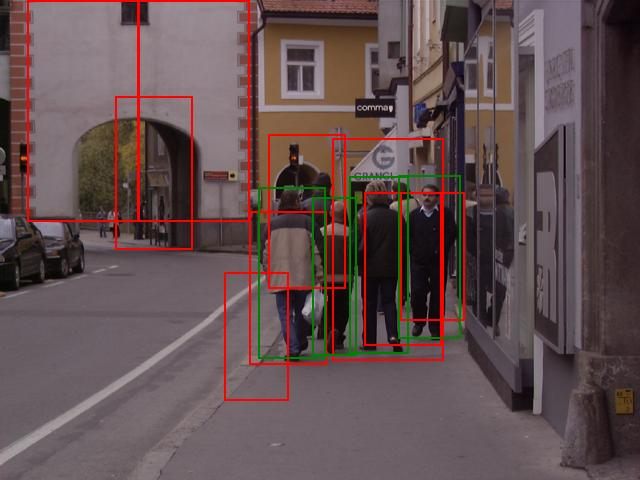

AP@IoU=0.50: 0.1548
AP@IoU=0.55: 0.1548
AP@IoU=0.60: 0.1548
AP@IoU=0.65: 0.1548
AP@IoU=0.70: 0.1548
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_194.png (Ảnh thứ 71/288): Precision=0.2222, Recall=0.5000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.0774, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


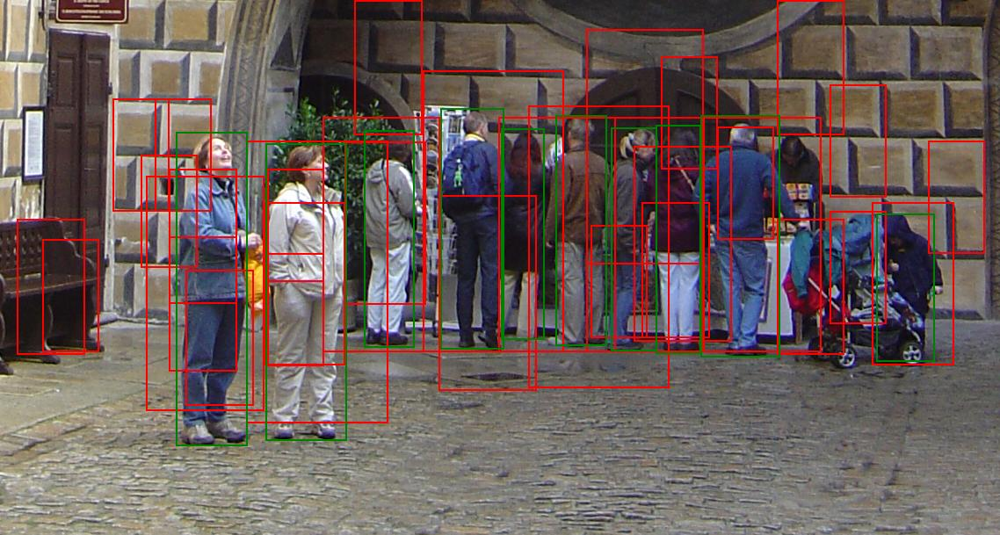

AP@IoU=0.50: 0.2372
AP@IoU=0.55: 0.1074
AP@IoU=0.60: 0.1074
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4545
Recall@IoU=0.55: 0.1818
Recall@IoU=0.60: 0.1818
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001607.png (Ảnh thứ 72/288): Precision=0.1471, Recall=0.4545, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.0452, mAR@0.5:0.95=0.0818
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


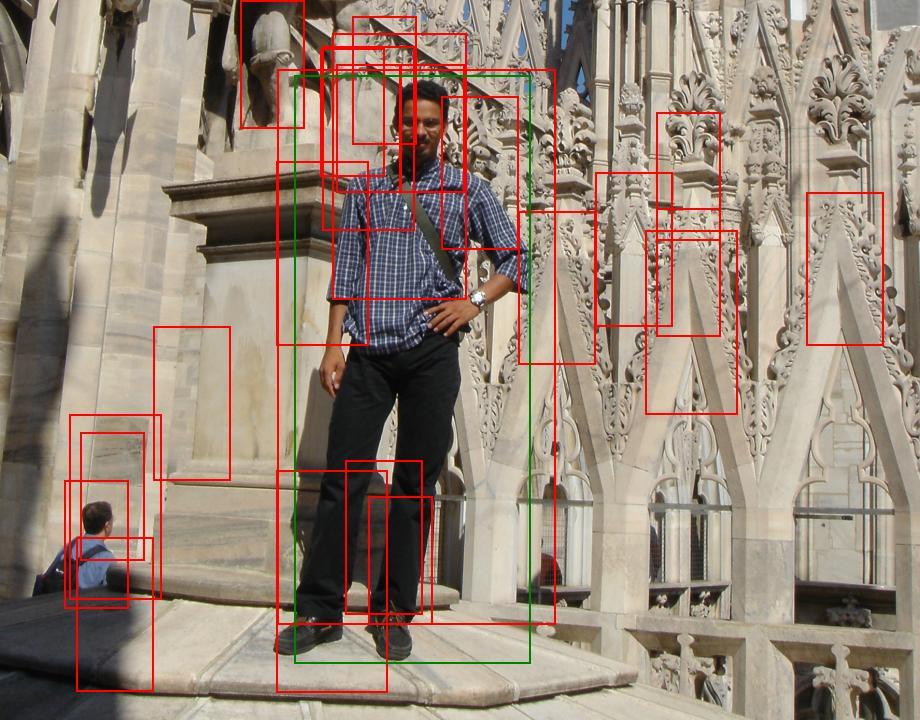

AP@IoU=0.50: 0.0667
AP@IoU=0.55: 0.0667
AP@IoU=0.60: 0.0667
AP@IoU=0.65: 0.0667
AP@IoU=0.70: 0.0667
AP@IoU=0.75: 0.0667
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000025.png (Ảnh thứ 73/288): Precision=0.0417, Recall=1.0000, F1=0.0800, Accuracy=0.0417, mAP@0.5:0.95=0.0400, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


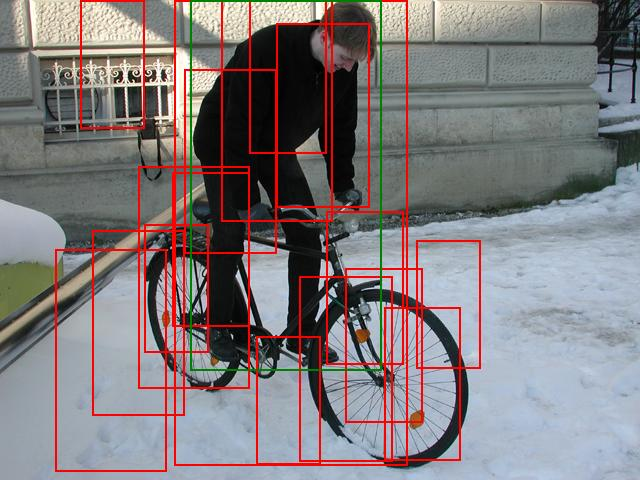

AP@IoU=0.50: 0.0714
AP@IoU=0.55: 0.0714
AP@IoU=0.60: 0.0714
AP@IoU=0.65: 0.0714
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_112.png (Ảnh thứ 74/288): Precision=0.0588, Recall=1.0000, F1=0.1111, Accuracy=0.0588, mAP@0.5:0.95=0.0286, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


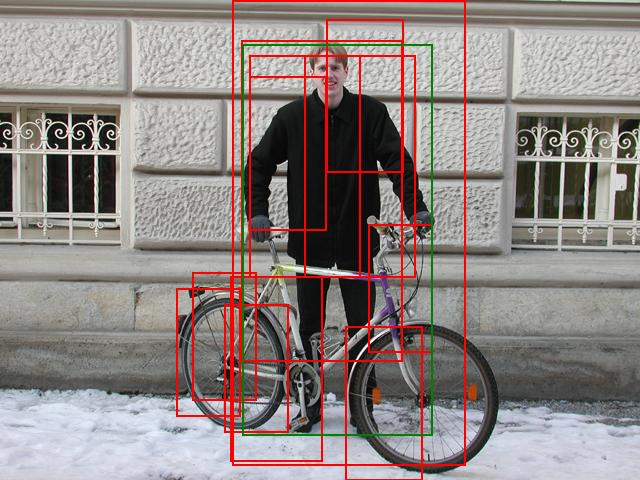

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_063.png (Ảnh thứ 75/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


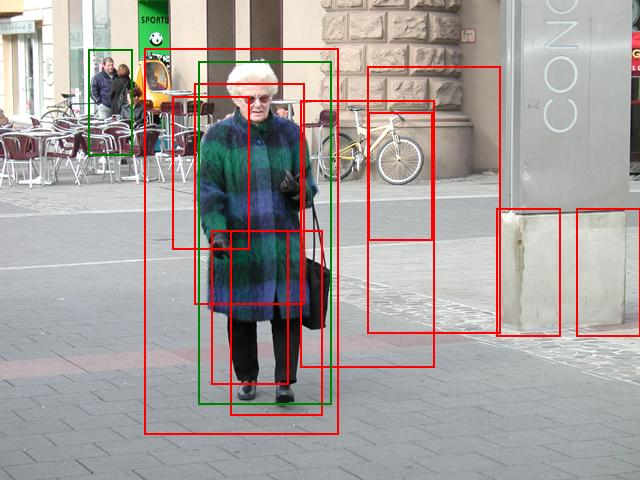

AP@IoU=0.50: 0.1250
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.1250
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_006.png (Ảnh thứ 76/288): Precision=0.1000, Recall=0.5000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.0375, mAR@0.5:0.95=0.1500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


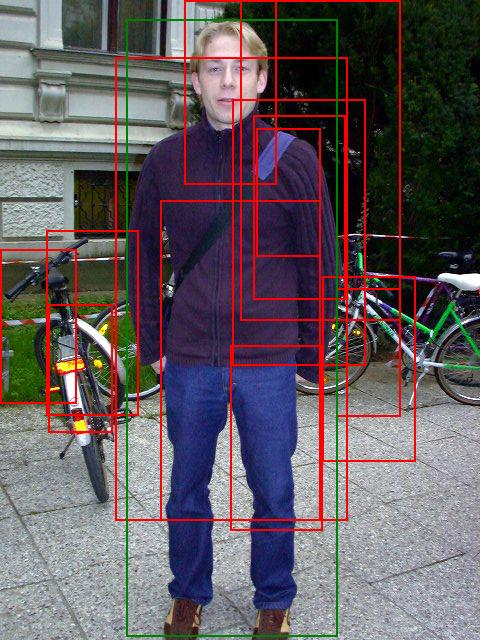

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_004.png (Ảnh thứ 77/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


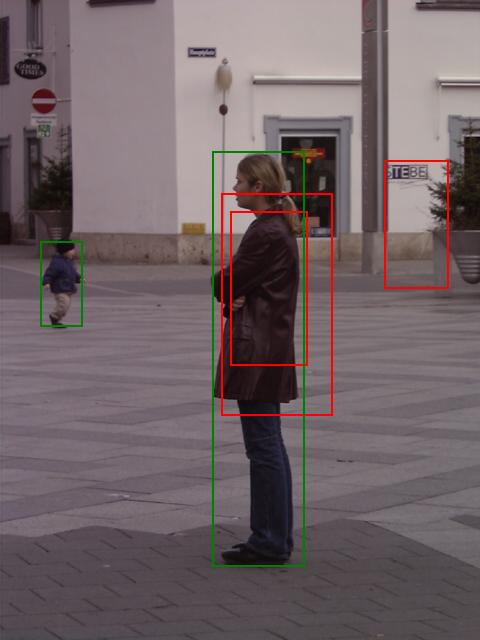

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_010.png (Ảnh thứ 78/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


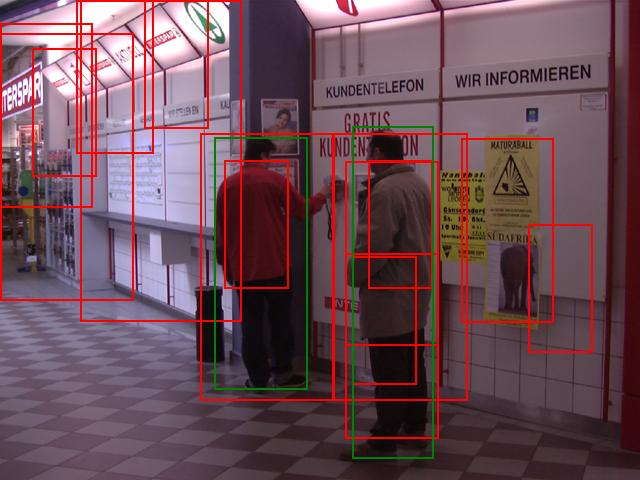

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_216.png (Ảnh thứ 79/288): Precision=0.1333, Recall=1.0000, F1=0.2353, Accuracy=0.1333, mAP@0.5:0.95=0.2333, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


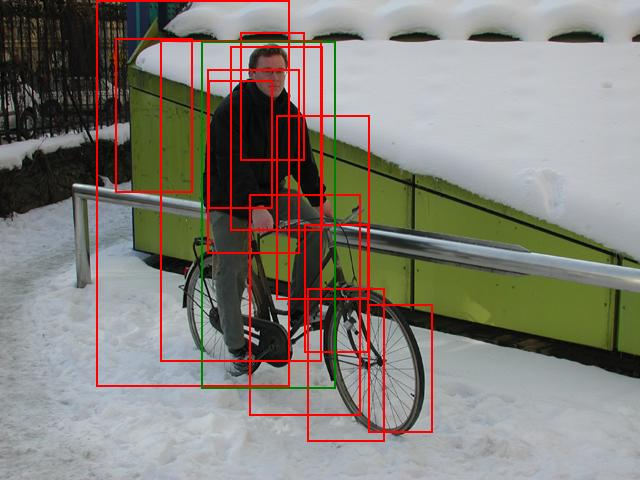

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_096.png (Ảnh thứ 80/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


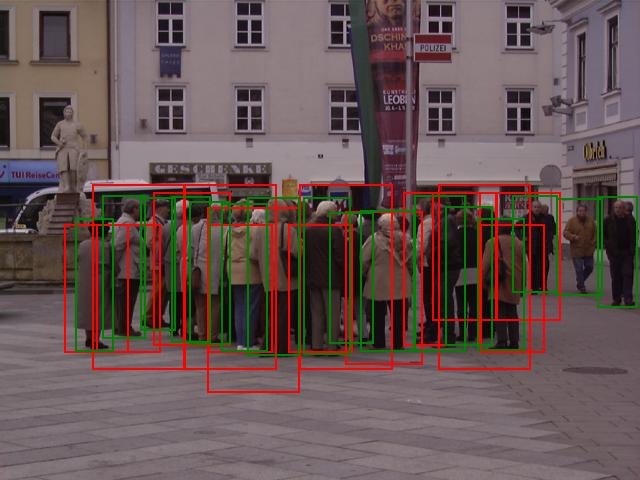

AP@IoU=0.50: 0.3253
AP@IoU=0.55: 0.1860
AP@IoU=0.60: 0.1289
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4348
Recall@IoU=0.55: 0.3043
Recall@IoU=0.60: 0.2174
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_200.png (Ảnh thứ 81/288): Precision=0.6667, Recall=0.4348, F1=0.5263, Accuracy=0.3571, mAP@0.5:0.95=0.0640, mAR@0.5:0.95=0.0957
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


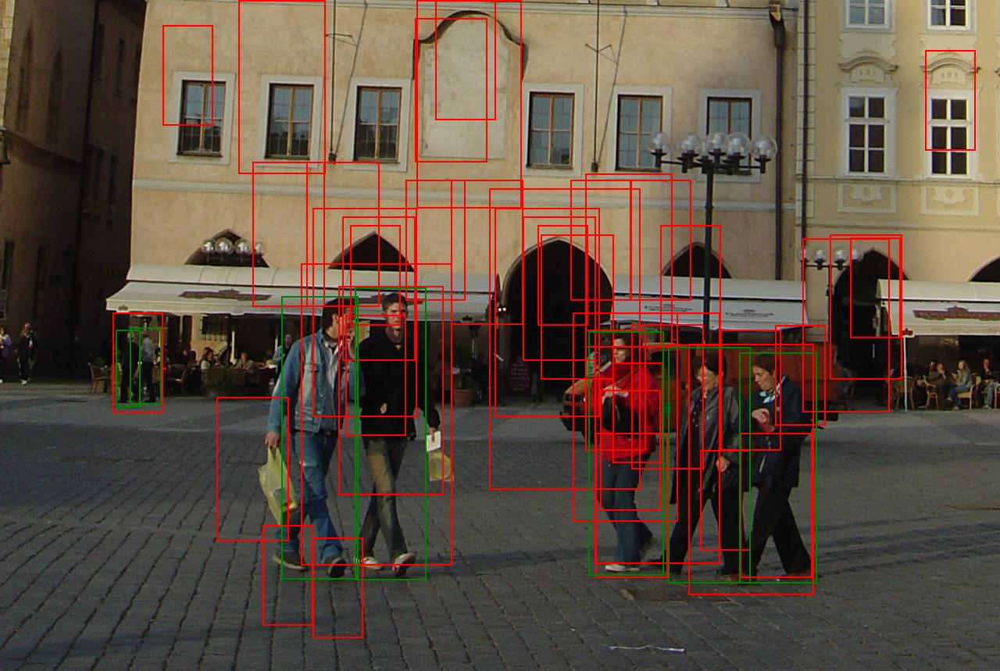

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.0667
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4286
Recall@IoU=0.55: 0.2857
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001719.png (Ảnh thứ 82/288): Precision=0.0682, Recall=0.4286, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.0233, mAR@0.5:0.95=0.0714
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


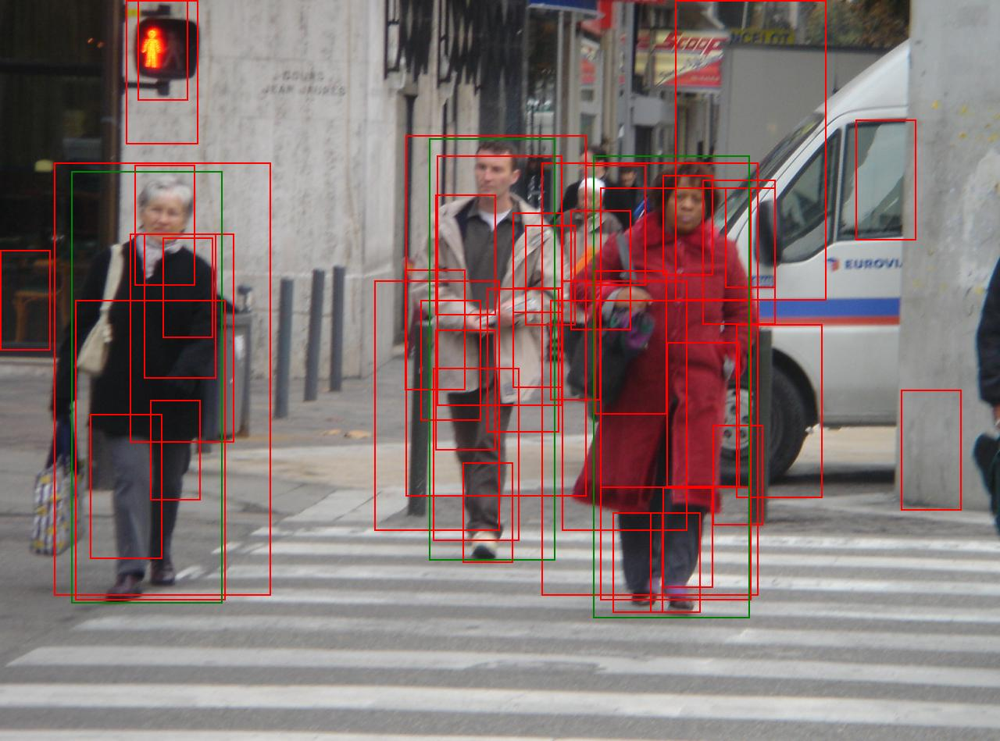

AP@IoU=0.50: 0.4983
AP@IoU=0.55: 0.4662
AP@IoU=0.60: 0.4662
AP@IoU=0.65: 0.4074
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001639.png (Ảnh thứ 83/288): Precision=0.0682, Recall=1.0000, F1=0.1277, Accuracy=0.0682, mAP@0.5:0.95=0.1838, mAR@0.5:0.95=0.3667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


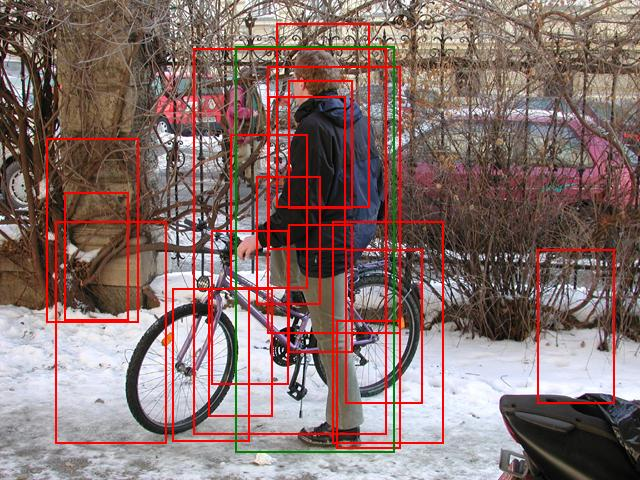

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_114.png (Ảnh thứ 84/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


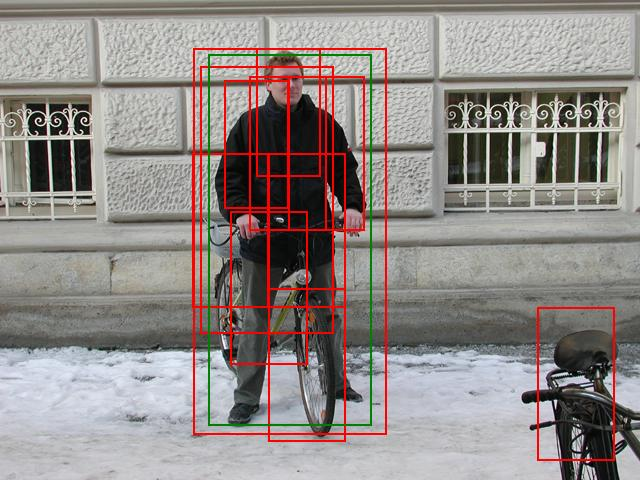

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_054.png (Ảnh thứ 85/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


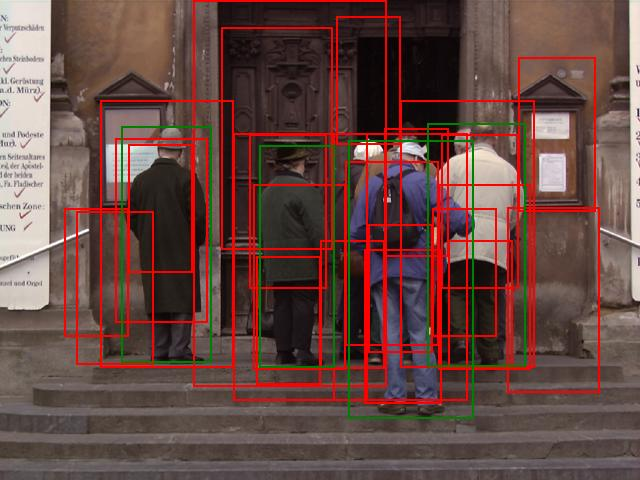

AP@IoU=0.50: 0.8875
AP@IoU=0.55: 0.7500
AP@IoU=0.60: 0.7500
AP@IoU=0.65: 0.7500
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_190.png (Ảnh thứ 86/288): Precision=0.1600, Recall=1.0000, F1=0.2759, Accuracy=0.1600, mAP@0.5:0.95=0.3888, mAR@0.5:0.95=0.4750
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


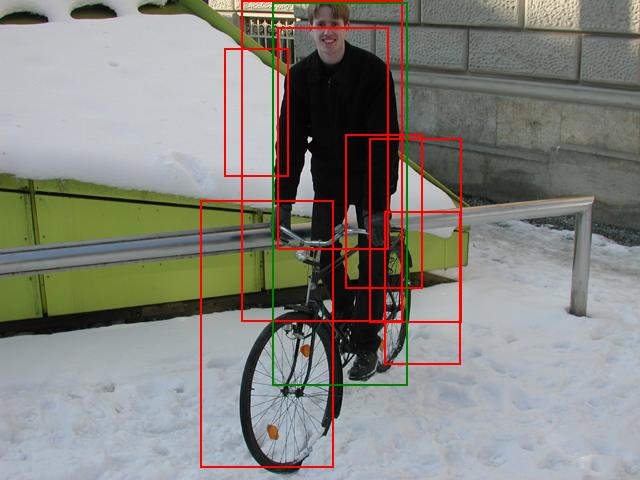

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_110.png (Ảnh thứ 87/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.1333, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


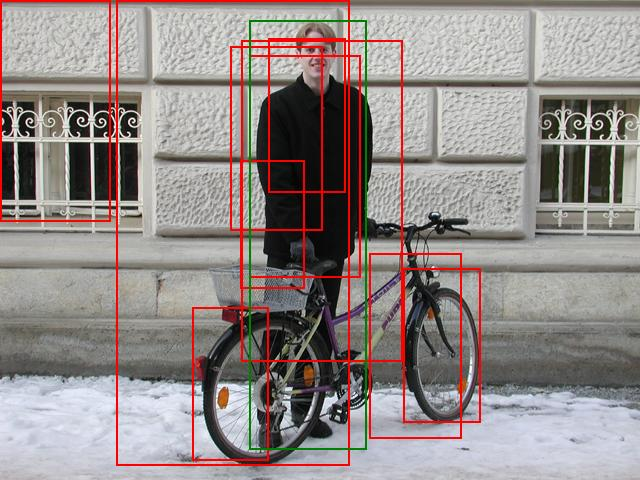

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_053.png (Ảnh thứ 88/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.0333, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


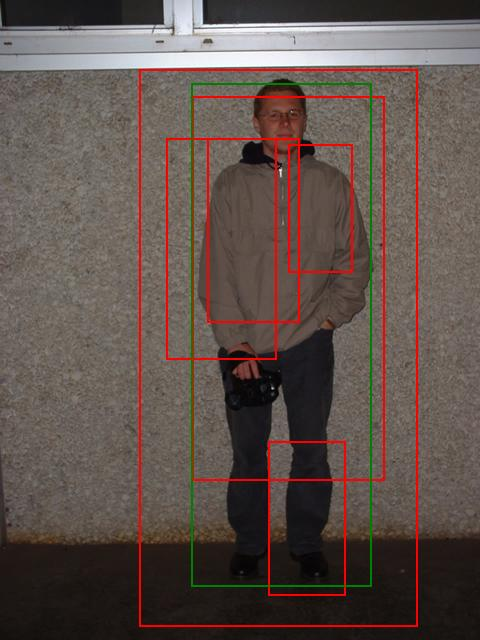

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_036.png (Ảnh thứ 89/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


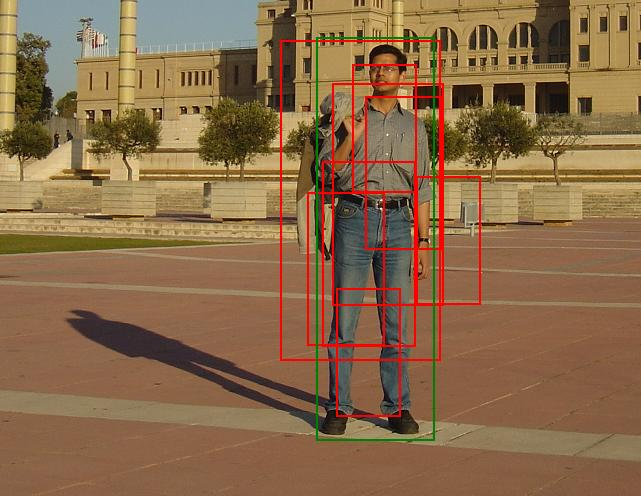

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000003.png (Ảnh thứ 90/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


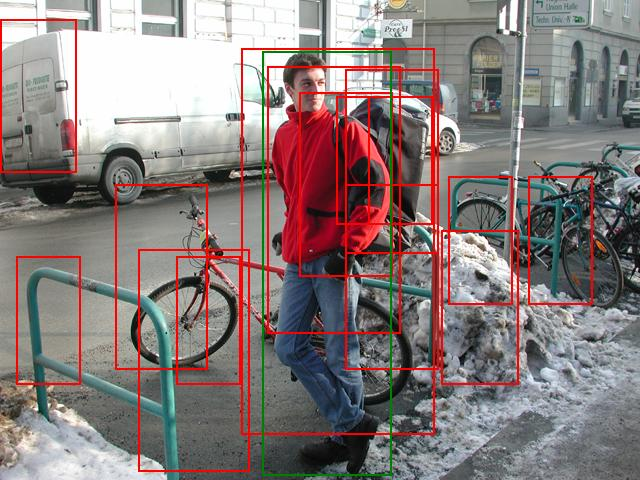

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_071.png (Ảnh thứ 91/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


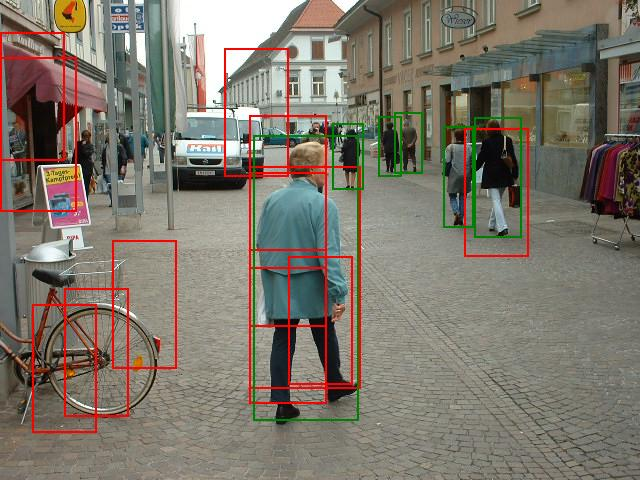

AP@IoU=0.50: 0.1944
AP@IoU=0.55: 0.1944
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.3333
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.1667
Recall@IoU=0.65: 0.1667
Recall@IoU=0.70: 0.1667
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_028.png (Ảnh thứ 92/288): Precision=0.1667, Recall=0.3333, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.0889, mAR@0.5:0.95=0.1167
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


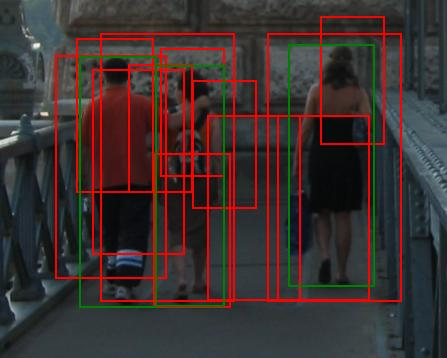

AP@IoU=0.50: 0.9167
AP@IoU=0.55: 0.9167
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000604.png (Ảnh thứ 93/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


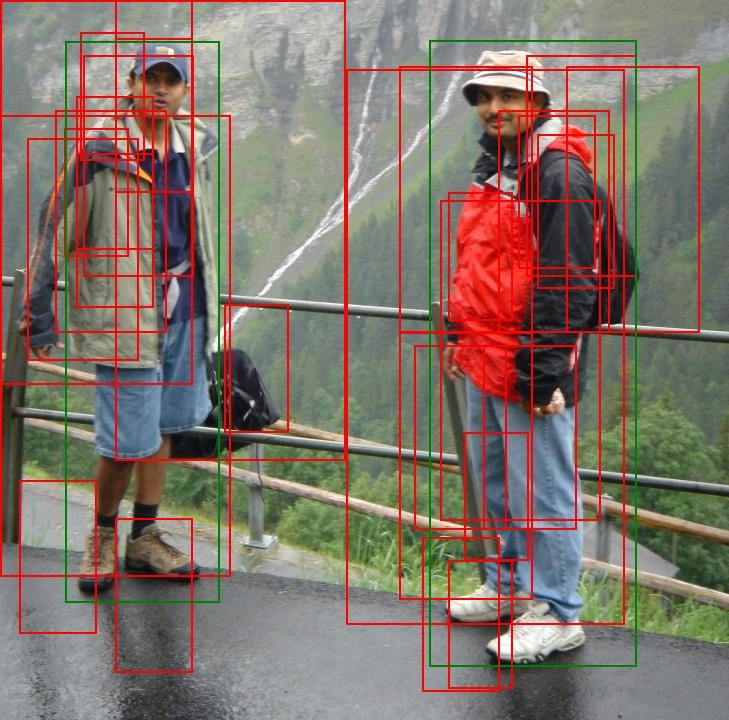

AP@IoU=0.50: 0.5667
AP@IoU=0.55: 0.5667
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000027.png (Ảnh thứ 94/288): Precision=0.0690, Recall=1.0000, F1=0.1290, Accuracy=0.0690, mAP@0.5:0.95=0.1633, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


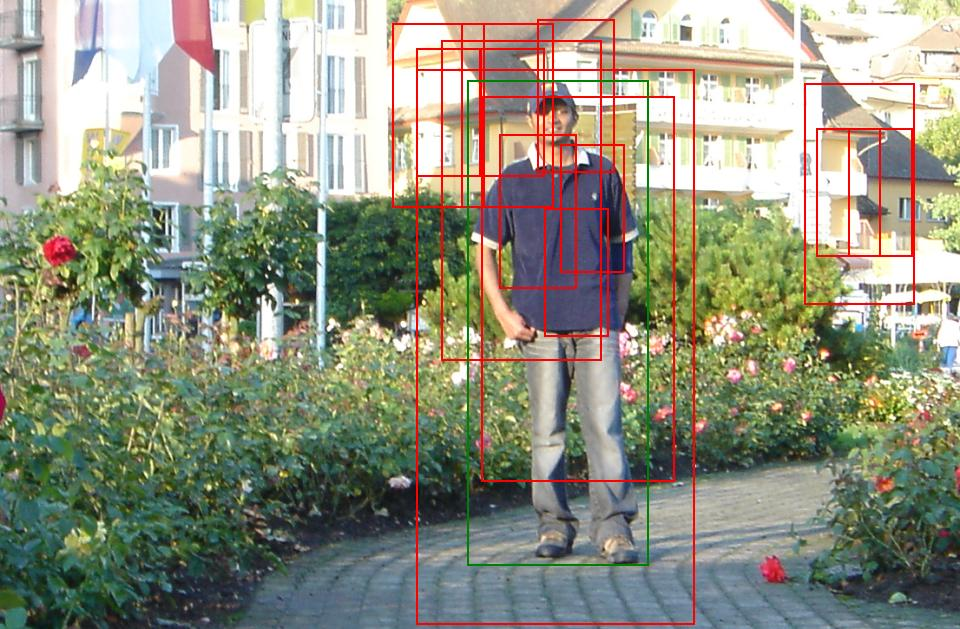

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000023.png (Ảnh thứ 95/288): Precision=0.0714, Recall=1.0000, F1=0.1333, Accuracy=0.0714, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


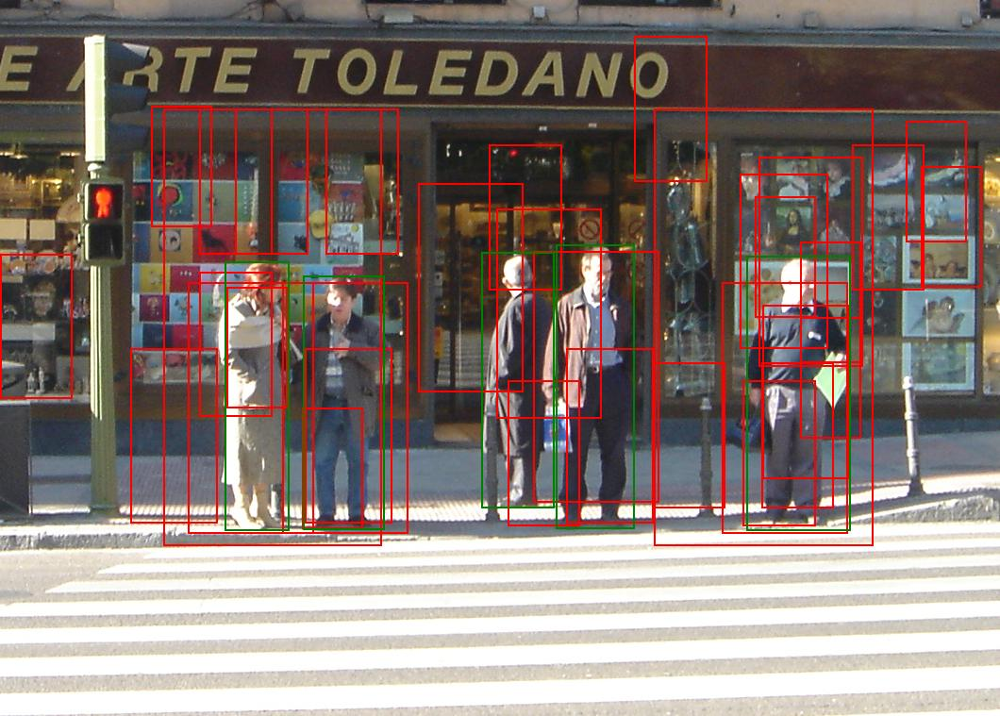

AP@IoU=0.50: 0.1556
AP@IoU=0.55: 0.1556
AP@IoU=0.60: 0.1333
AP@IoU=0.65: 0.0167
AP@IoU=0.70: 0.0167
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6000
Recall@IoU=0.55: 0.6000
Recall@IoU=0.60: 0.4000
Recall@IoU=0.65: 0.2000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001573.png (Ảnh thứ 96/288): Precision=0.0882, Recall=0.6000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.0478, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


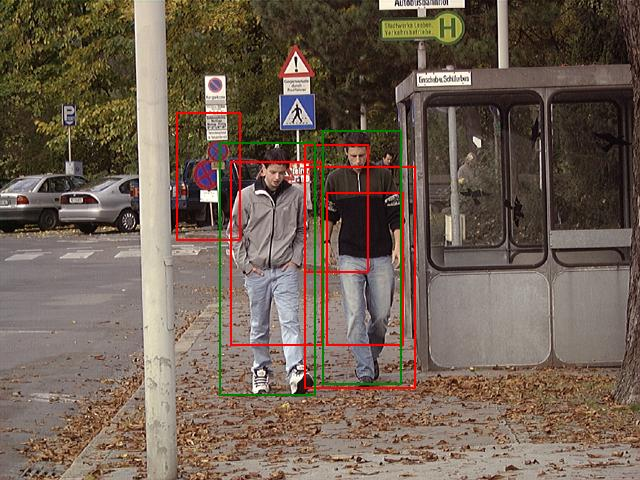

AP@IoU=0.50: 0.4500
AP@IoU=0.55: 0.4500
AP@IoU=0.60: 0.3667
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_136.png (Ảnh thứ 97/288): Precision=0.4000, Recall=1.0000, F1=0.5714, Accuracy=0.4000, mAP@0.5:0.95=0.1267, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


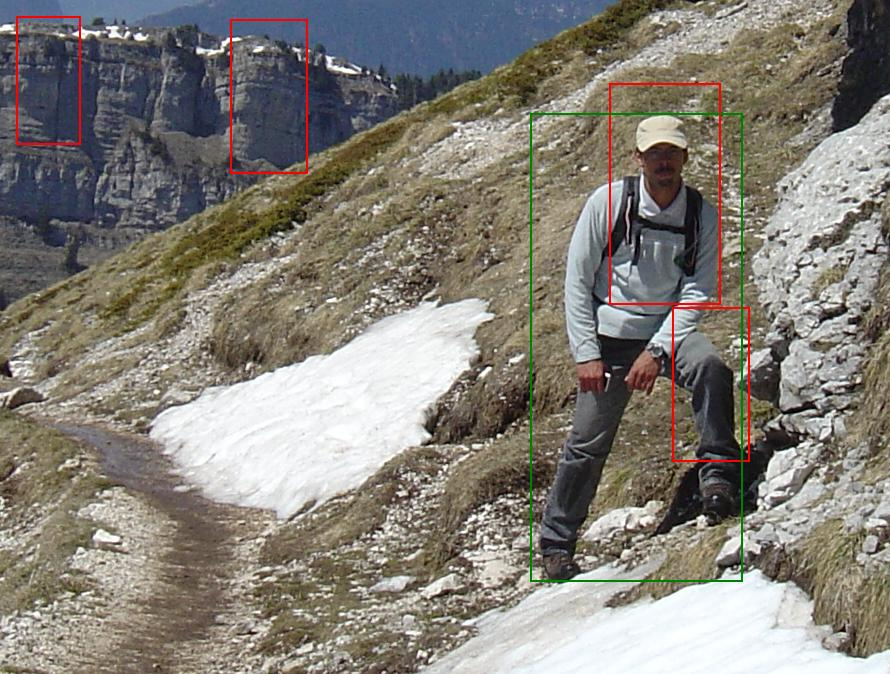

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000007.png (Ảnh thứ 98/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


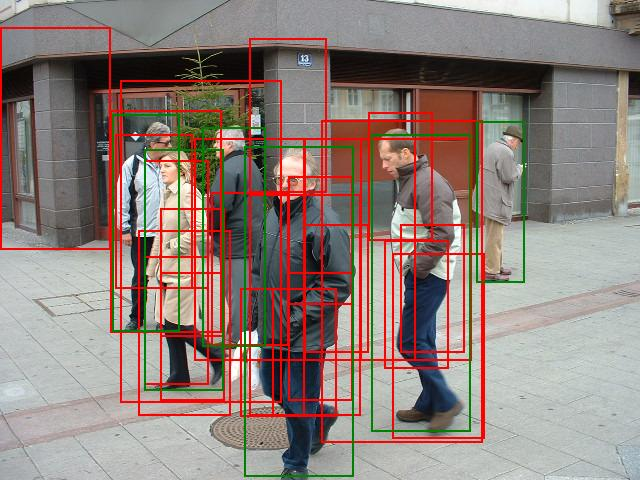

AP@IoU=0.50: 0.3583
AP@IoU=0.55: 0.1472
AP@IoU=0.60: 0.0972
AP@IoU=0.65: 0.0278
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8333
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.1667
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_303.png (Ảnh thứ 99/288): Precision=0.2000, Recall=0.8333, F1=0.3226, Accuracy=0.1923, mAP@0.5:0.95=0.0631, mAR@0.5:0.95=0.1833
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


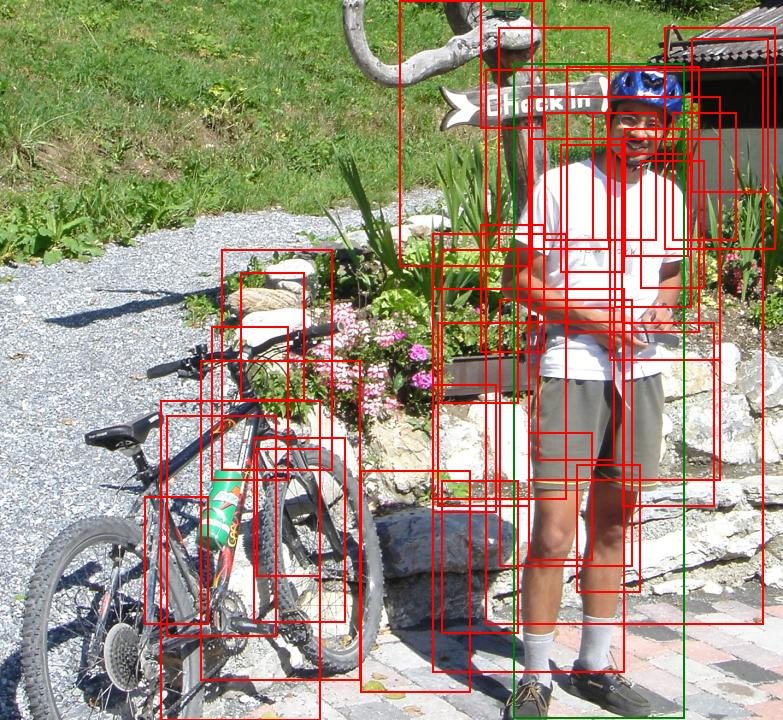

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000017.png (Ảnh thứ 100/288): Precision=0.0256, Recall=1.0000, F1=0.0500, Accuracy=0.0256, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


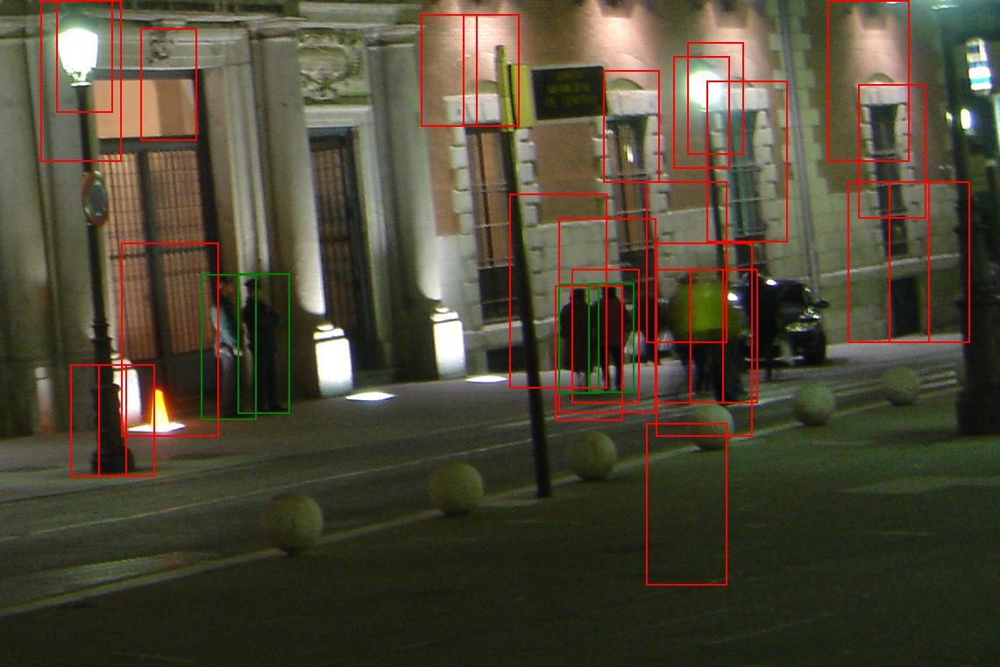

AP@IoU=0.50: 0.0357
AP@IoU=0.55: 0.0357
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.2500
Recall@IoU=0.55: 0.2500
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001664.png (Ảnh thứ 101/288): Precision=0.0400, Recall=0.2500, F1=0.0690, Accuracy=0.0357, mAP@0.5:0.95=0.0071, mAR@0.5:0.95=0.0500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


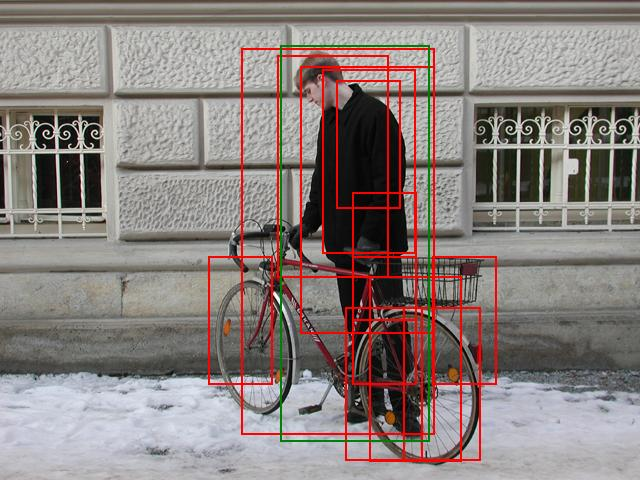

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_061.png (Ảnh thứ 102/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


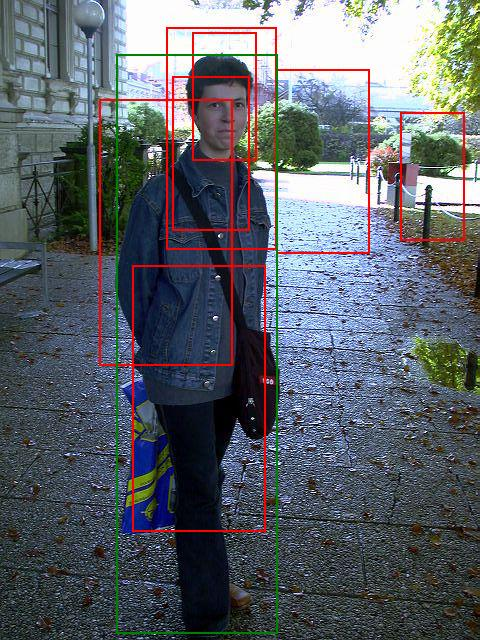

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_030.png (Ảnh thứ 103/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


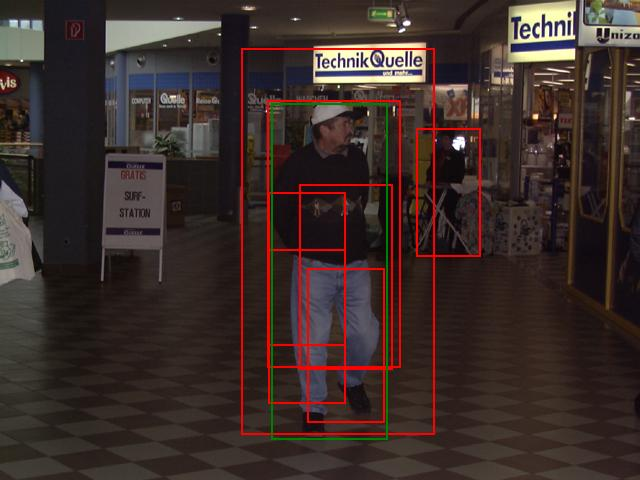

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_161.png (Ảnh thứ 104/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


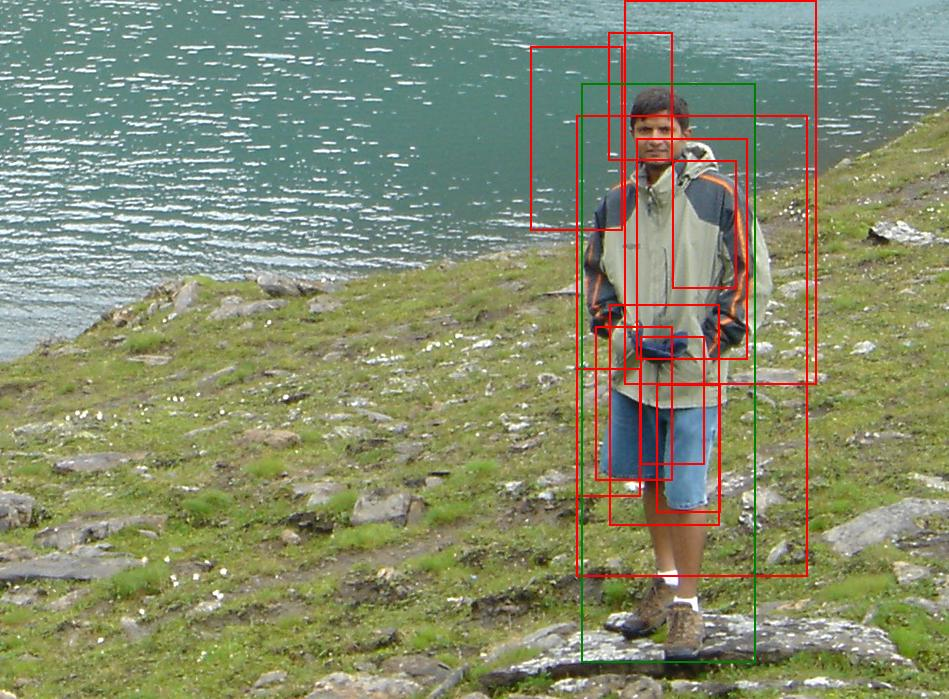

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000016.png (Ảnh thứ 105/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


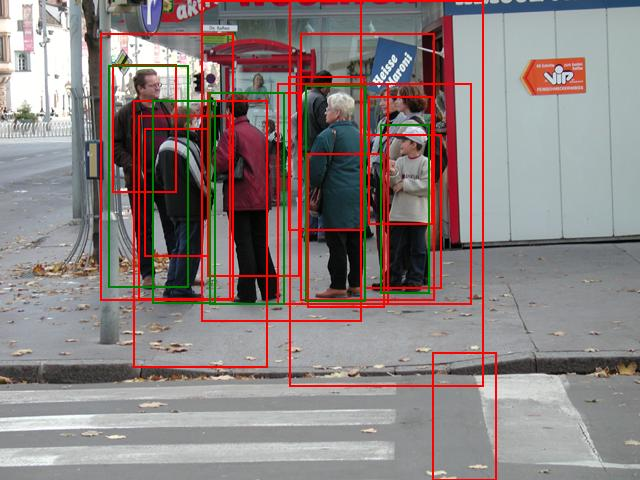

AP@IoU=0.50: 0.7500
AP@IoU=0.55: 0.2750
AP@IoU=0.60: 0.2750
AP@IoU=0.65: 0.0250
AP@IoU=0.70: 0.0250
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.6000
Recall@IoU=0.60: 0.6000
Recall@IoU=0.65: 0.2000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_137.png (Ảnh thứ 106/288): Precision=0.3125, Recall=1.0000, F1=0.4762, Accuracy=0.3125, mAP@0.5:0.95=0.1350, mAR@0.5:0.95=0.2600
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


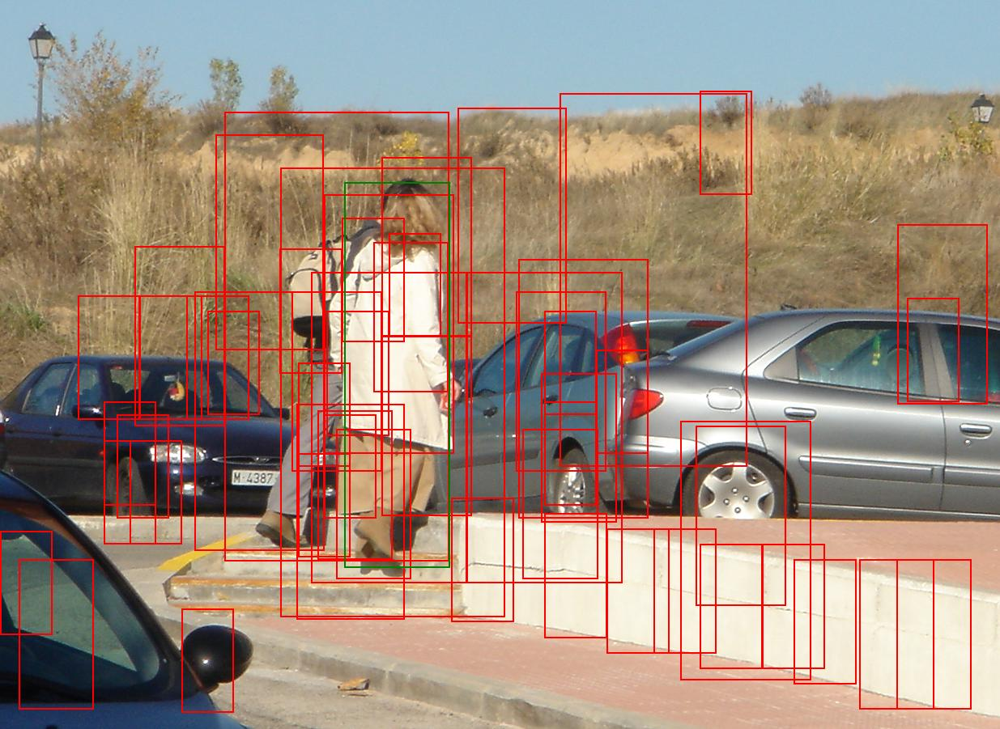

AP@IoU=0.50: 0.1250
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001545.png (Ảnh thứ 107/288): Precision=0.0179, Recall=1.0000, F1=0.0351, Accuracy=0.0179, mAP@0.5:0.95=0.0250, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


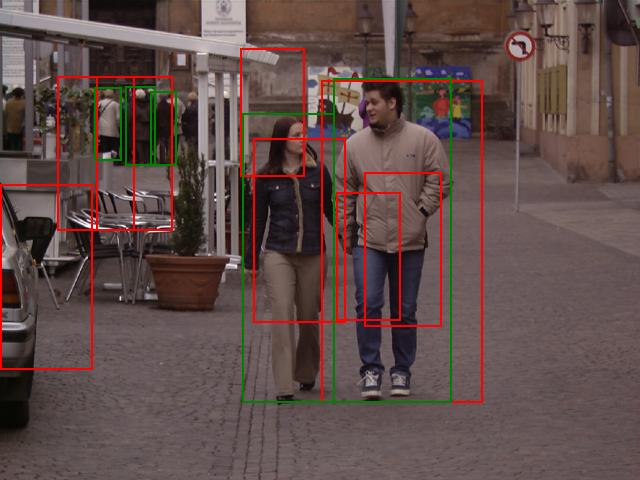

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.2000
AP@IoU=0.60: 0.2000
AP@IoU=0.65: 0.2000
AP@IoU=0.70: 0.2000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4000
Recall@IoU=0.55: 0.2000
Recall@IoU=0.60: 0.2000
Recall@IoU=0.65: 0.2000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_127.png (Ảnh thứ 108/288): Precision=0.2500, Recall=0.4000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.1133, mAR@0.5:0.95=0.1200
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


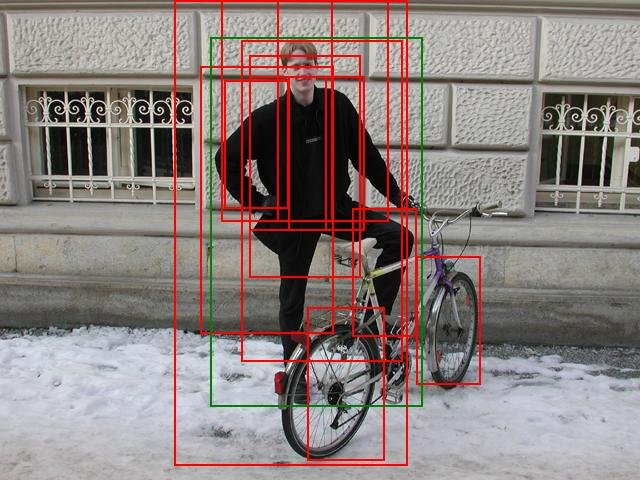

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_064.png (Ảnh thứ 109/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


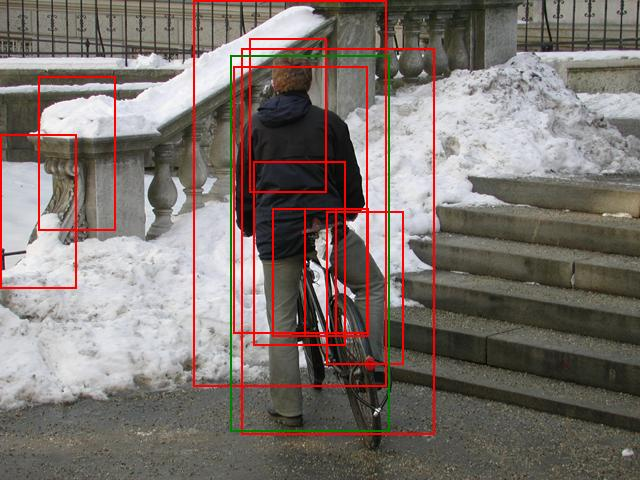

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.1000
AP@IoU=0.70: 0.1000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_162.png (Ảnh thứ 110/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.2700, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


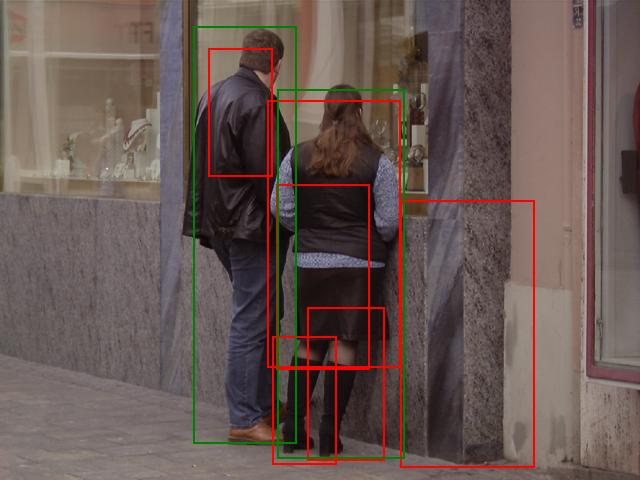

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_246.png (Ảnh thứ 111/288): Precision=0.1667, Recall=0.5000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


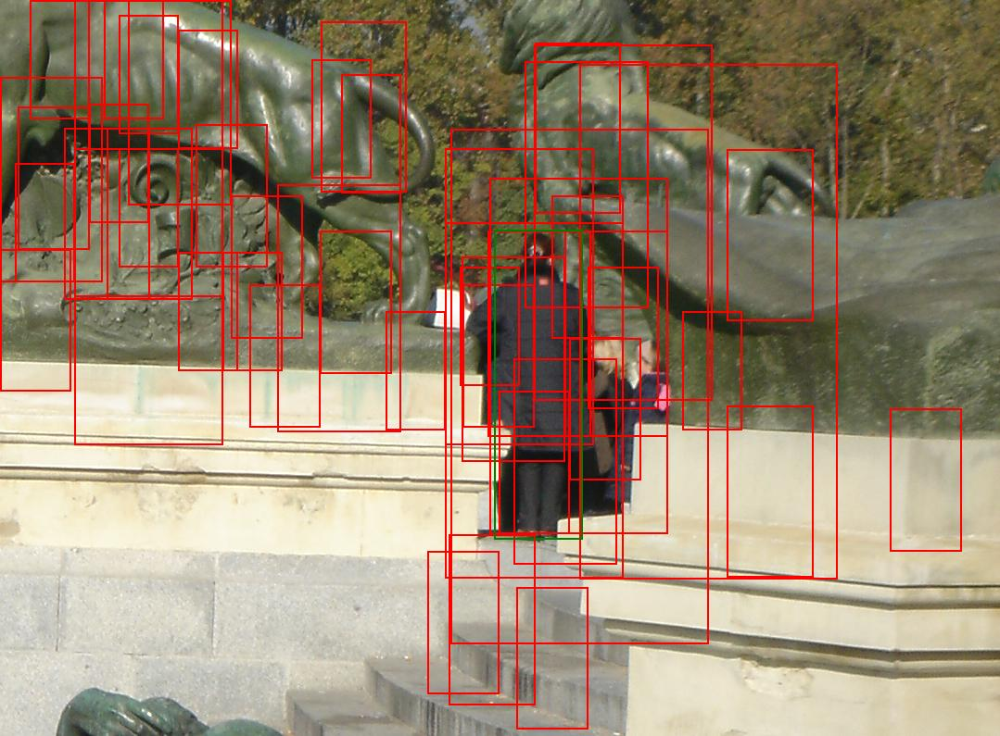

AP@IoU=0.50: 0.0714
AP@IoU=0.55: 0.0714
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001549.png (Ảnh thứ 112/288): Precision=0.0196, Recall=1.0000, F1=0.0385, Accuracy=0.0196, mAP@0.5:0.95=0.0143, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


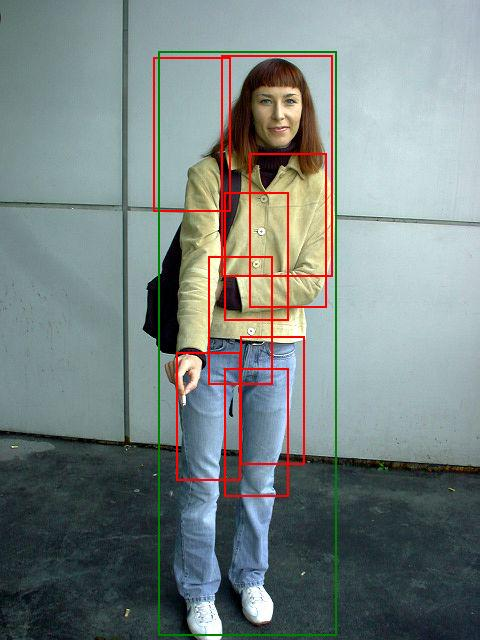

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_026.png (Ảnh thứ 113/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


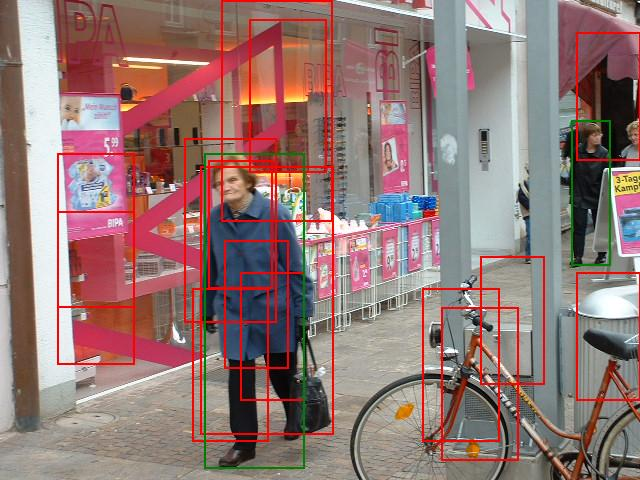

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_029.png (Ảnh thứ 114/288): Precision=0.0667, Recall=0.5000, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


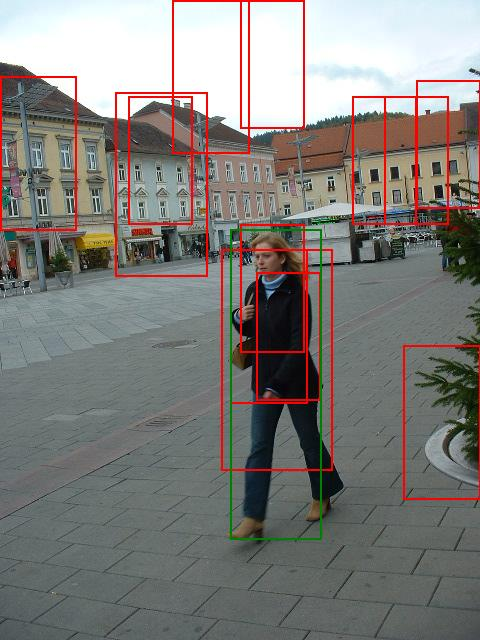

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_037.png (Ảnh thứ 115/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


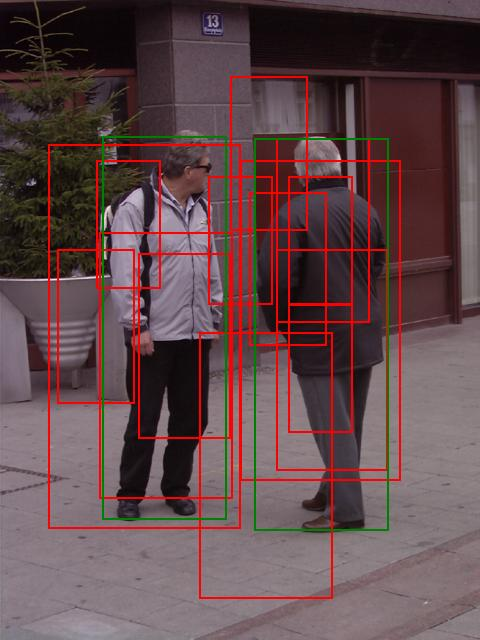

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.6250
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_093.png (Ảnh thứ 116/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.4125, mAR@0.5:0.95=0.4500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


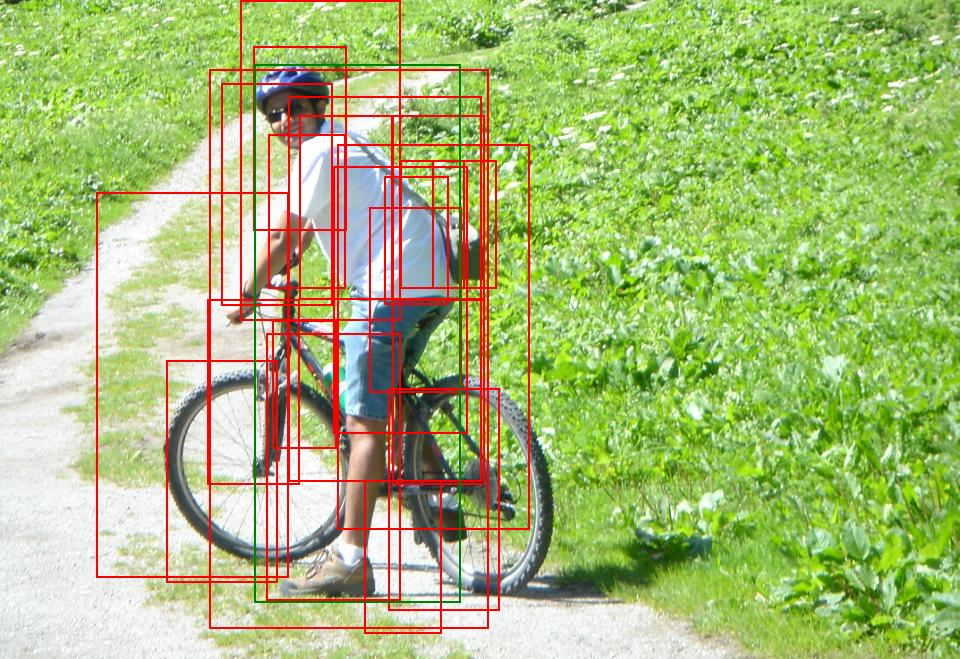

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000018.png (Ảnh thứ 117/288): Precision=0.0455, Recall=1.0000, F1=0.0870, Accuracy=0.0455, mAP@0.5:0.95=0.1667, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


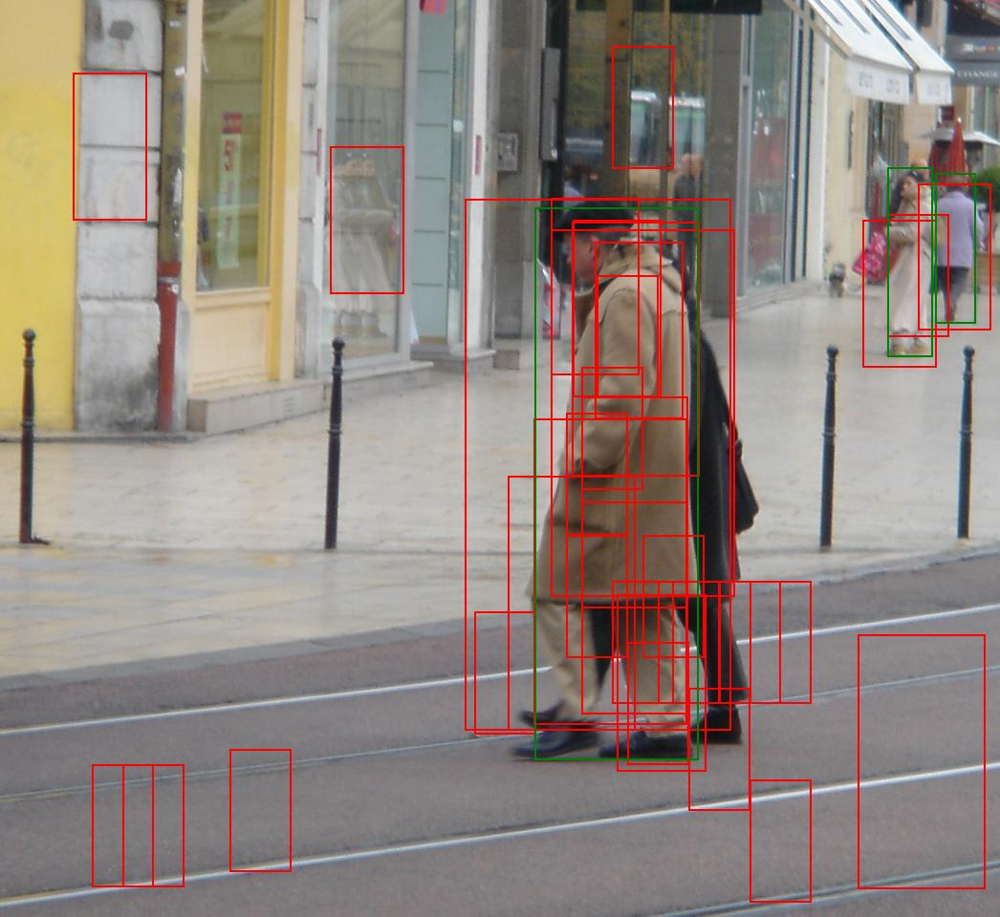

AP@IoU=0.50: 0.1250
AP@IoU=0.55: 0.0476
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001522.png (Ảnh thứ 118/288): Precision=0.0882, Recall=1.0000, F1=0.1622, Accuracy=0.0882, mAP@0.5:0.95=0.0173, mAR@0.5:0.95=0.1333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


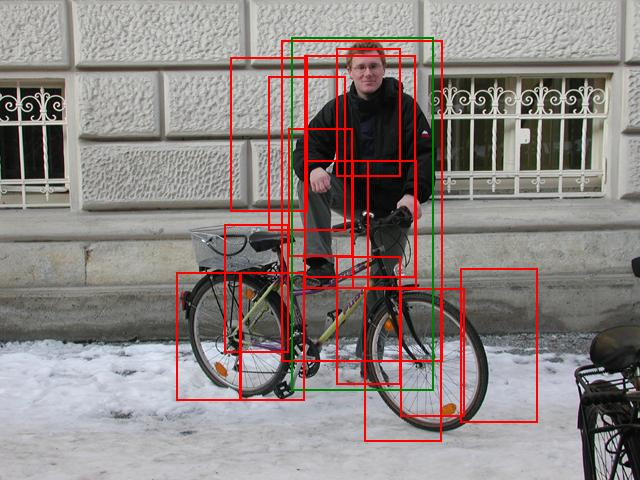

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_056.png (Ảnh thứ 119/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


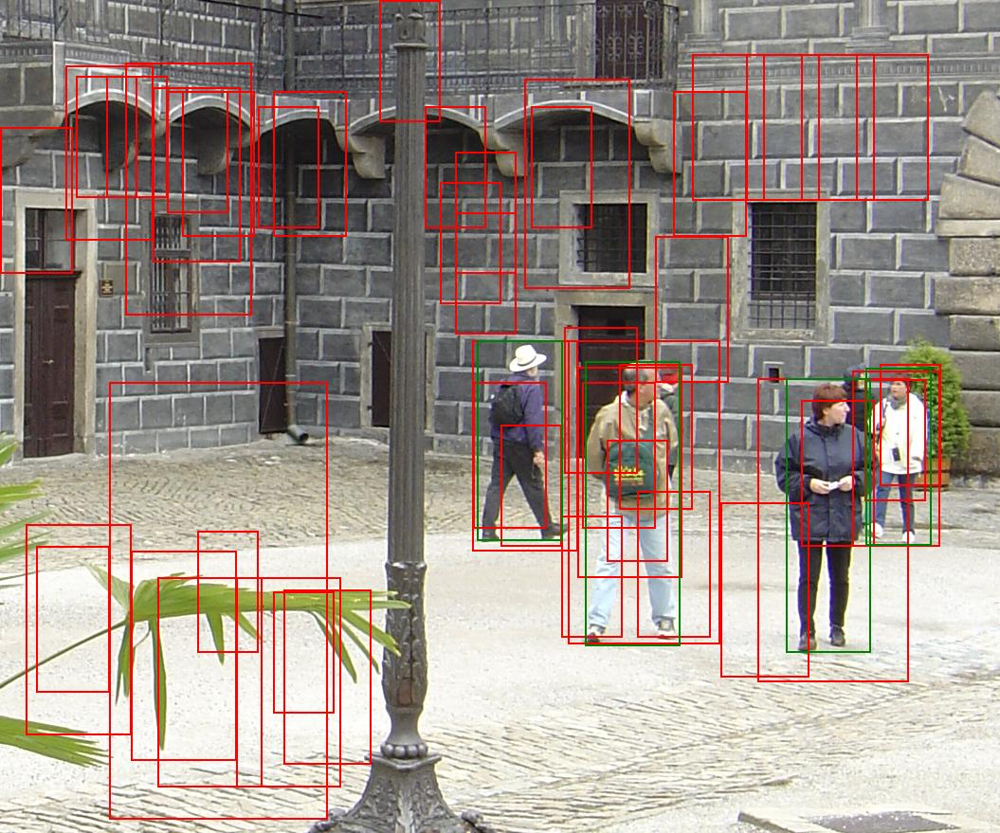

AP@IoU=0.50: 0.6847
AP@IoU=0.55: 0.5938
AP@IoU=0.60: 0.2163
AP@IoU=0.65: 0.2163
AP@IoU=0.70: 0.1875
AP@IoU=0.75: 0.0312
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.7500
Recall@IoU=0.60: 0.7500
Recall@IoU=0.65: 0.7500
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001718.png (Ảnh thứ 120/288): Precision=0.0816, Recall=1.0000, F1=0.1509, Accuracy=0.0816, mAP@0.5:0.95=0.1930, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


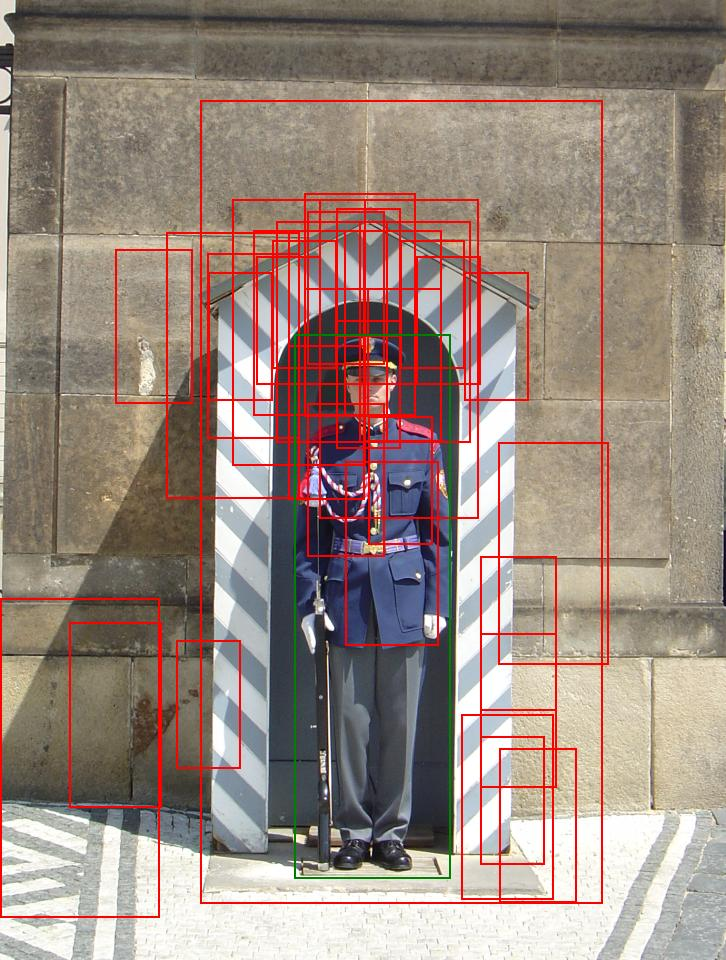

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001602.png (Ảnh thứ 121/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


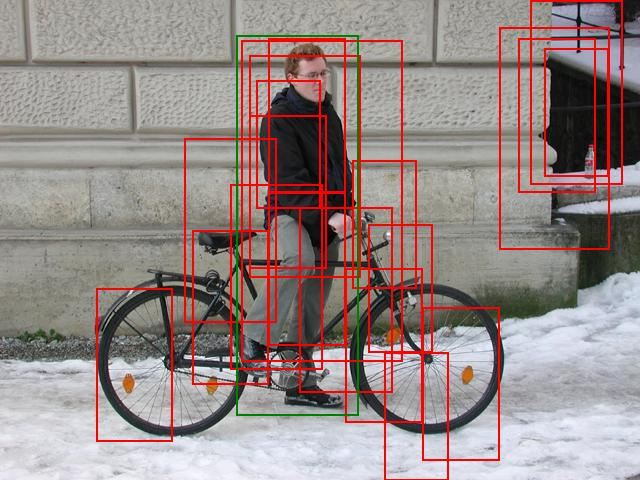

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.0556
AP@IoU=0.60: 0.0556
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_102.png (Ảnh thứ 122/288): Precision=0.0500, Recall=1.0000, F1=0.0952, Accuracy=0.0500, mAP@0.5:0.95=0.1111, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


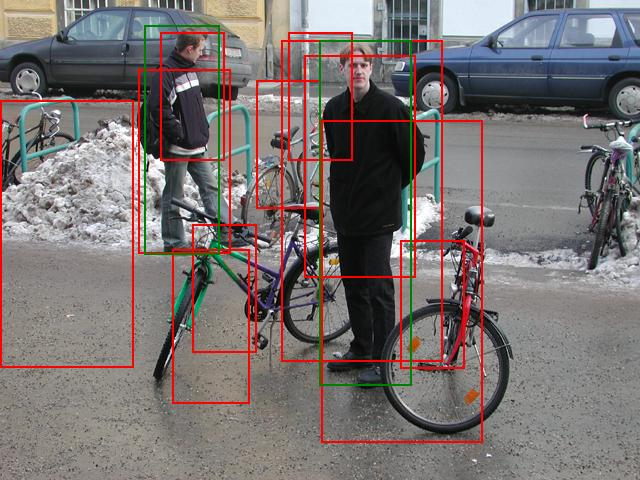

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.8333
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_076.png (Ảnh thứ 123/288): Precision=0.1818, Recall=1.0000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


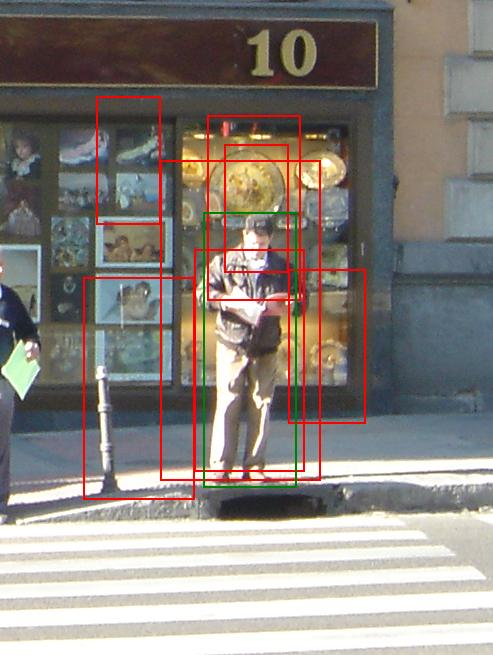

AP@IoU=0.50: 0.1667
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001574.png (Ảnh thứ 124/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.0833, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


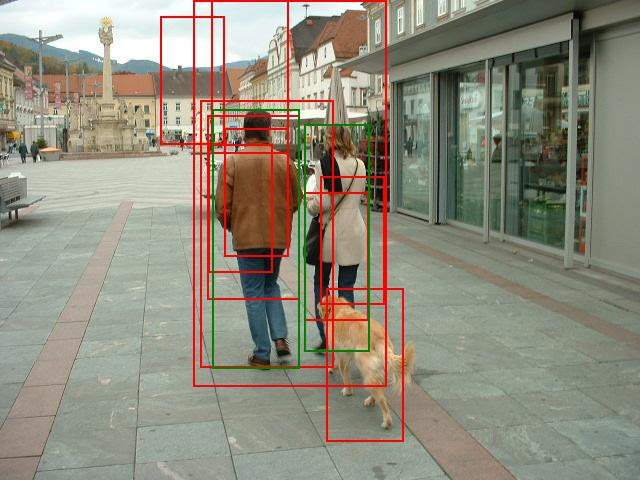

AP@IoU=0.50: 0.7500
AP@IoU=0.55: 0.7500
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_318.png (Ảnh thứ 125/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.2167, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


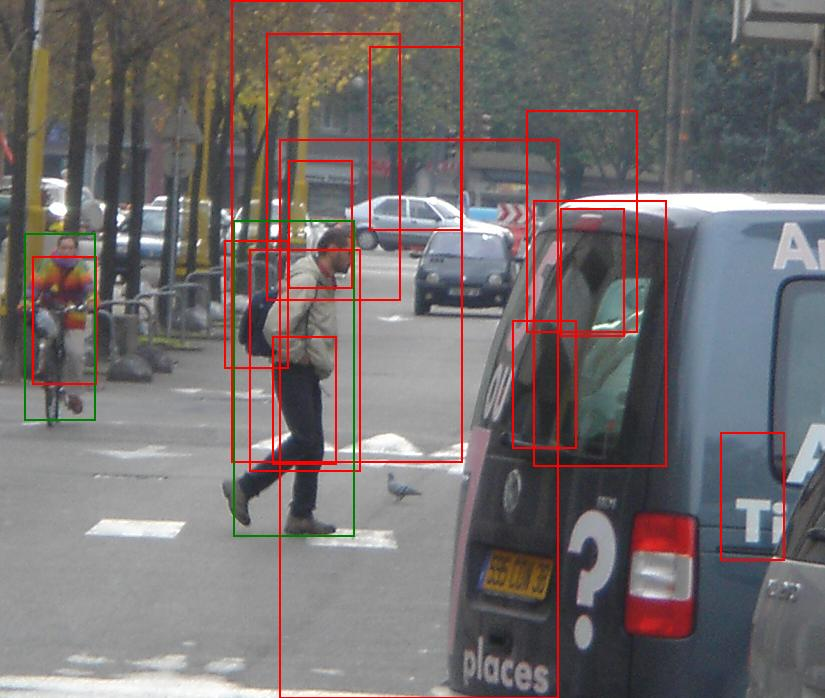

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001531.png (Ảnh thứ 126/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


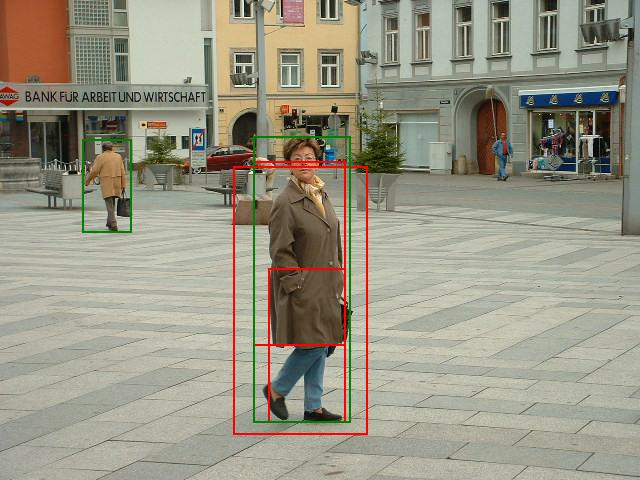

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_282.png (Ảnh thứ 127/288): Precision=0.3333, Recall=0.5000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.1500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


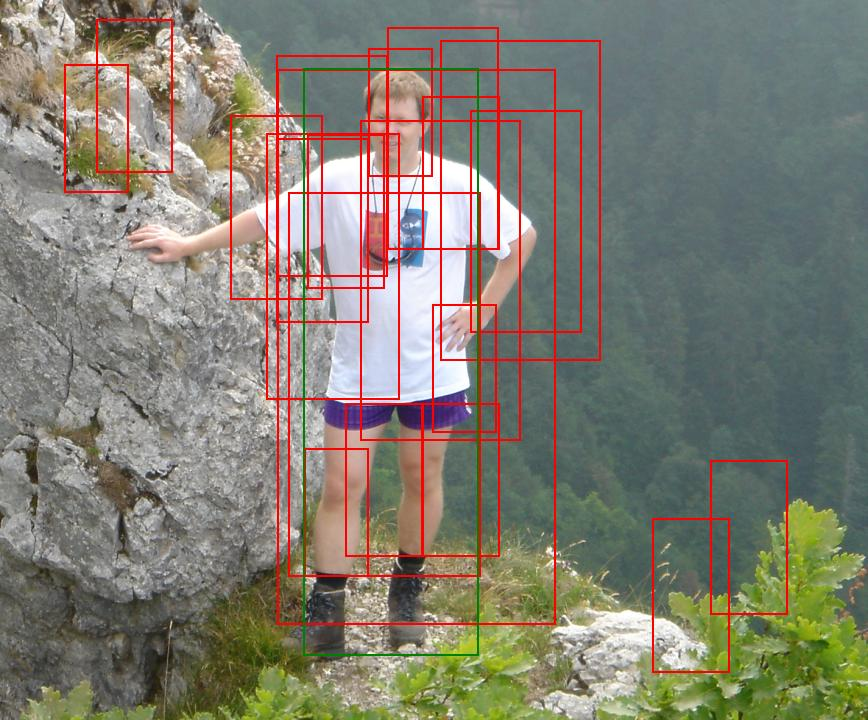

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000009.png (Ảnh thứ 128/288): Precision=0.0476, Recall=1.0000, F1=0.0909, Accuracy=0.0476, mAP@0.5:0.95=0.0750, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


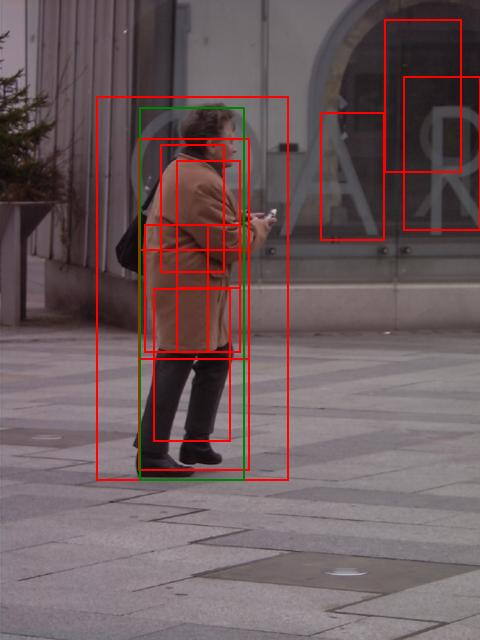

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_007.png (Ảnh thứ 129/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


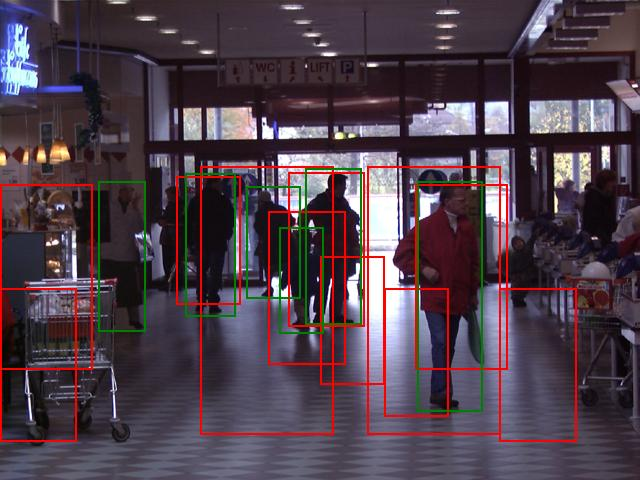

AP@IoU=0.50: 0.3833
AP@IoU=0.55: 0.3833
AP@IoU=0.60: 0.3833
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_207.png (Ảnh thứ 130/288): Precision=0.2727, Recall=0.5000, F1=0.3529, Accuracy=0.2143, mAP@0.5:0.95=0.1817, mAR@0.5:0.95=0.2167
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


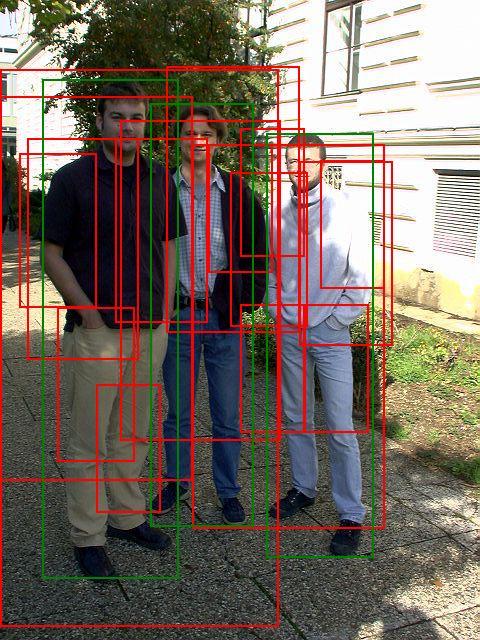

AP@IoU=0.50: 0.2528
AP@IoU=0.55: 0.0667
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_115.png (Ảnh thứ 131/288): Precision=0.1765, Recall=1.0000, F1=0.3000, Accuracy=0.1765, mAP@0.5:0.95=0.0319, mAR@0.5:0.95=0.1333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


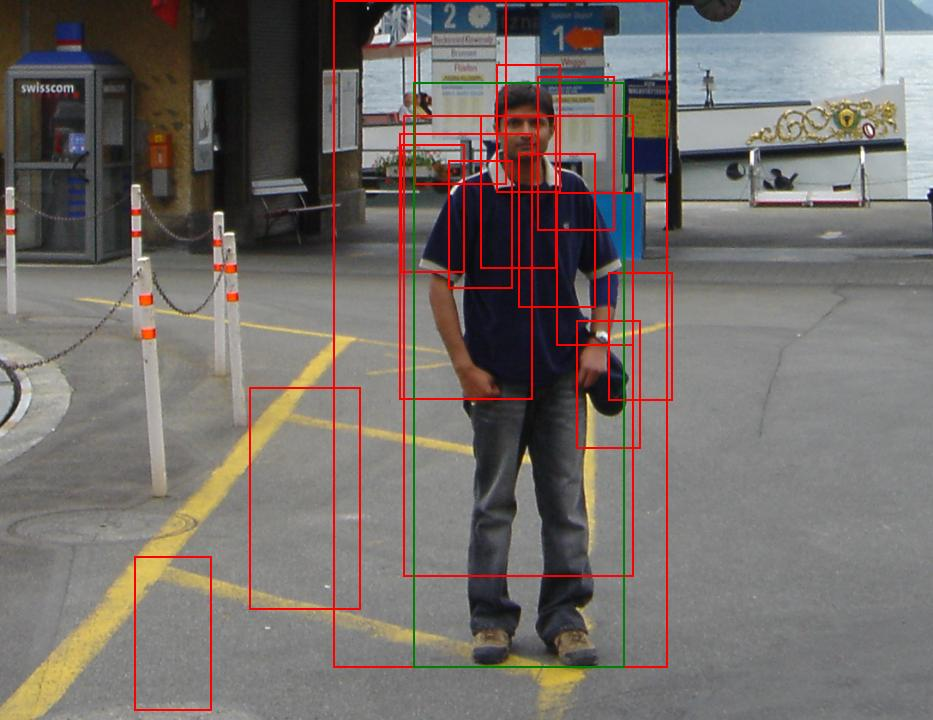

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000019.png (Ảnh thứ 132/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


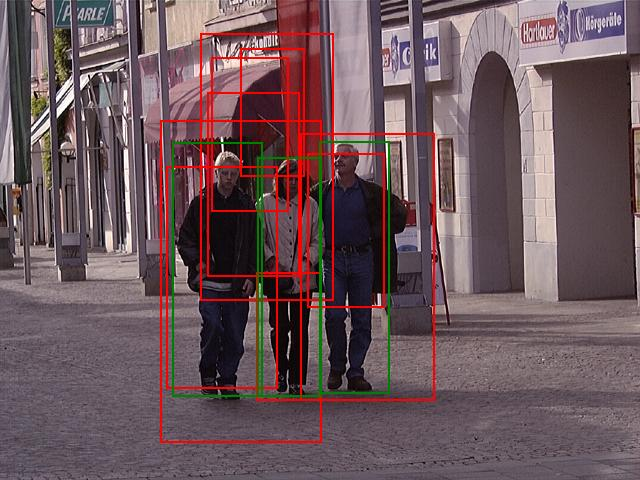

AP@IoU=0.50: 0.5694
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_135.png (Ảnh thứ 133/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.1903, mAR@0.5:0.95=0.2333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


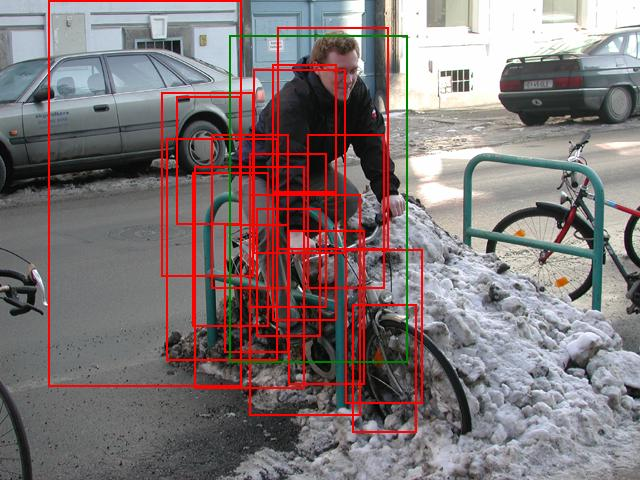

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_092.png (Ảnh thứ 134/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


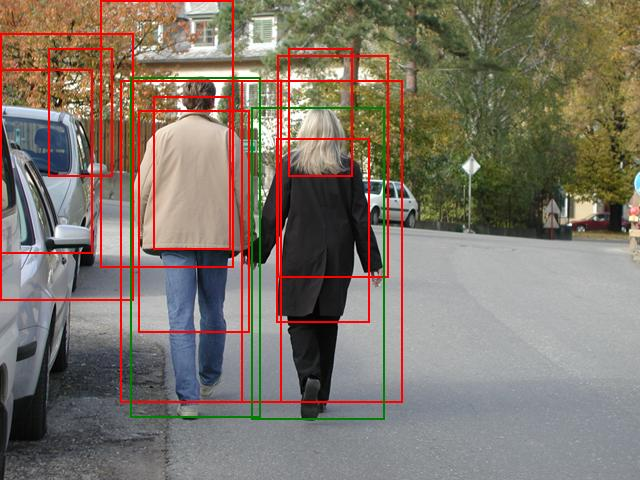

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.8333
AP@IoU=0.60: 0.8333
AP@IoU=0.65: 0.8333
AP@IoU=0.70: 0.8333
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_323.png (Ảnh thứ 135/288): Precision=0.1818, Recall=1.0000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.4667, mAR@0.5:0.95=0.5500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


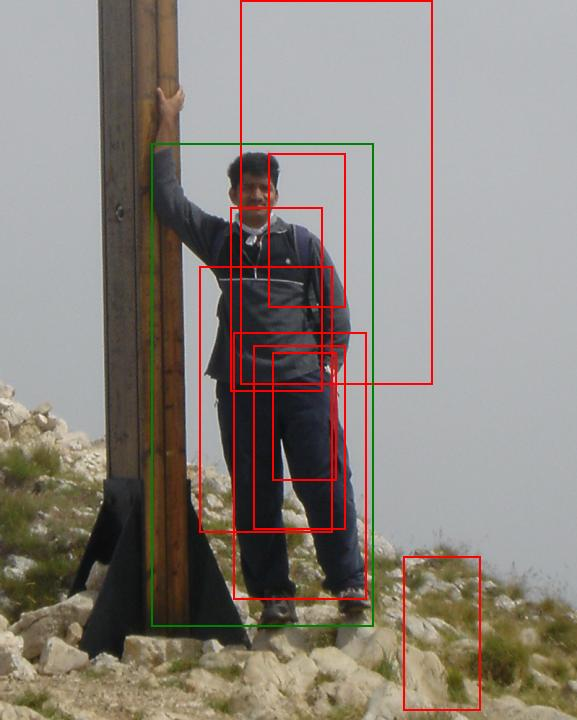

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000012.png (Ảnh thứ 136/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


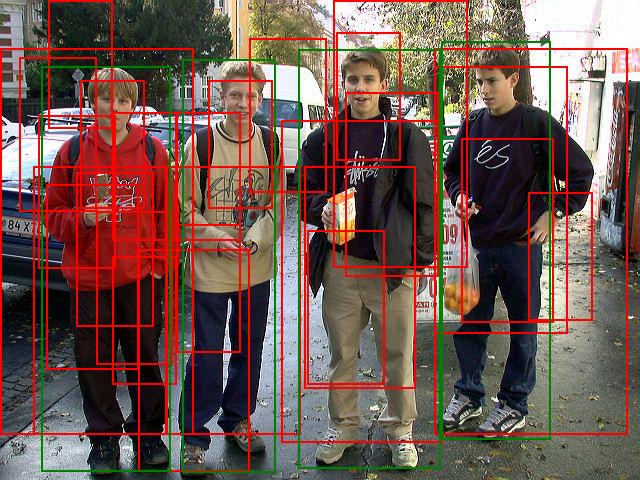

AP@IoU=0.50: 0.5375
AP@IoU=0.55: 0.4750
AP@IoU=0.60: 0.3500
AP@IoU=0.65: 0.0500
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.7500
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_272.png (Ảnh thứ 137/288): Precision=0.1481, Recall=1.0000, F1=0.2581, Accuracy=0.1481, mAP@0.5:0.95=0.1412, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


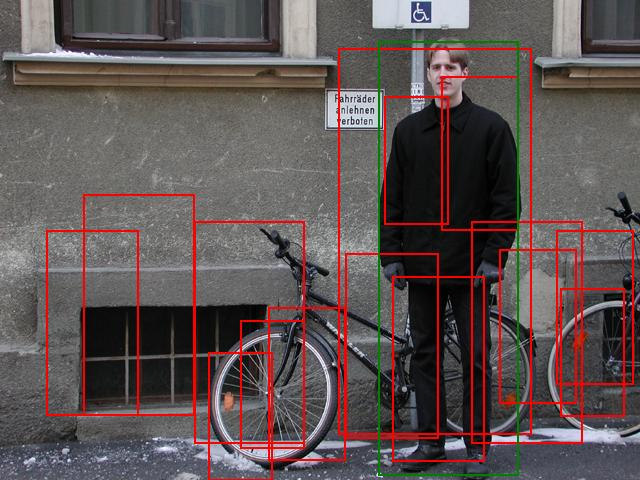

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_080.png (Ảnh thứ 138/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


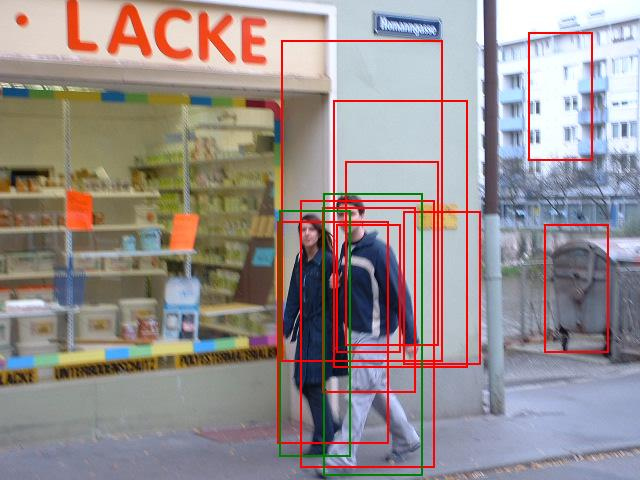

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_316.png (Ảnh thứ 139/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


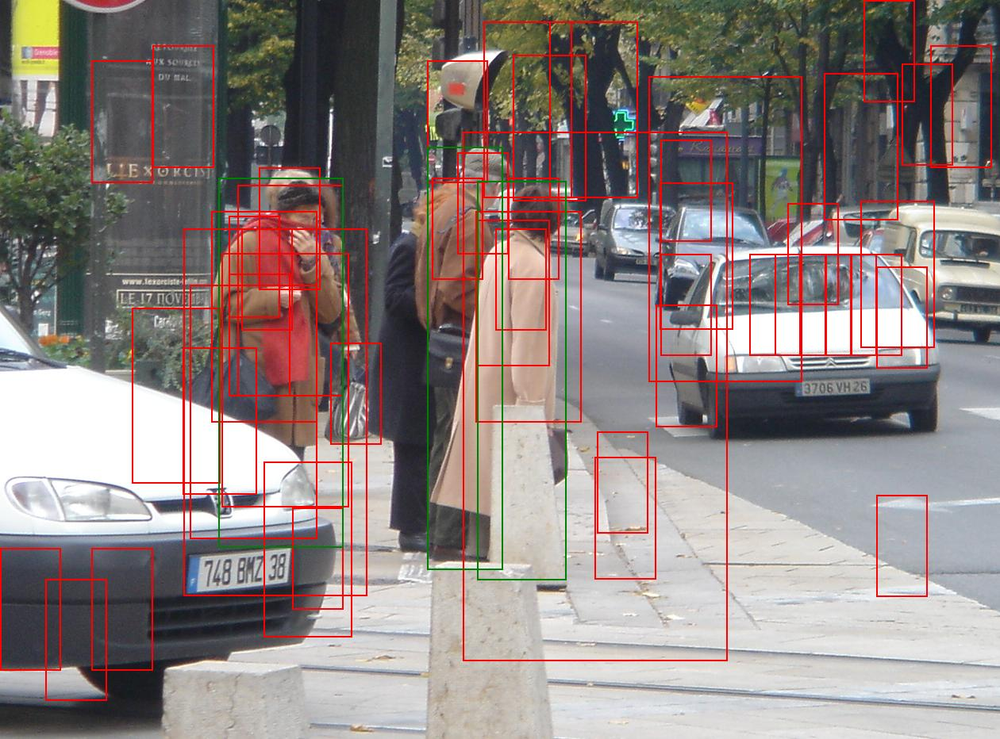

AP@IoU=0.50: 0.0370
AP@IoU=0.55: 0.0370
AP@IoU=0.60: 0.0370
AP@IoU=0.65: 0.0370
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.3333
Recall@IoU=0.55: 0.3333
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001641.png (Ảnh thứ 140/288): Precision=0.0200, Recall=0.3333, F1=0.0377, Accuracy=0.0192, mAP@0.5:0.95=0.0148, mAR@0.5:0.95=0.1333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


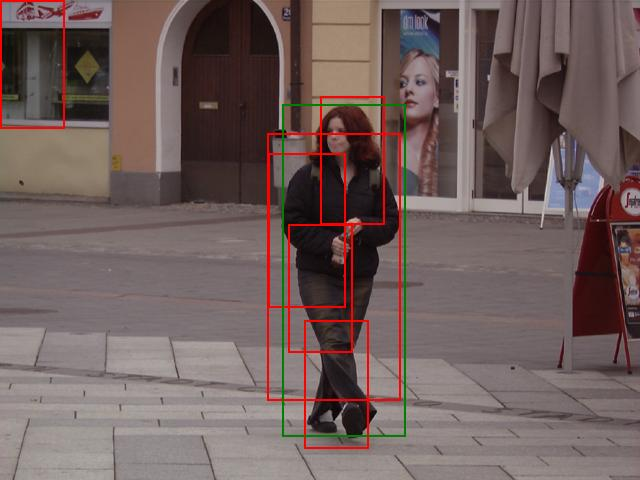

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_051.png (Ảnh thứ 141/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


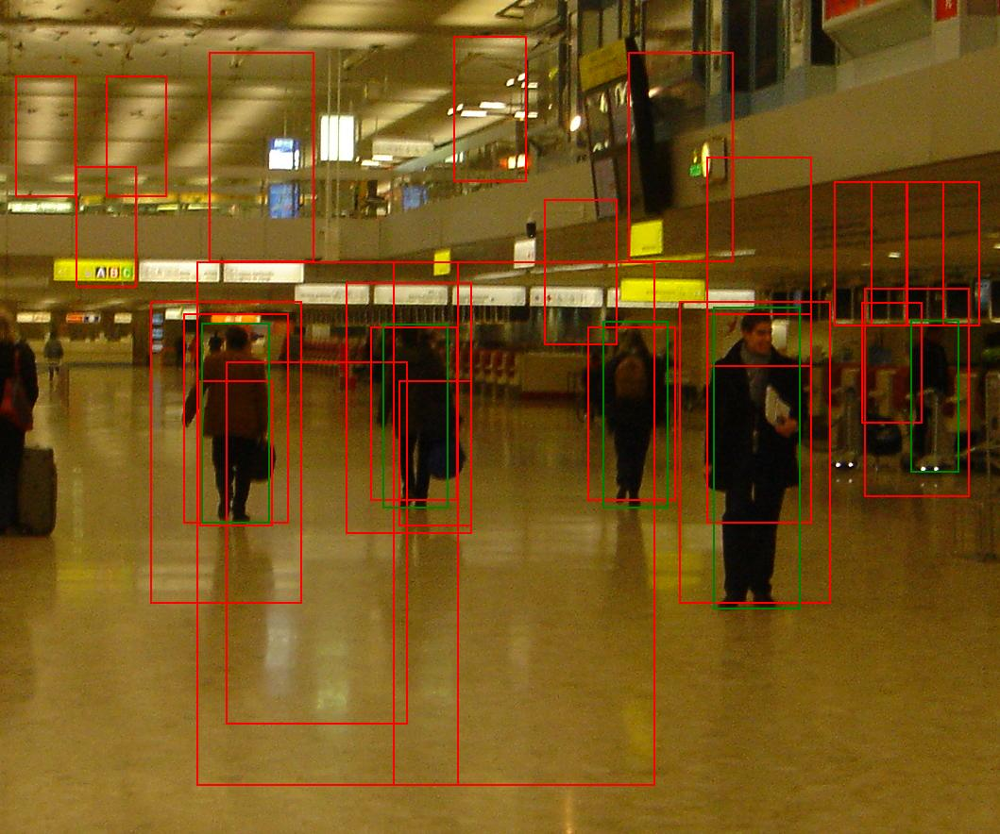

AP@IoU=0.50: 0.8000
AP@IoU=0.55: 0.8000
AP@IoU=0.60: 0.5833
AP@IoU=0.65: 0.3200
AP@IoU=0.70: 0.2000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8000
Recall@IoU=0.55: 0.8000
Recall@IoU=0.60: 0.8000
Recall@IoU=0.65: 0.6000
Recall@IoU=0.70: 0.4000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001533.png (Ảnh thứ 142/288): Precision=0.1600, Recall=0.8000, F1=0.2667, Accuracy=0.1538, mAP@0.5:0.95=0.2703, mAR@0.5:0.95=0.3400
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


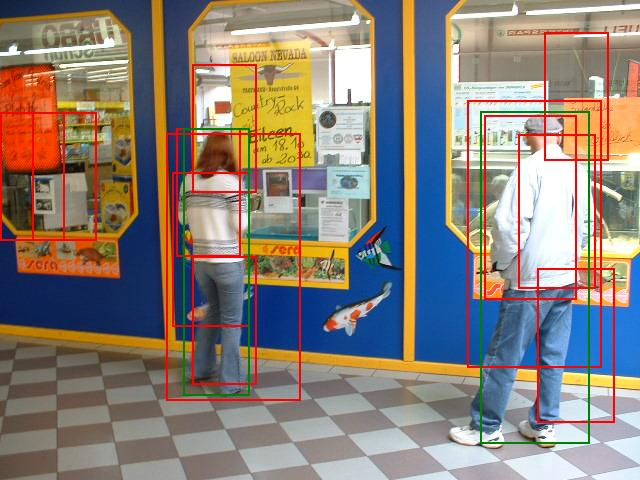

AP@IoU=0.50: 0.7500
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.1250
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_314.png (Ảnh thứ 143/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


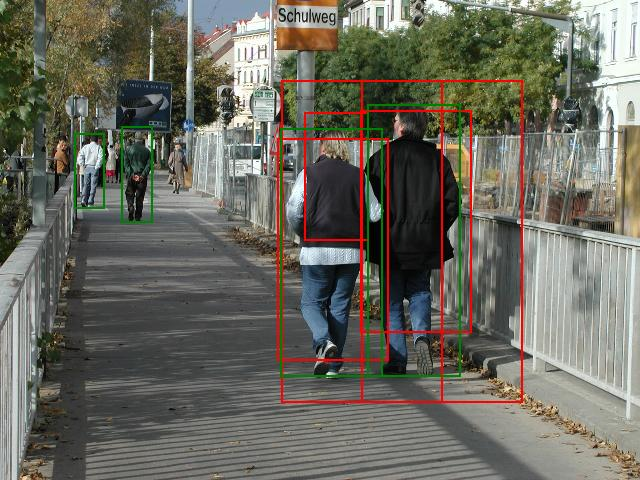

AP@IoU=0.50: 0.3500
AP@IoU=0.55: 0.3500
AP@IoU=0.60: 0.3500
AP@IoU=0.65: 0.3500
AP@IoU=0.70: 0.3500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.2500
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.2500
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_336.png (Ảnh thứ 144/288): Precision=0.4000, Recall=0.5000, F1=0.4444, Accuracy=0.2857, mAP@0.5:0.95=0.2250, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


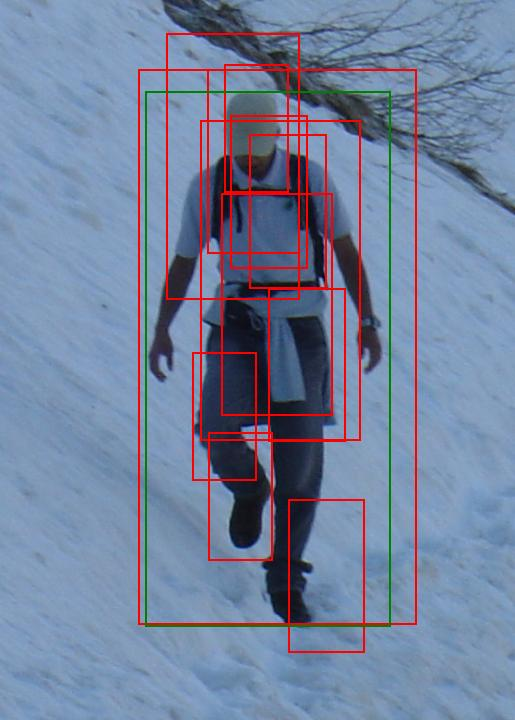

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000006.png (Ảnh thứ 145/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


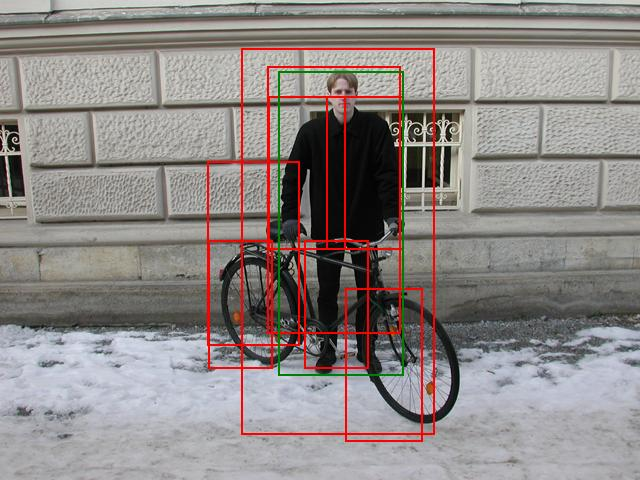

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_044.png (Ảnh thứ 146/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.1750, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


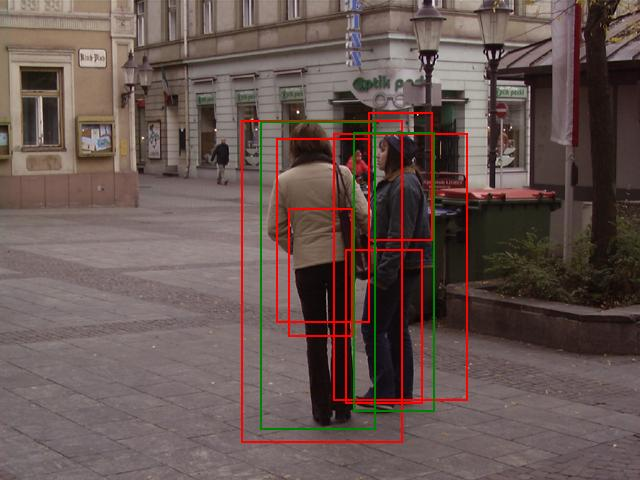

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_189.png (Ảnh thứ 147/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


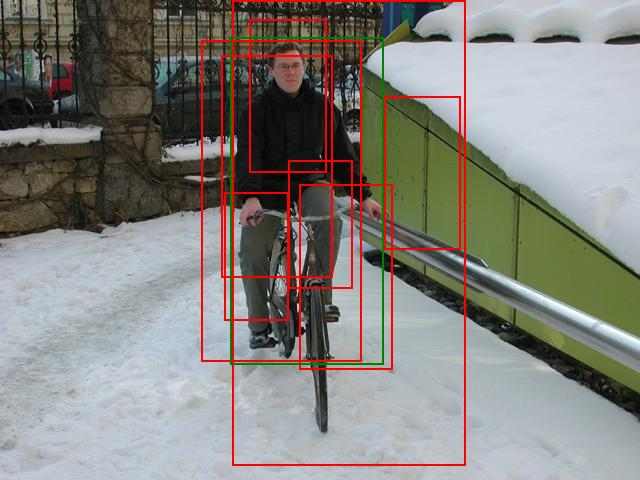

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_165.png (Ảnh thứ 148/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


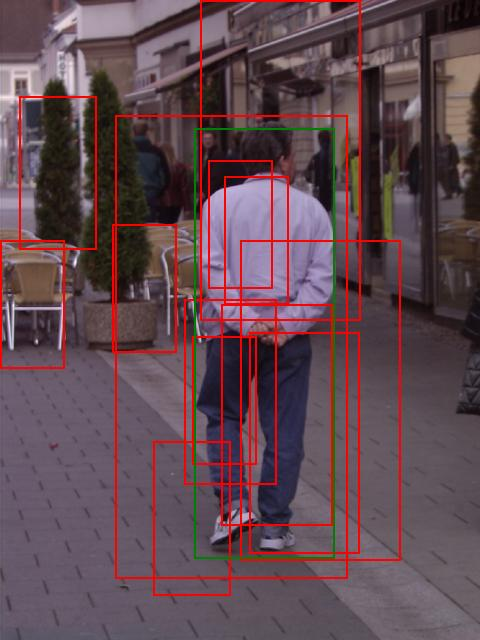

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_099.png (Ảnh thứ 149/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


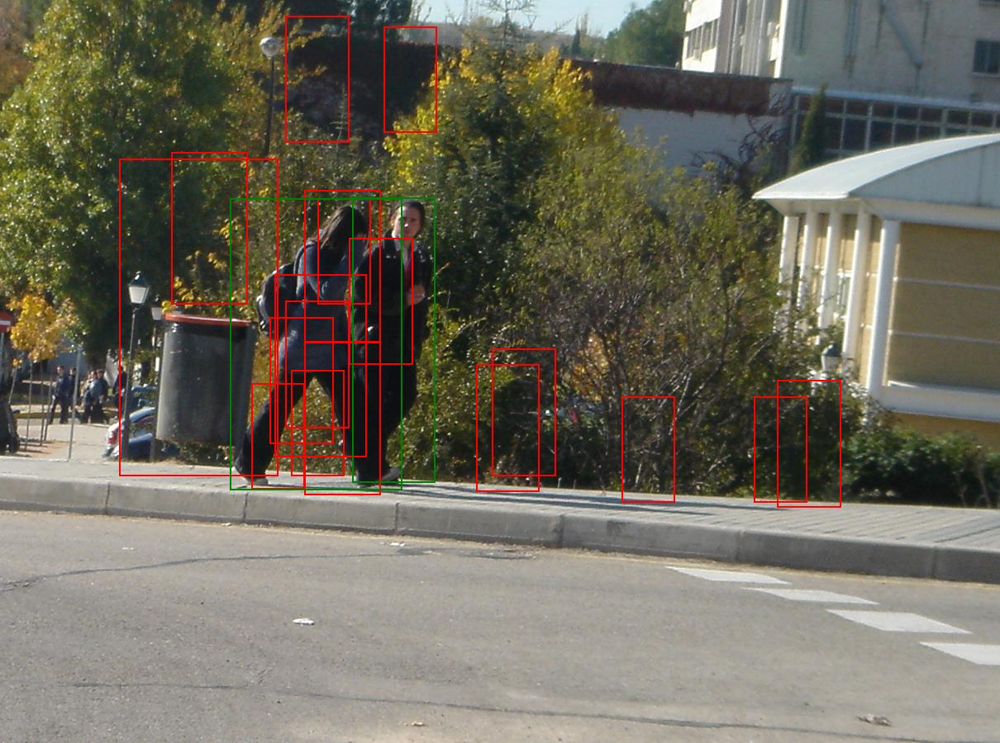

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001661.png (Ảnh thứ 150/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


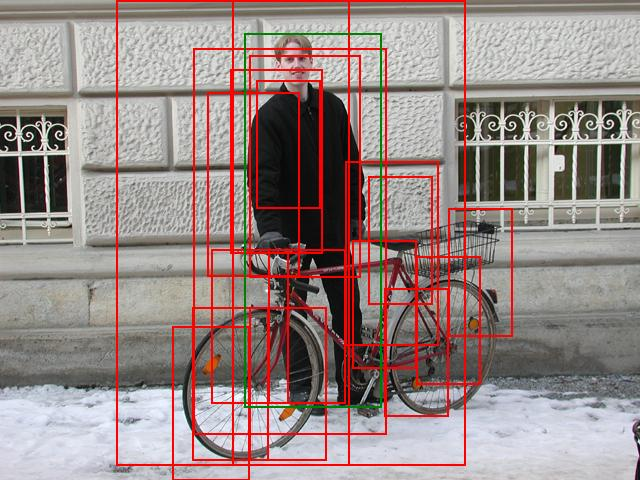

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_060.png (Ảnh thứ 151/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


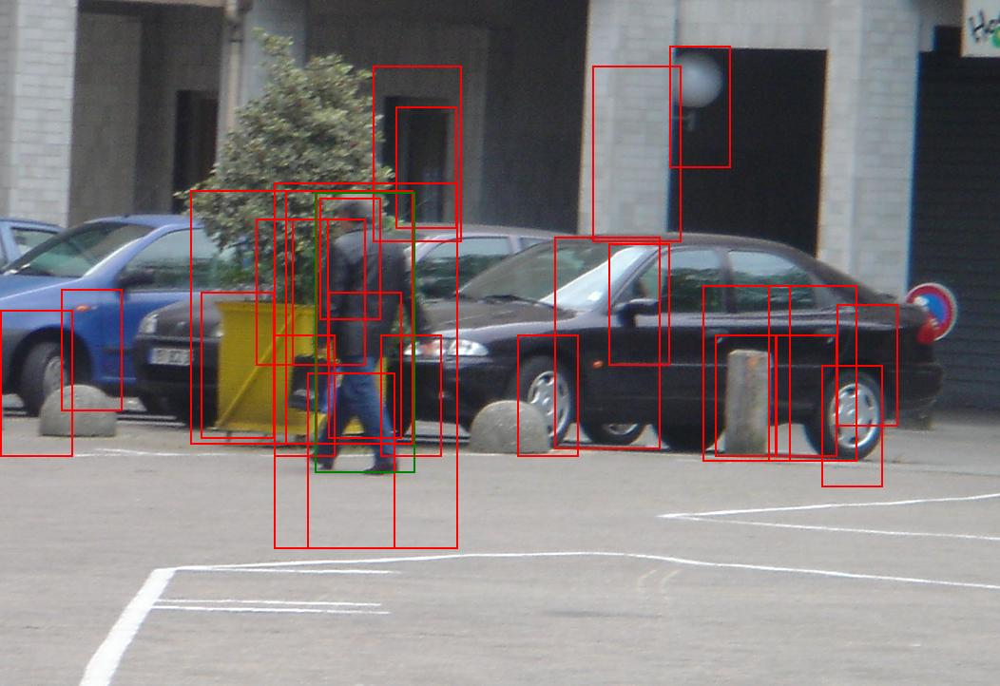

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001653.png (Ảnh thứ 152/288): Precision=0.0385, Recall=1.0000, F1=0.0741, Accuracy=0.0385, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


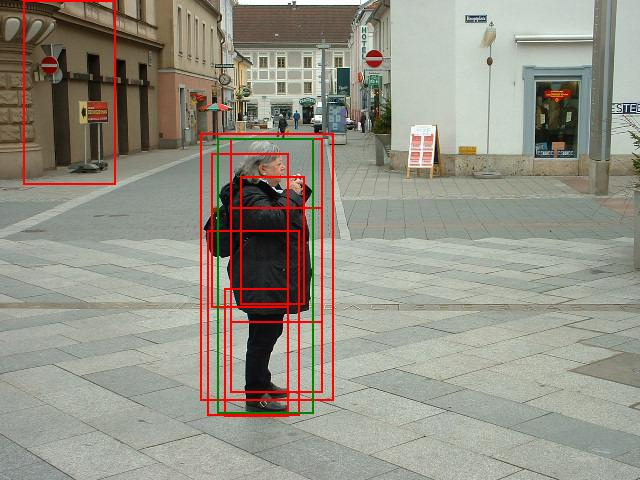

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_070.png (Ảnh thứ 153/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


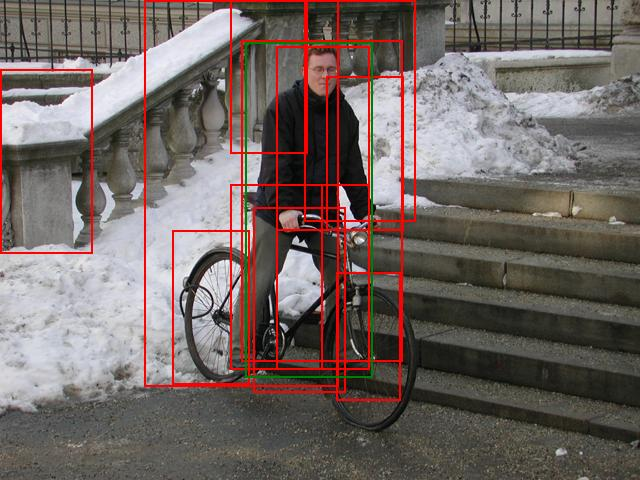

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_093.png (Ảnh thứ 154/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


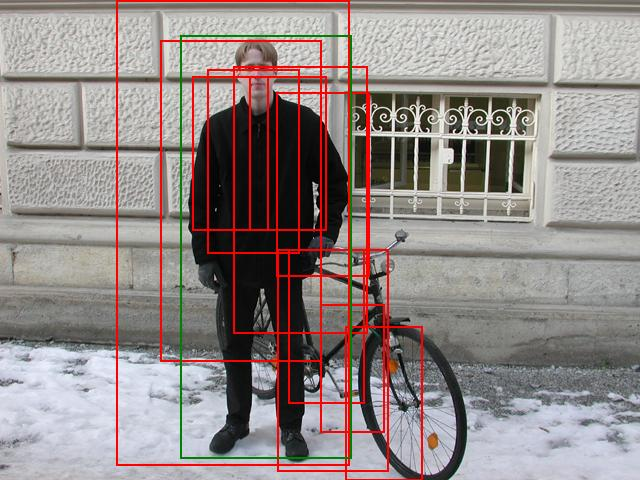

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_045.png (Ảnh thứ 155/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


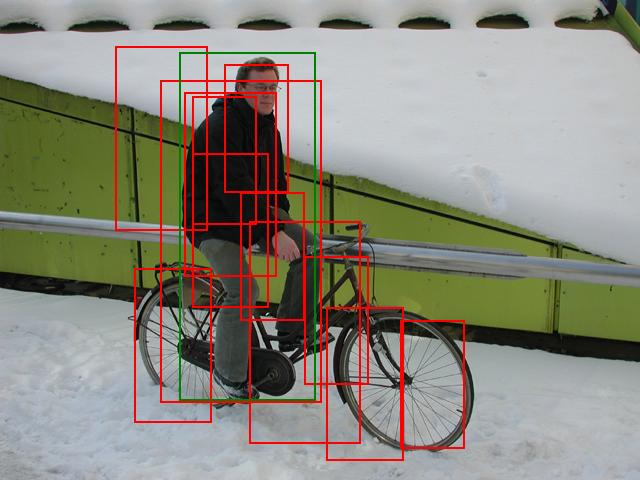

AP@IoU=0.50: 0.1250
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.1250
AP@IoU=0.65: 0.1250
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.1250
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_095.png (Ảnh thứ 156/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.0750, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


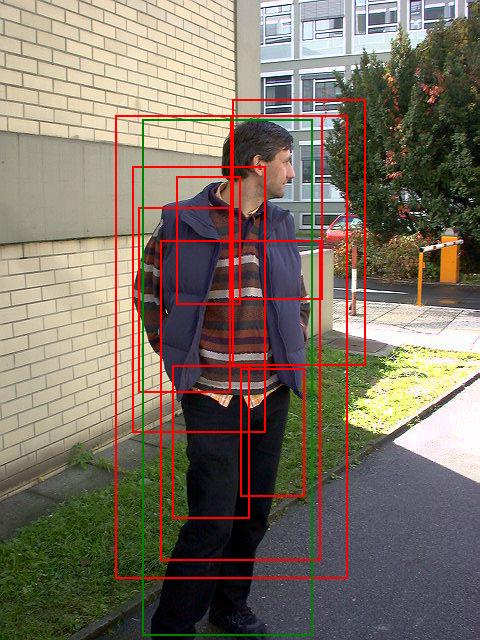

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.1250
AP@IoU=0.60: 0.1250
AP@IoU=0.65: 0.1250
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_033.png (Ảnh thứ 157/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.0708, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


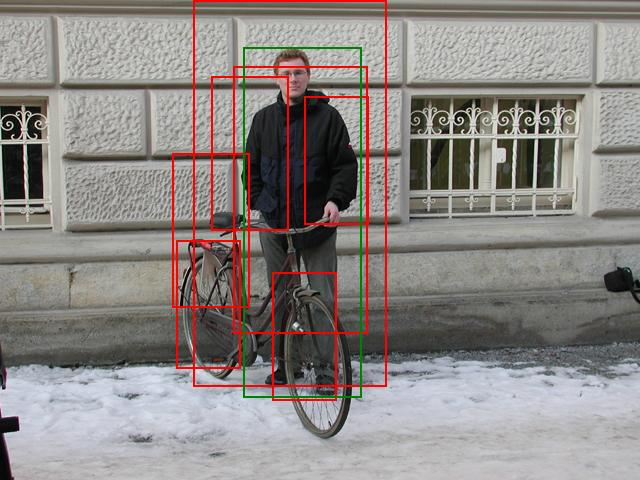

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_057.png (Ảnh thứ 158/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


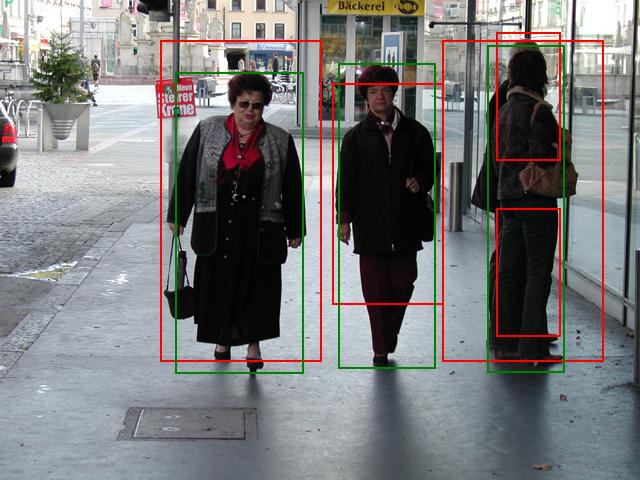

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.6667
AP@IoU=0.60: 0.6667
AP@IoU=0.65: 0.6667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_138.png (Ảnh thứ 159/288): Precision=0.4000, Recall=0.6667, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.2667, mAR@0.5:0.95=0.2667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


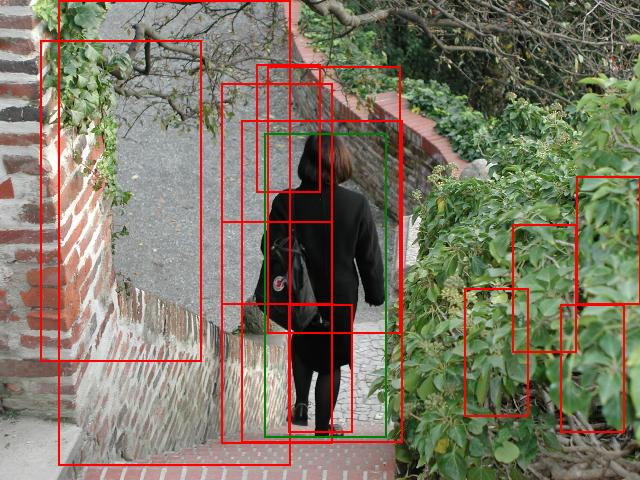

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_076.png (Ảnh thứ 160/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


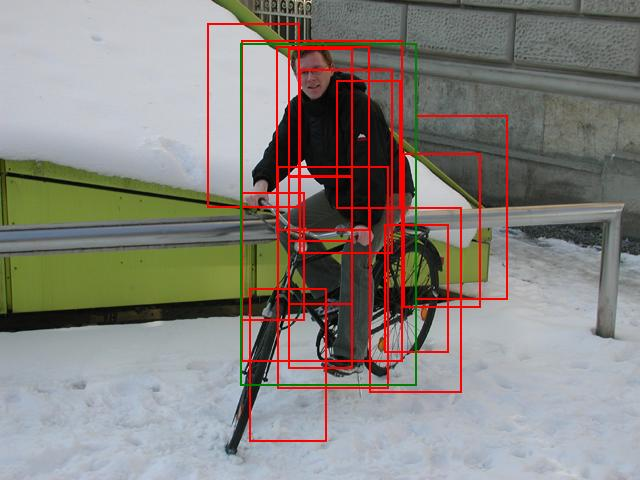

AP@IoU=0.50: 0.1111
AP@IoU=0.55: 0.1111
AP@IoU=0.60: 0.1111
AP@IoU=0.65: 0.1111
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.1111
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_105.png (Ảnh thứ 161/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.0778, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


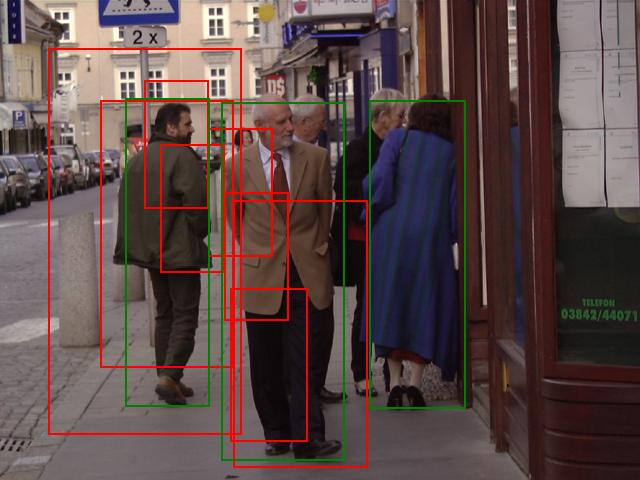

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_250.png (Ảnh thứ 162/288): Precision=0.2500, Recall=0.6667, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.1333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


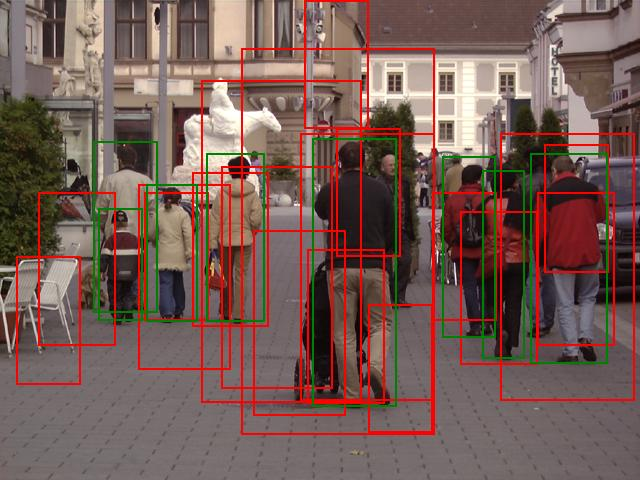

AP@IoU=0.50: 0.4312
AP@IoU=0.55: 0.4312
AP@IoU=0.60: 0.4312
AP@IoU=0.65: 0.1125
AP@IoU=0.70: 0.0250
AP@IoU=0.75: 0.0250
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6250
Recall@IoU=0.55: 0.6250
Recall@IoU=0.60: 0.6250
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.1250
Recall@IoU=0.75: 0.1250
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_236.png (Ảnh thứ 163/288): Precision=0.2632, Recall=0.6250, F1=0.3704, Accuracy=0.2273, mAP@0.5:0.95=0.1456, mAR@0.5:0.95=0.2375
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


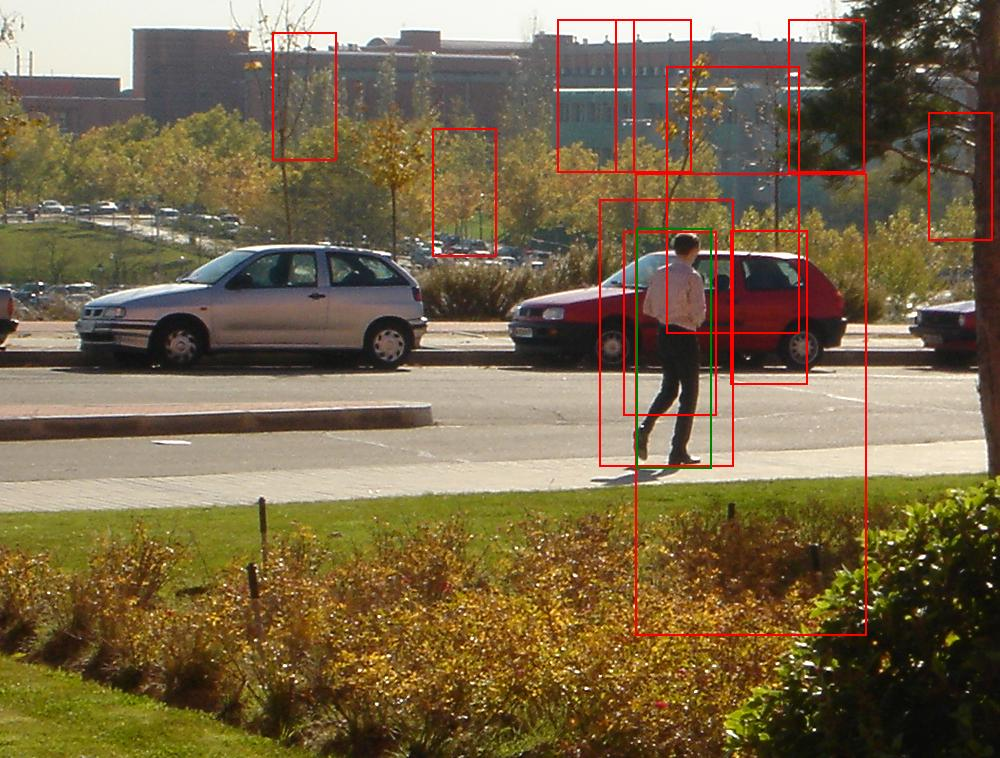

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001659.png (Ảnh thứ 164/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


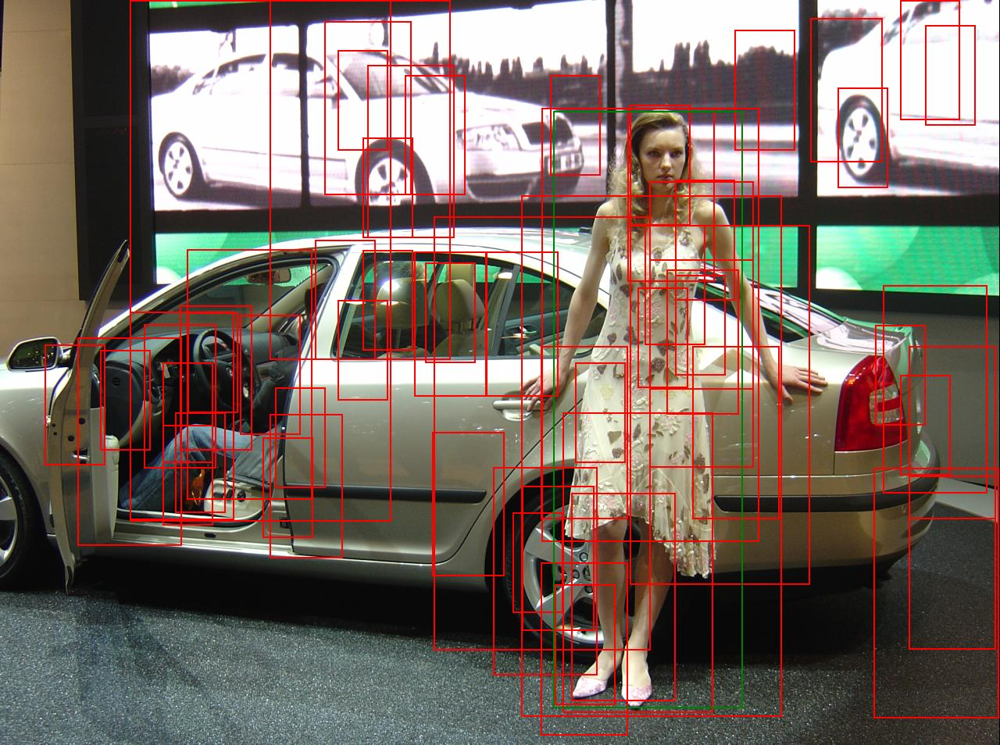

AP@IoU=0.50: 0.0435
AP@IoU=0.55: 0.0435
AP@IoU=0.60: 0.0435
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001590.png (Ảnh thứ 165/288): Precision=0.0156, Recall=1.0000, F1=0.0308, Accuracy=0.0156, mAP@0.5:0.95=0.0130, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


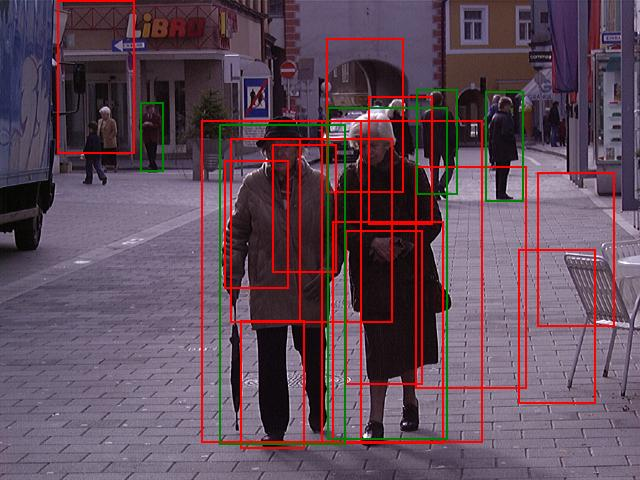

AP@IoU=0.50: 0.2800
AP@IoU=0.55: 0.2800
AP@IoU=0.60: 0.2800
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4000
Recall@IoU=0.55: 0.4000
Recall@IoU=0.60: 0.4000
Recall@IoU=0.65: 0.4000
Recall@IoU=0.70: 0.4000
Recall@IoU=0.75: 0.2000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_134.png (Ảnh thứ 166/288): Precision=0.1333, Recall=0.4000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.1540, mAR@0.5:0.95=0.2200
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


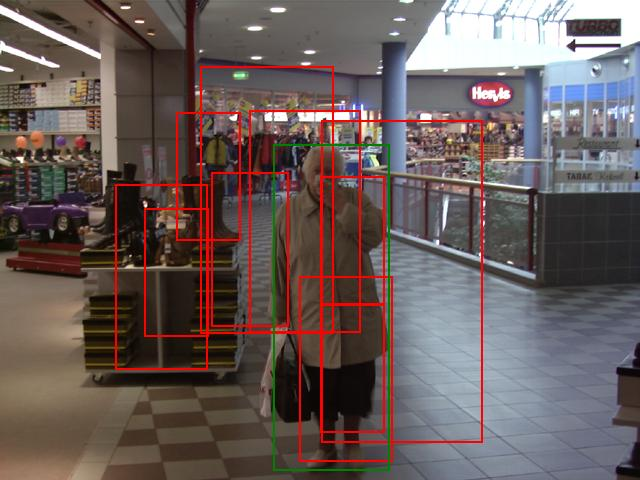

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_055.png (Ảnh thứ 167/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


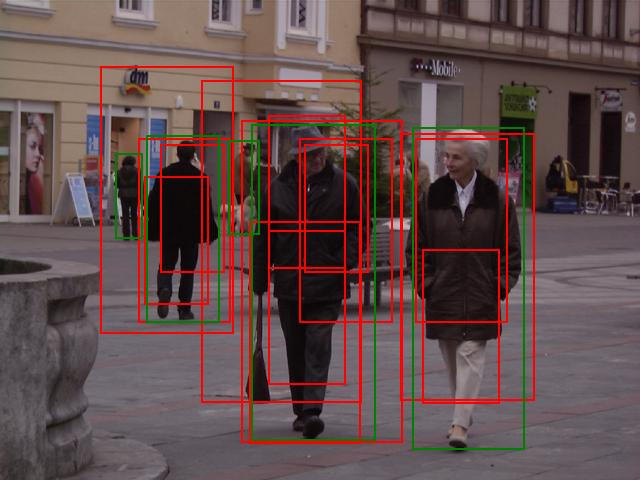

AP@IoU=0.50: 0.4533
AP@IoU=0.55: 0.4533
AP@IoU=0.60: 0.4533
AP@IoU=0.65: 0.4533
AP@IoU=0.70: 0.4533
AP@IoU=0.75: 0.3333
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6000
Recall@IoU=0.55: 0.6000
Recall@IoU=0.60: 0.6000
Recall@IoU=0.65: 0.6000
Recall@IoU=0.70: 0.6000
Recall@IoU=0.75: 0.4000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_230.png (Ảnh thứ 168/288): Precision=0.2143, Recall=0.6000, F1=0.3158, Accuracy=0.1875, mAP@0.5:0.95=0.2600, mAR@0.5:0.95=0.3400
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


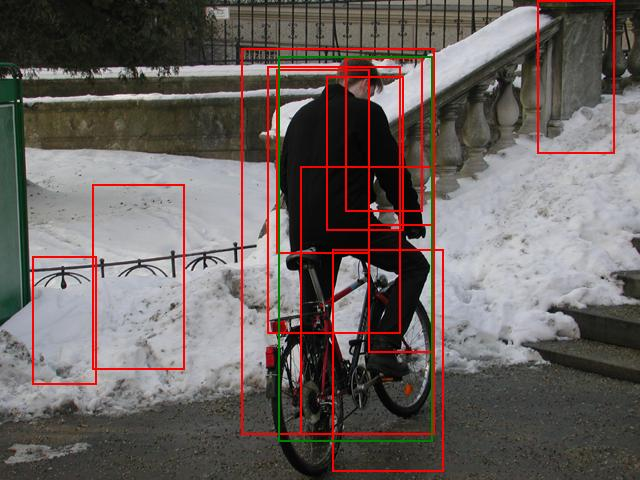

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.1667
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_086.png (Ảnh thứ 169/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.1833, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


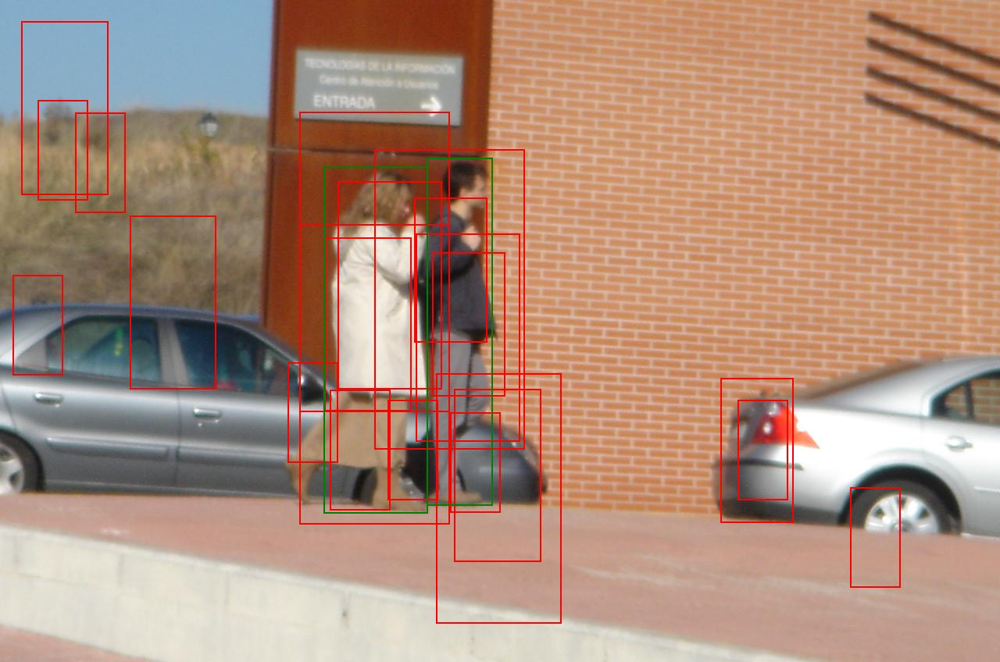

AP@IoU=0.50: 0.0238
AP@IoU=0.55: 0.0238
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001546.png (Ảnh thứ 170/288): Precision=0.0455, Recall=0.5000, F1=0.0833, Accuracy=0.0435, mAP@0.5:0.95=0.0048, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


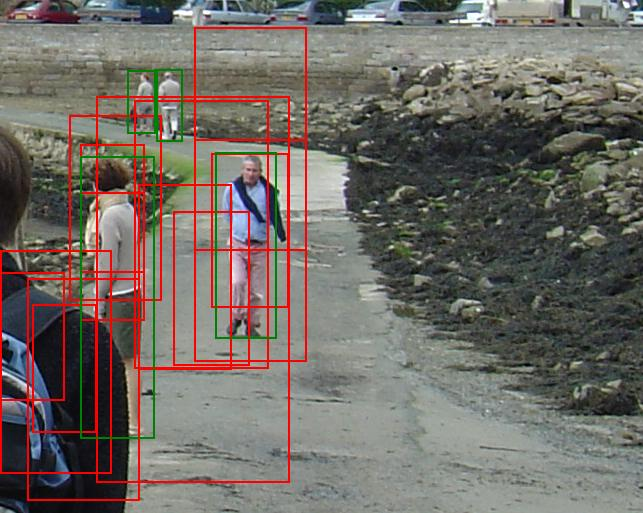

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.2500
Recall@IoU=0.55: 0.2500
Recall@IoU=0.60: 0.2500
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001724.png (Ảnh thứ 171/288): Precision=0.0714, Recall=0.2500, F1=0.1111, Accuracy=0.0588, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


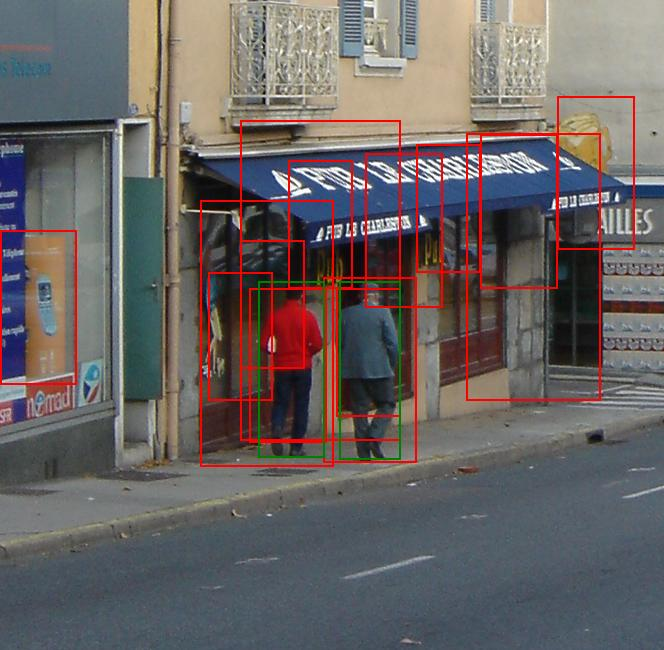

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.6429
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001504.png (Ảnh thứ 172/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.4643, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


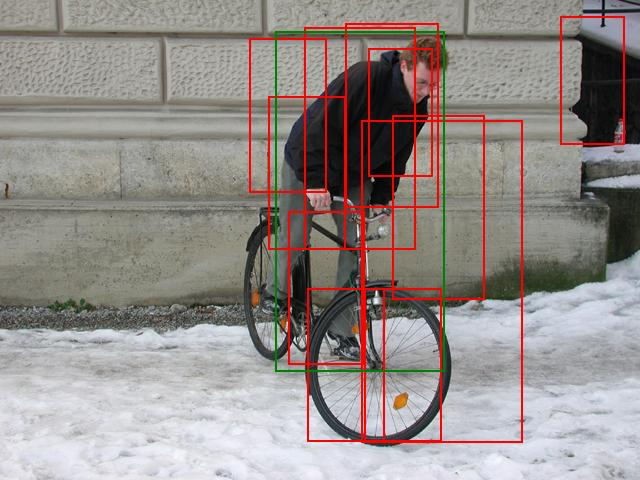

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_103.png (Ảnh thứ 173/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


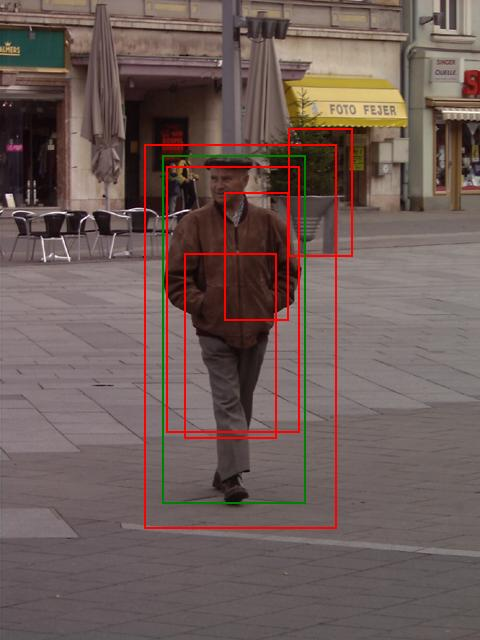

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_011.png (Ảnh thứ 174/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


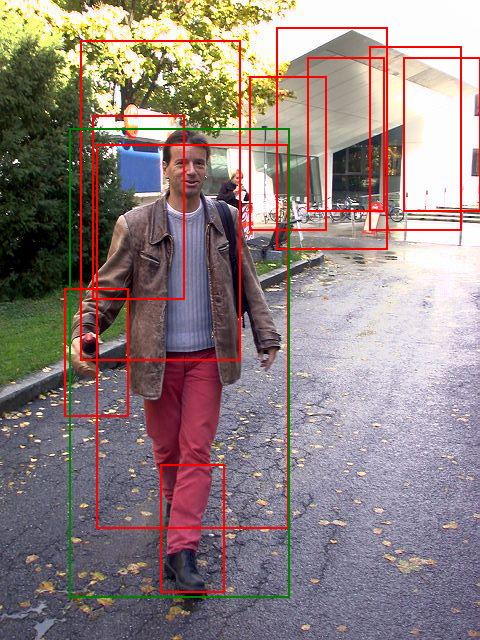

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_177.png (Ảnh thứ 175/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.1667, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


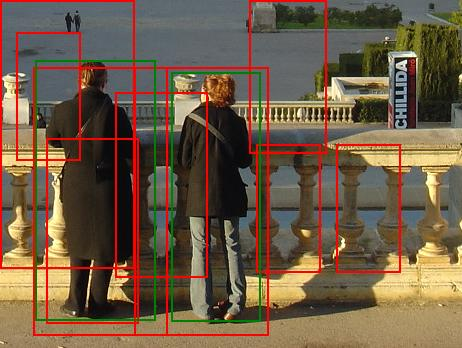

AP@IoU=0.50: 0.3250
AP@IoU=0.55: 0.3250
AP@IoU=0.60: 0.3250
AP@IoU=0.65: 0.1250
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.1250
AP@IoU=0.80: 0.1250
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.5000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000005.png (Ảnh thứ 176/288): Precision=0.2222, Recall=1.0000, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.1475, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


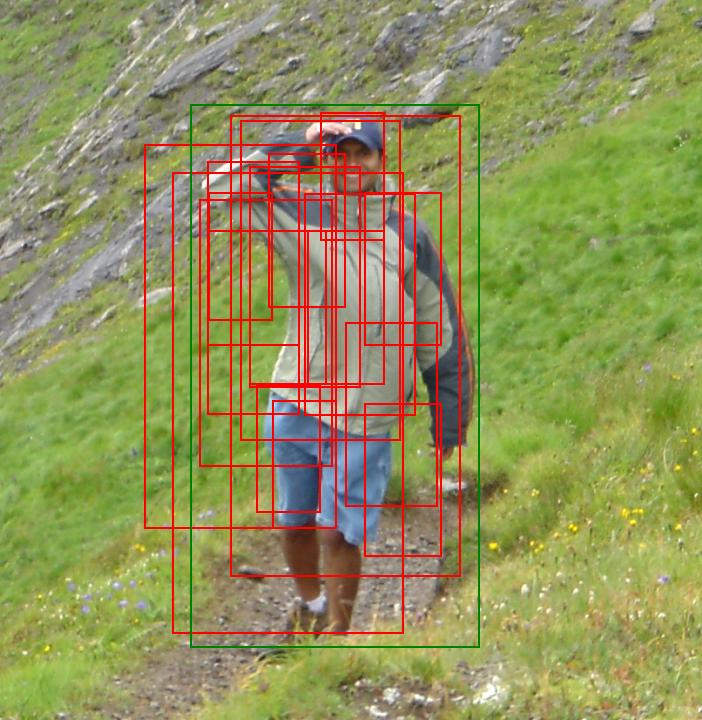

AP@IoU=0.50: 0.1429
AP@IoU=0.55: 0.1429
AP@IoU=0.60: 0.0833
AP@IoU=0.65: 0.0833
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000015.png (Ảnh thứ 177/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.0452, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


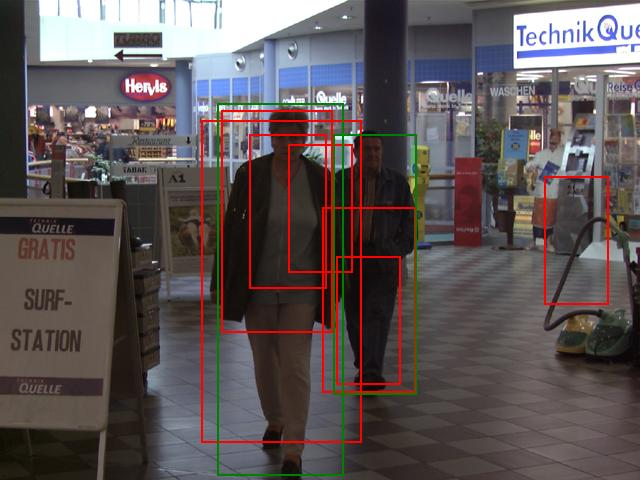

AP@IoU=0.50: 0.3667
AP@IoU=0.55: 0.3667
AP@IoU=0.60: 0.3667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_218.png (Ảnh thứ 178/288): Precision=0.2857, Recall=1.0000, F1=0.4444, Accuracy=0.2857, mAP@0.5:0.95=0.1433, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


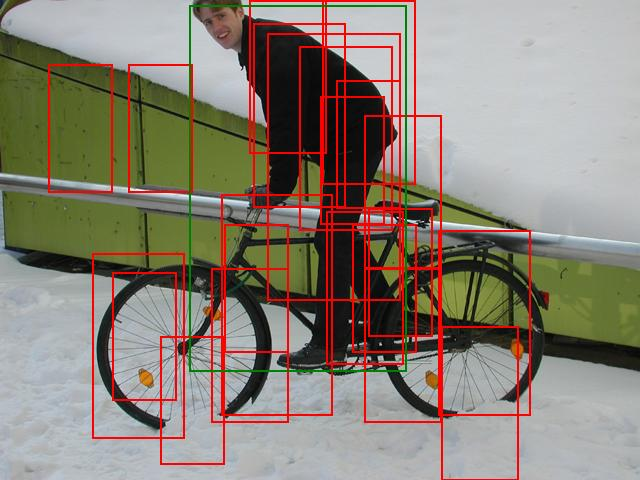

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_108.png (Ảnh thứ 179/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


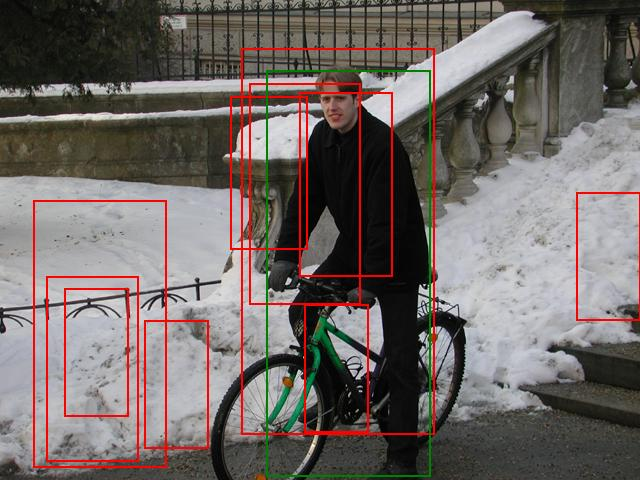

AP@IoU=0.50: 0.2000
AP@IoU=0.55: 0.2000
AP@IoU=0.60: 0.2000
AP@IoU=0.65: 0.2000
AP@IoU=0.70: 0.2000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_085.png (Ảnh thứ 180/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


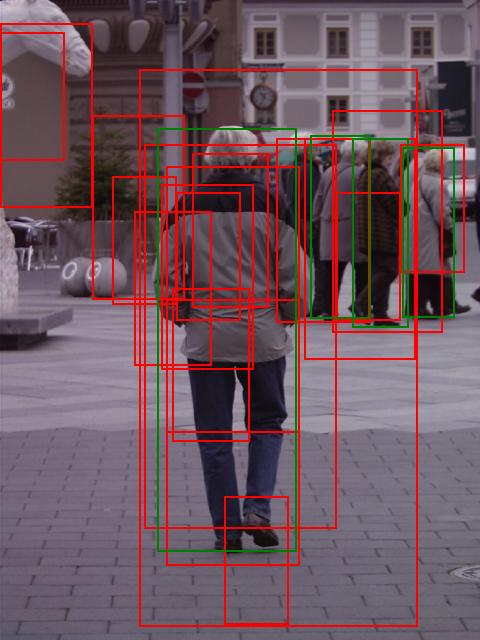

AP@IoU=0.50: 0.3420
AP@IoU=0.55: 0.3420
AP@IoU=0.60: 0.3420
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.7500
Recall@IoU=0.55: 0.7500
Recall@IoU=0.60: 0.7500
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_088.png (Ảnh thứ 181/288): Precision=0.1579, Recall=0.7500, F1=0.2609, Accuracy=0.1500, mAP@0.5:0.95=0.1276, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


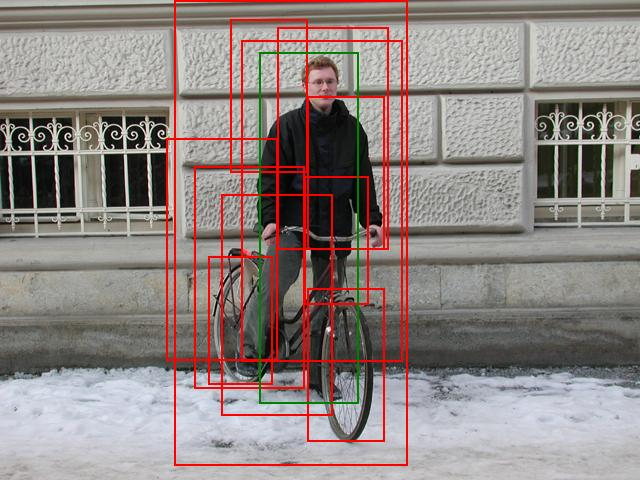

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_059.png (Ảnh thứ 182/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.0500, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


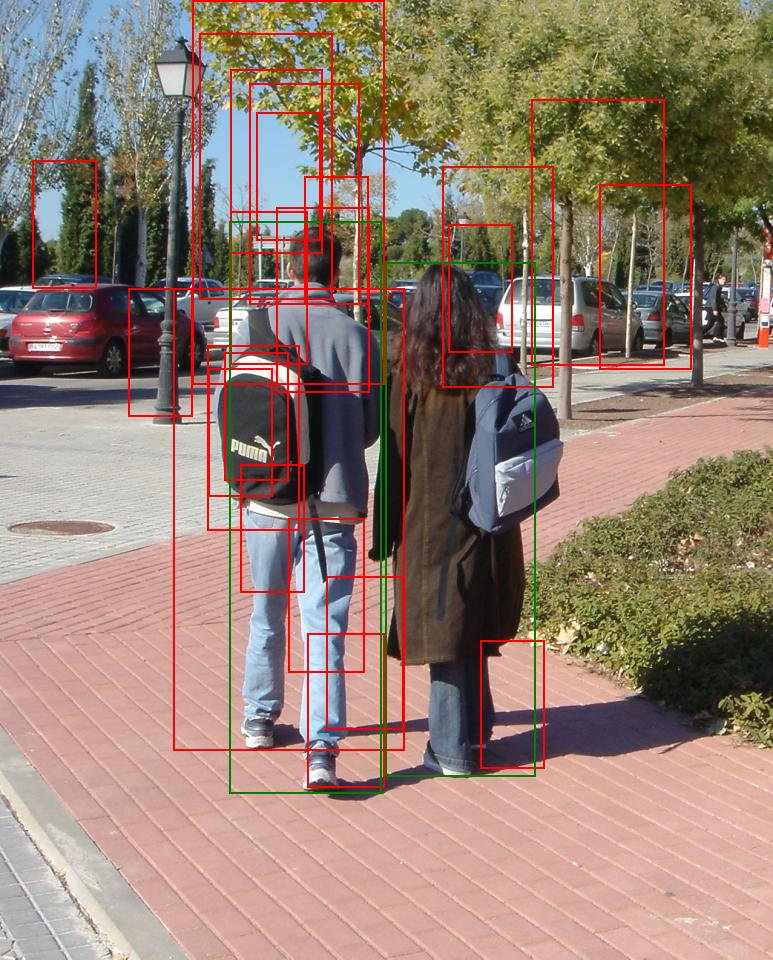

AP@IoU=0.50: 0.0625
AP@IoU=0.55: 0.0625
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001544.png (Ảnh thứ 183/288): Precision=0.0435, Recall=0.5000, F1=0.0800, Accuracy=0.0417, mAP@0.5:0.95=0.0125, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


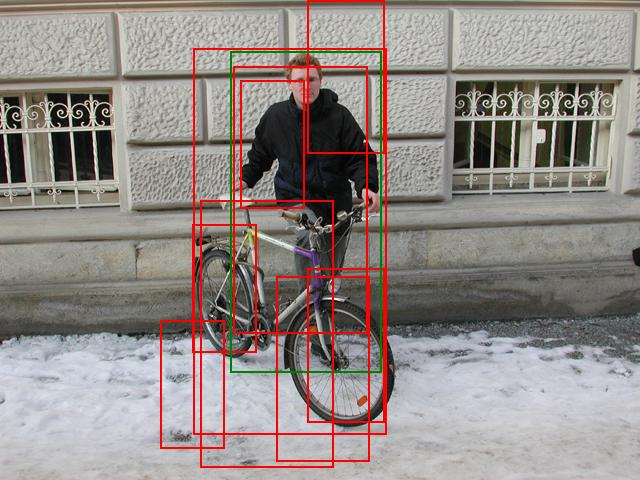

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_067.png (Ảnh thứ 184/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


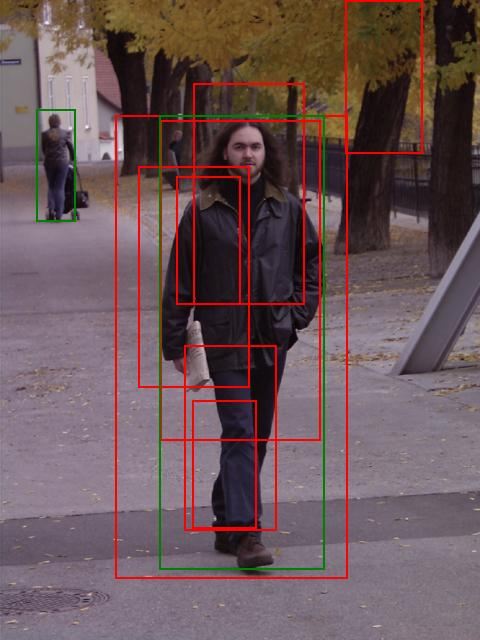

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_014.png (Ảnh thứ 185/288): Precision=0.1250, Recall=0.5000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


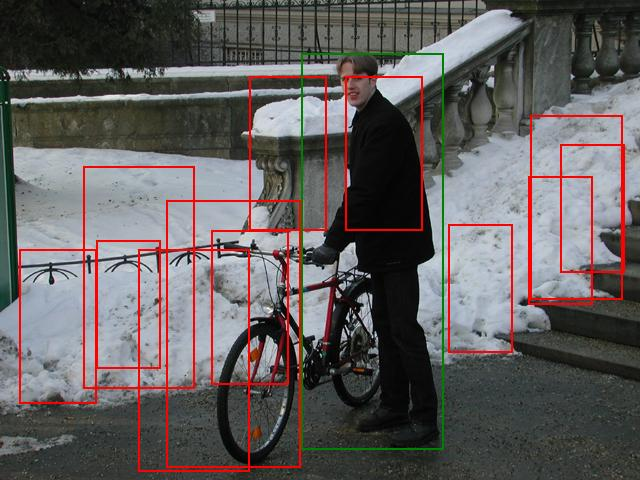

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_088.png (Ảnh thứ 186/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


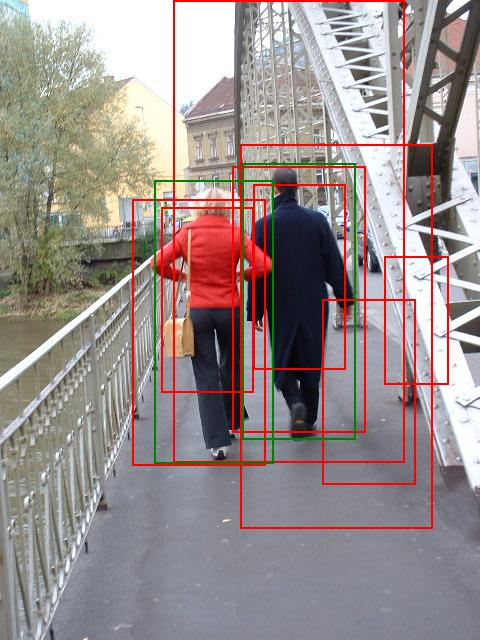

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.7500
AP@IoU=0.60: 0.7500
AP@IoU=0.65: 0.7500
AP@IoU=0.70: 0.7500
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.5000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.5000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_120.png (Ảnh thứ 187/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.4833, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


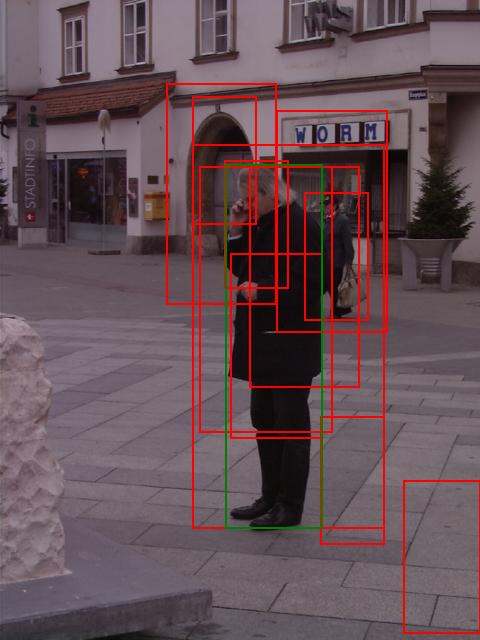

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_090.png (Ảnh thứ 188/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


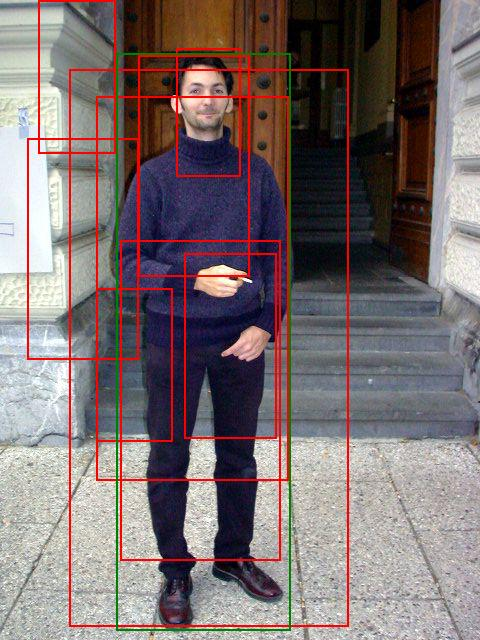

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_034.png (Ảnh thứ 189/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


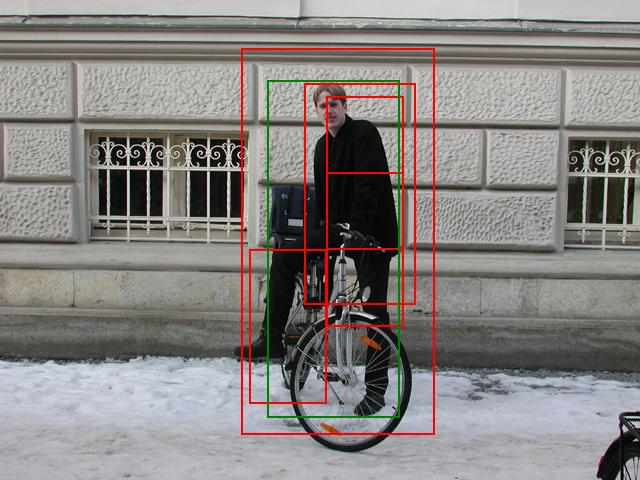

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_051.png (Ảnh thứ 190/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


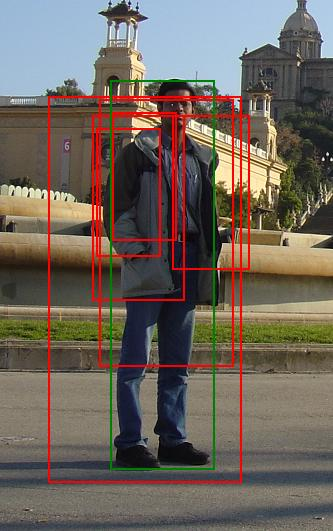

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000002.png (Ảnh thứ 191/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.1333, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


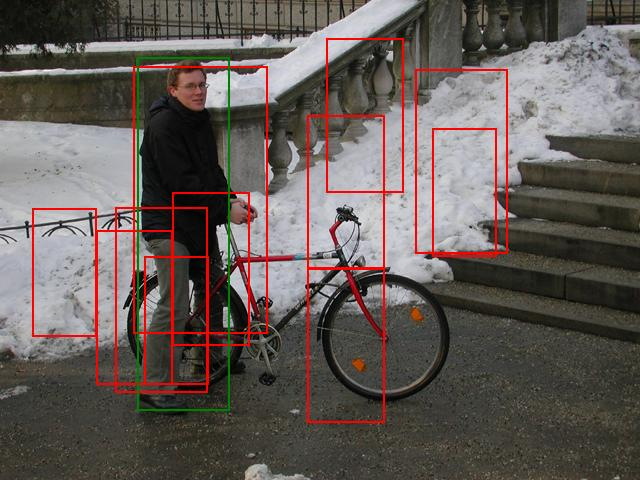

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_090.png (Ảnh thứ 192/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.0500, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


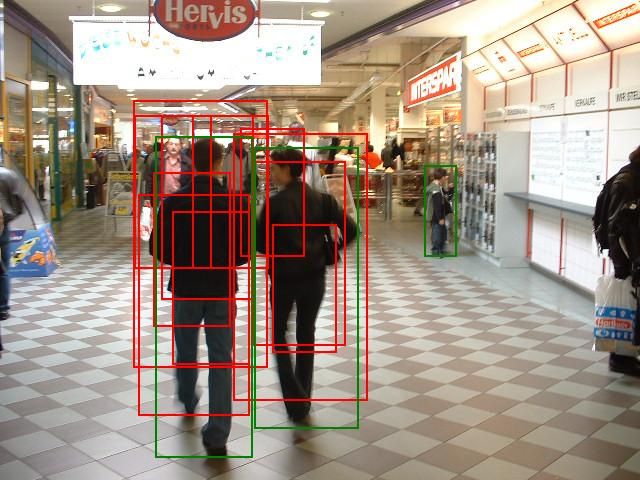

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.4074
AP@IoU=0.60: 0.1111
AP@IoU=0.65: 0.1111
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_306.png (Ảnh thứ 193/288): Precision=0.1818, Recall=0.6667, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.1296, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


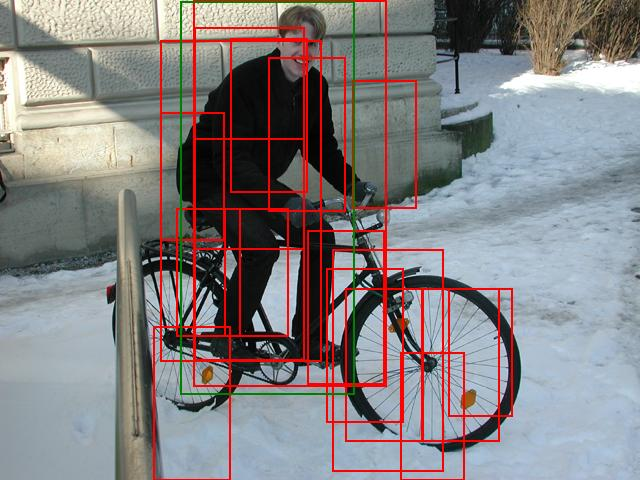

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_113.png (Ảnh thứ 194/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


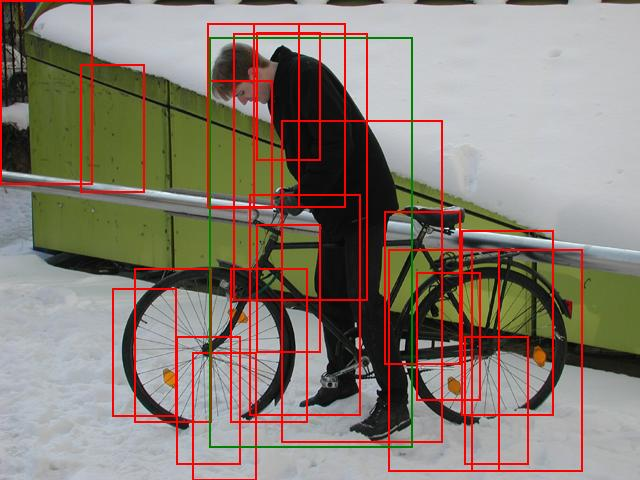

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_107.png (Ảnh thứ 195/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


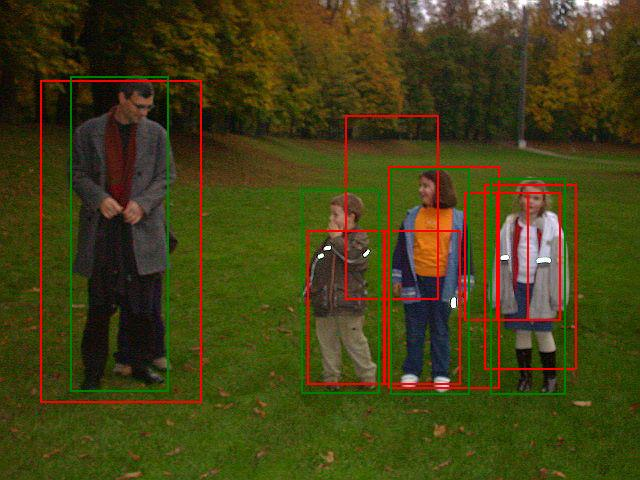

AP@IoU=0.50: 0.7679
AP@IoU=0.55: 0.5179
AP@IoU=0.60: 0.3438
AP@IoU=0.65: 0.3438
AP@IoU=0.70: 0.0625
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.7500
Recall@IoU=0.65: 0.7500
Recall@IoU=0.70: 0.2500
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_265.png (Ảnh thứ 196/288): Precision=0.5000, Recall=1.0000, F1=0.6667, Accuracy=0.5000, mAP@0.5:0.95=0.2036, mAR@0.5:0.95=0.3750
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


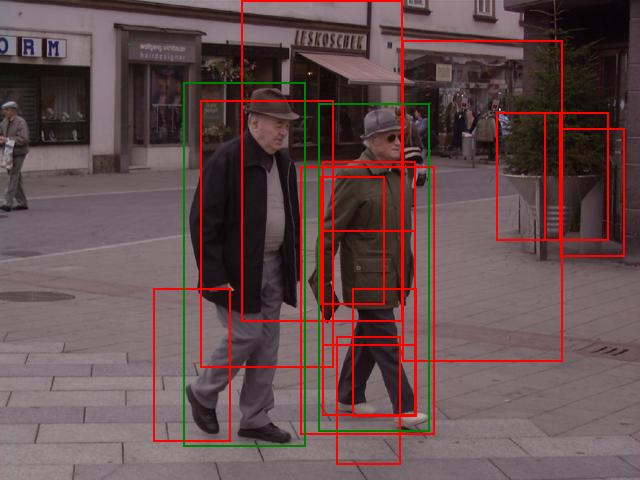

AP@IoU=0.50: 0.6000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_198.png (Ảnh thứ 197/288): Precision=0.1538, Recall=1.0000, F1=0.2667, Accuracy=0.1538, mAP@0.5:0.95=0.2100, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


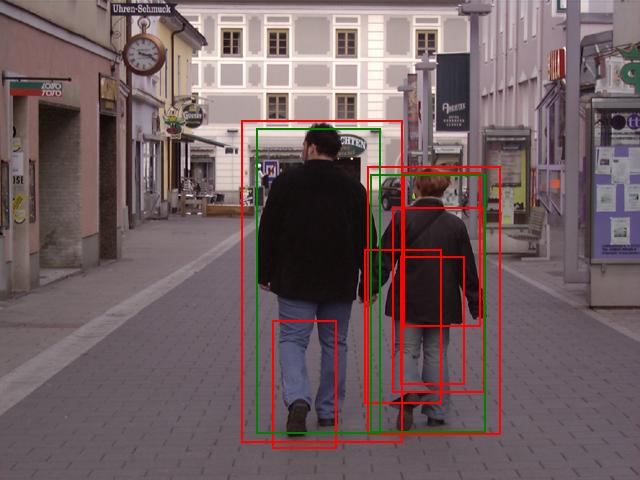

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.5000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.5000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_248.png (Ảnh thứ 198/288): Precision=0.2857, Recall=1.0000, F1=0.4444, Accuracy=0.2857, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


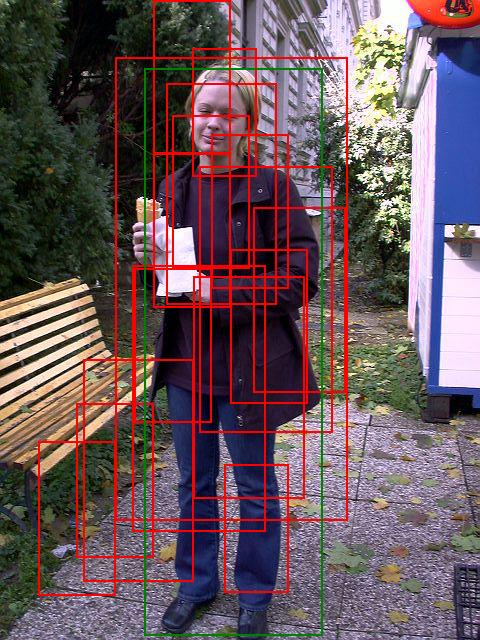

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_028.png (Ảnh thứ 199/288): Precision=0.0588, Recall=1.0000, F1=0.1111, Accuracy=0.0588, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


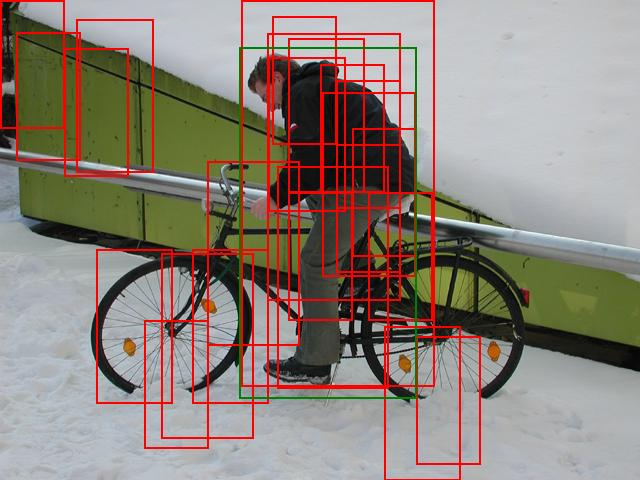

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_106.png (Ảnh thứ 200/288): Precision=0.0417, Recall=1.0000, F1=0.0800, Accuracy=0.0417, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


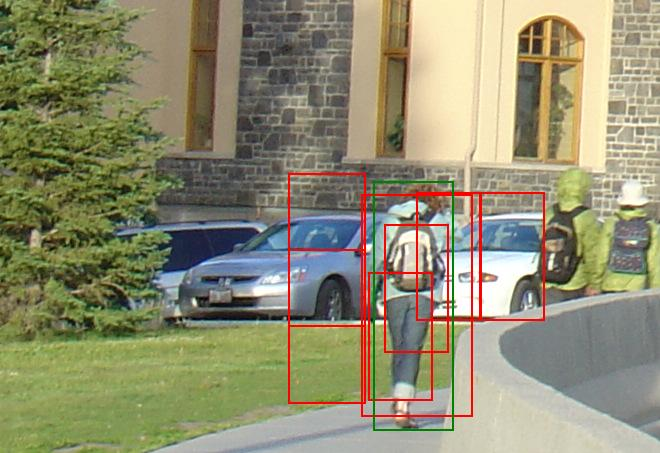

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001723.png (Ảnh thứ 201/288): Precision=0.1429, Recall=1.0000, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


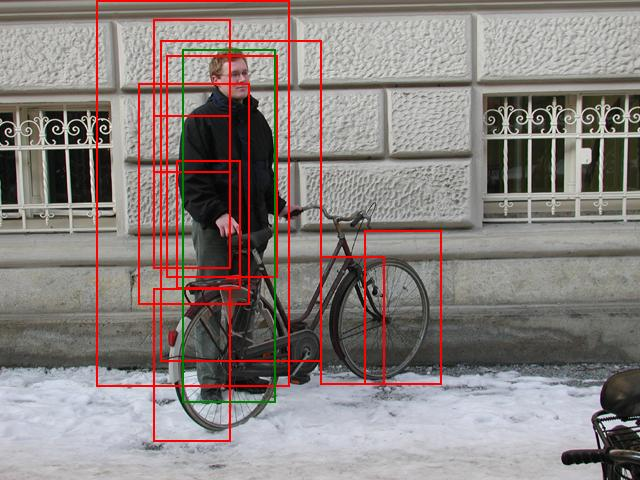

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_058.png (Ảnh thứ 202/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


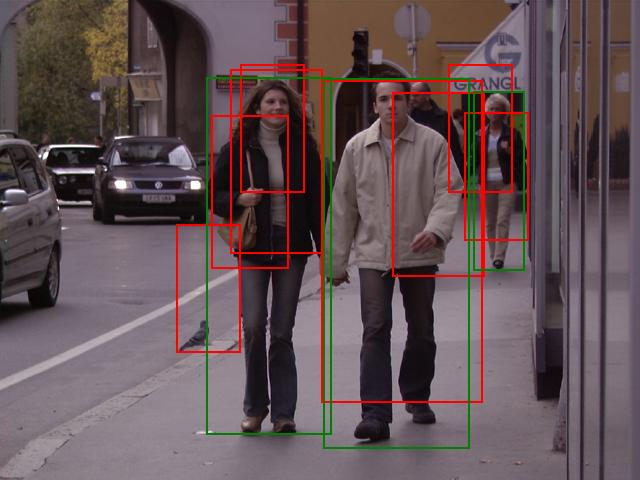

AP@IoU=0.50: 0.2063
AP@IoU=0.55: 0.2063
AP@IoU=0.60: 0.2063
AP@IoU=0.65: 0.1111
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_251.png (Ảnh thứ 203/288): Precision=0.2500, Recall=0.6667, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.0952, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


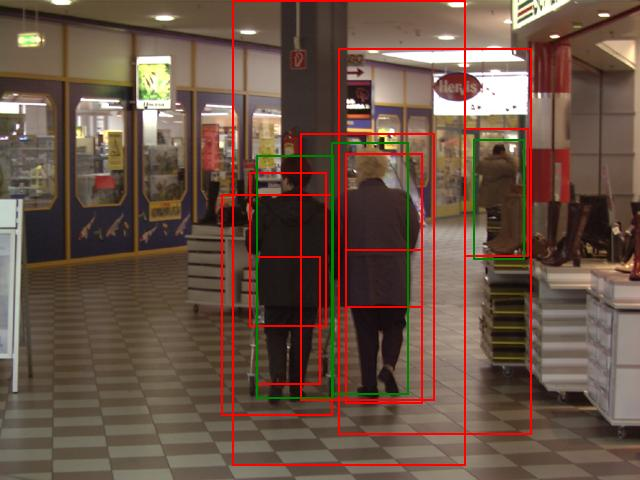

AP@IoU=0.50: 0.6389
AP@IoU=0.55: 0.3889
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_210.png (Ảnh thứ 204/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.1528, mAR@0.5:0.95=0.2667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


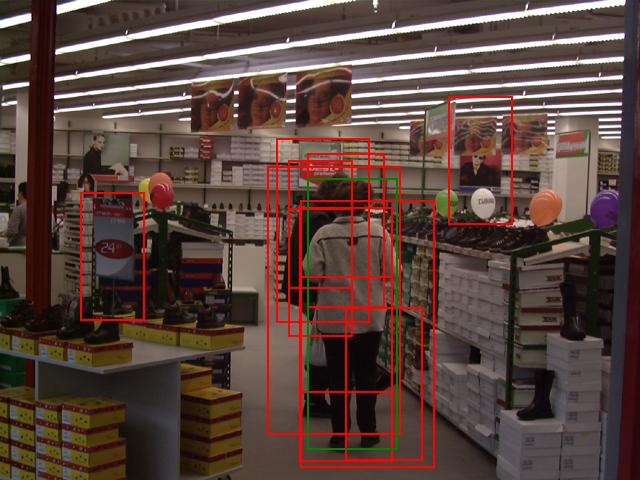

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_206.png (Ảnh thứ 205/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.2500, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


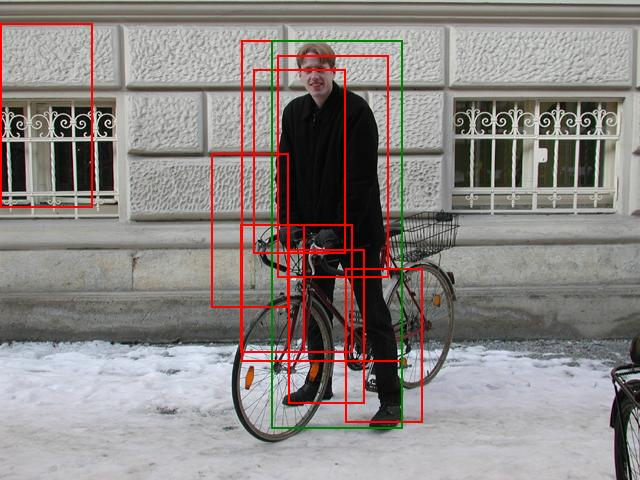

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_062.png (Ảnh thứ 206/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


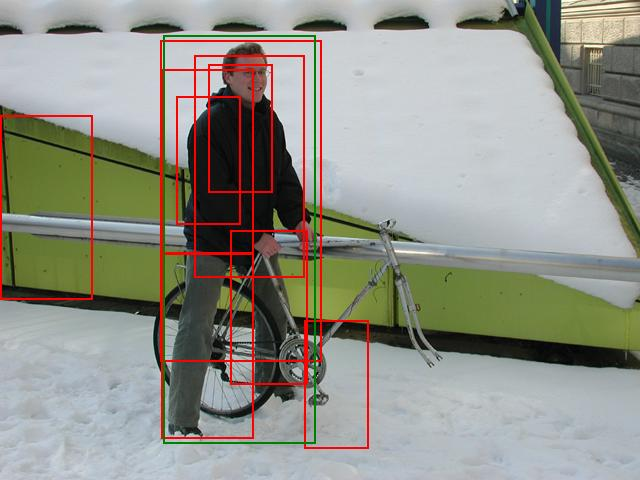

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_163.png (Ảnh thứ 207/288): Precision=0.1111, Recall=1.0000, F1=0.2000, Accuracy=0.1111, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


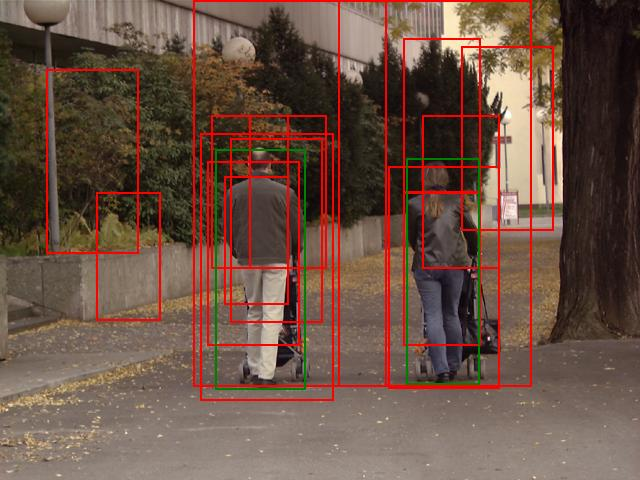

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.2917
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_255.png (Ảnh thứ 208/288): Precision=0.1333, Recall=1.0000, F1=0.2353, Accuracy=0.1333, mAP@0.5:0.95=0.3292, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


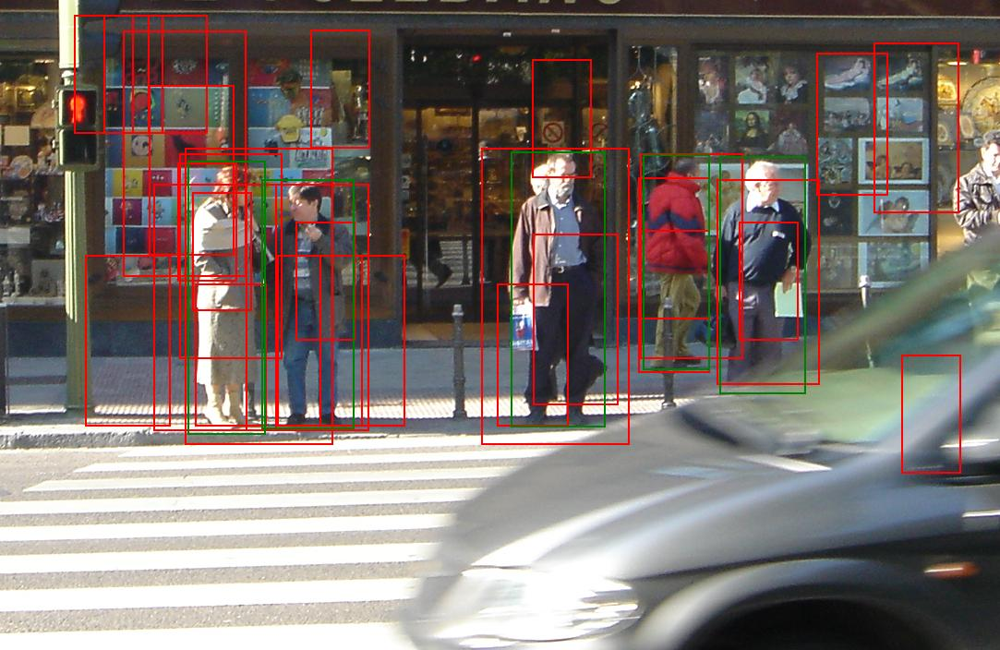

AP@IoU=0.50: 0.5714
AP@IoU=0.55: 0.5714
AP@IoU=0.60: 0.3095
AP@IoU=0.65: 0.2286
AP@IoU=0.70: 0.2286
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.6000
Recall@IoU=0.65: 0.4000
Recall@IoU=0.70: 0.4000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001682.png (Ảnh thứ 209/288): Precision=0.1724, Recall=1.0000, F1=0.2941, Accuracy=0.1724, mAP@0.5:0.95=0.1910, mAR@0.5:0.95=0.3400
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


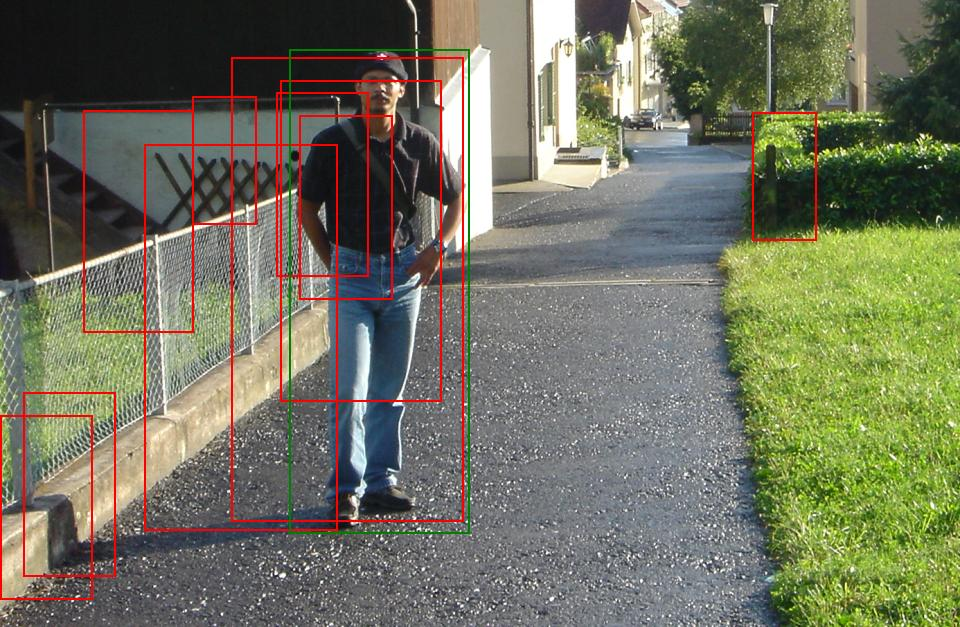

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.1667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000021.png (Ảnh thứ 210/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.1667, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


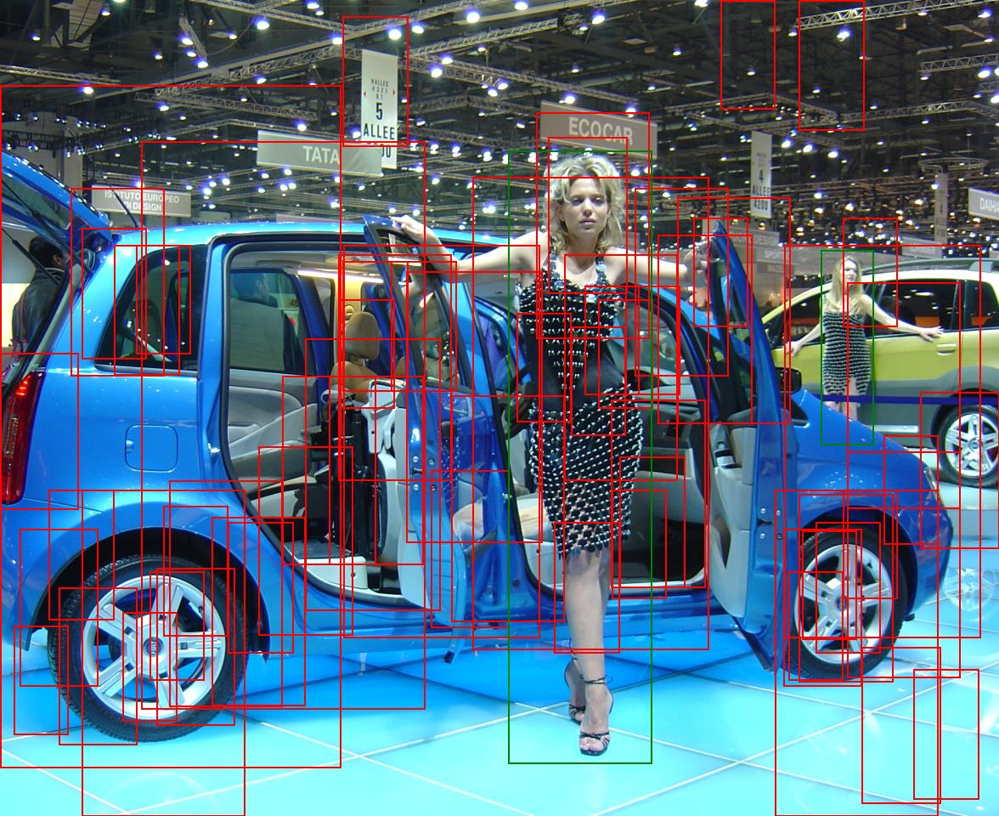

AP@IoU=0.50: 0.0111
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001688.png (Ảnh thứ 211/288): Precision=0.0152, Recall=0.5000, F1=0.0294, Accuracy=0.0149, mAP@0.5:0.95=0.0011, mAR@0.5:0.95=0.0500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


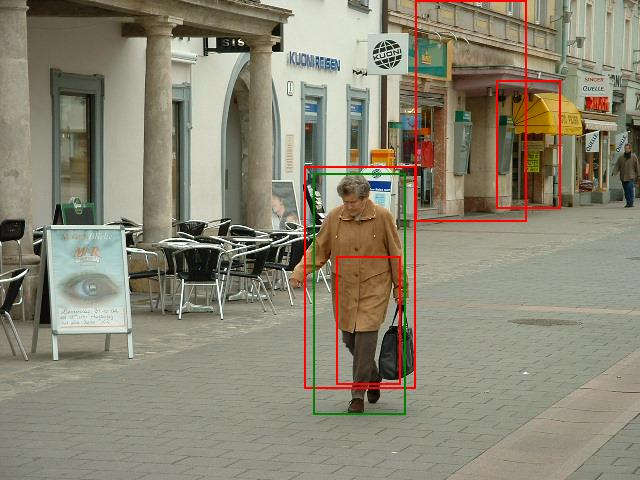

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_063.png (Ảnh thứ 212/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


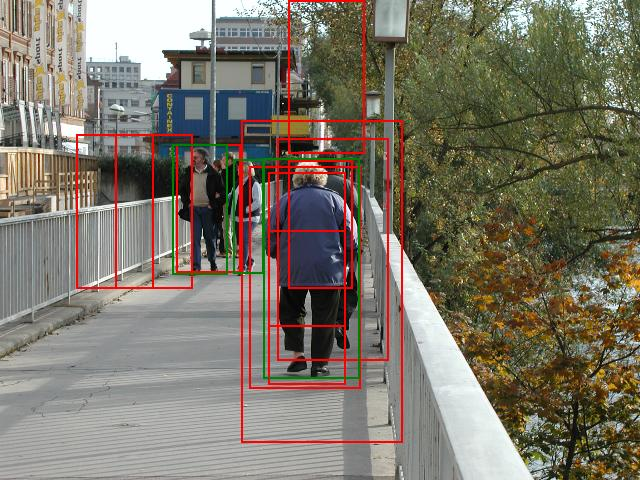

AP@IoU=0.50: 0.4000
AP@IoU=0.55: 0.4000
AP@IoU=0.60: 0.4000
AP@IoU=0.65: 0.4000
AP@IoU=0.70: 0.4000
AP@IoU=0.75: 0.3333
AP@IoU=0.80: 0.3333
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.6667
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.3333
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_335.png (Ảnh thứ 213/288): Precision=0.2000, Recall=0.6667, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.2667, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


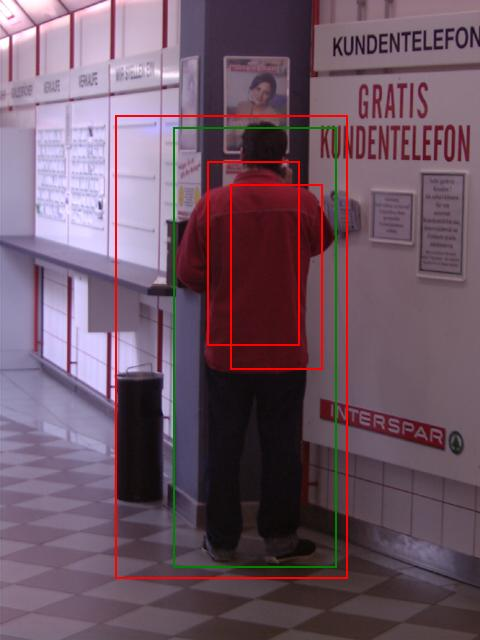

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_094.png (Ảnh thứ 214/288): Precision=0.3333, Recall=1.0000, F1=0.5000, Accuracy=0.3333, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


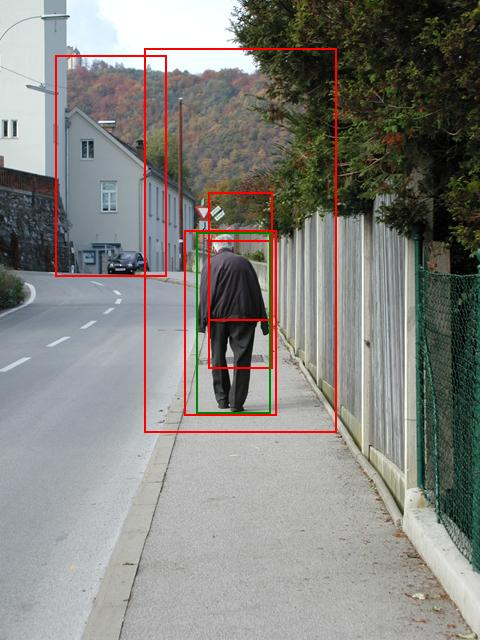

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_039.png (Ảnh thứ 215/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.6000, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


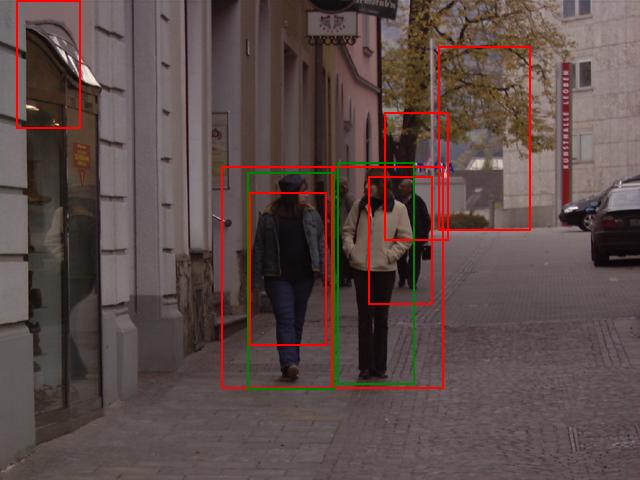

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.6667
AP@IoU=0.60: 0.6667
AP@IoU=0.65: 0.2917
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_186.png (Ảnh thứ 216/288): Precision=0.2857, Recall=1.0000, F1=0.4444, Accuracy=0.2857, mAP@0.5:0.95=0.2417, mAR@0.5:0.95=0.4500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


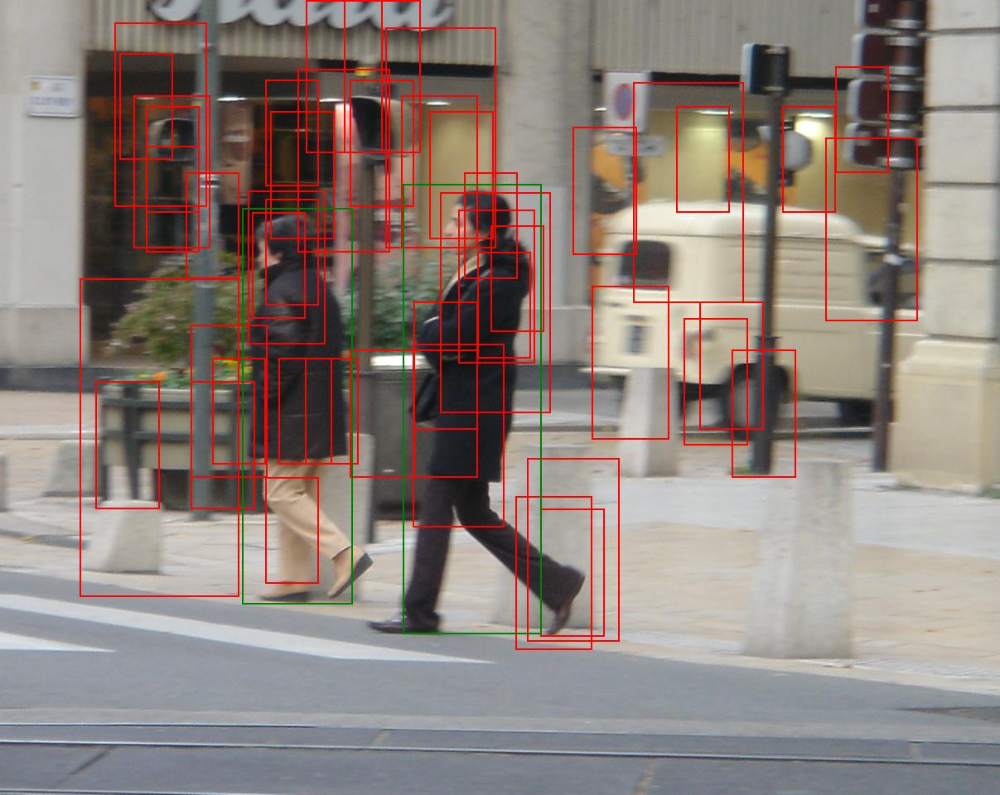

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001520.png (Ảnh thứ 217/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


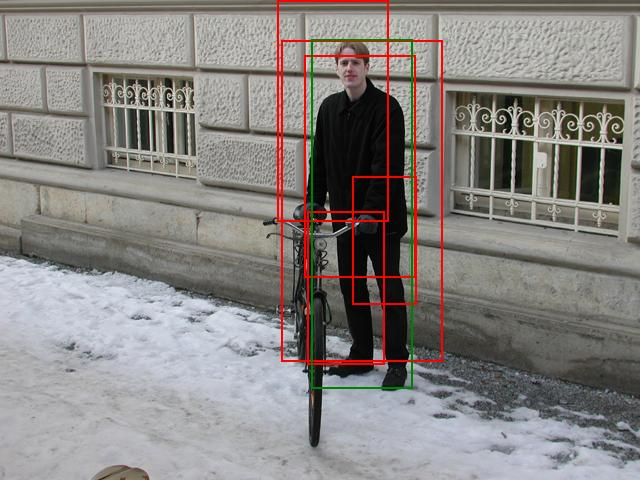

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_043.png (Ảnh thứ 218/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


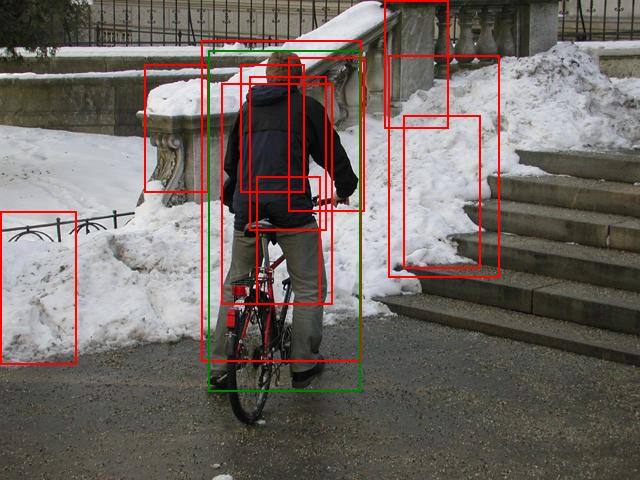

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_089.png (Ảnh thứ 219/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


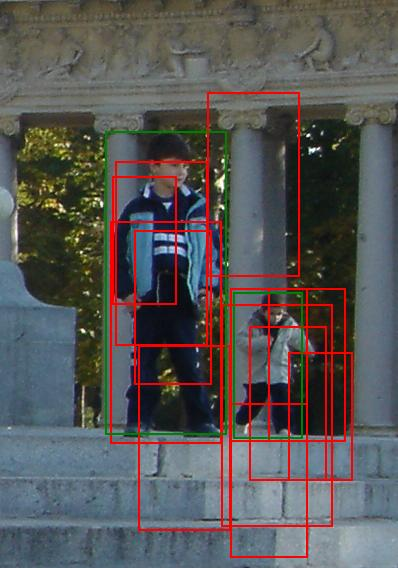

AP@IoU=0.50: 0.7500
AP@IoU=0.55: 0.7500
AP@IoU=0.60: 0.7500
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.5000
AP@IoU=0.80: 0.5000
AP@IoU=0.85: 0.5000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.5000
Recall@IoU=0.85: 0.5000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001566.png (Ảnh thứ 220/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.4750, mAR@0.5:0.95=0.5500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


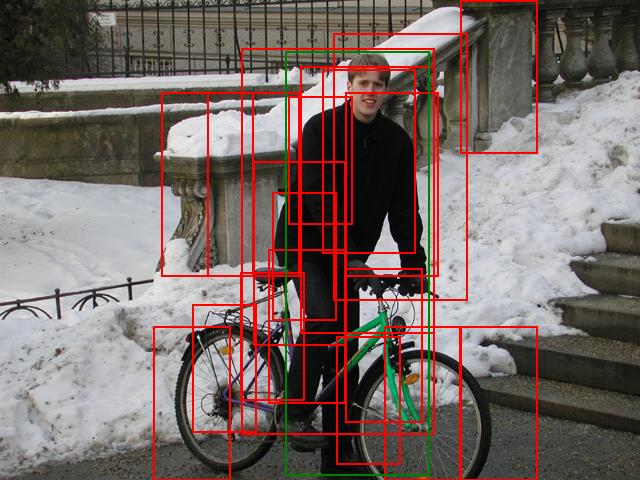

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_084.png (Ảnh thứ 221/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.1333, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


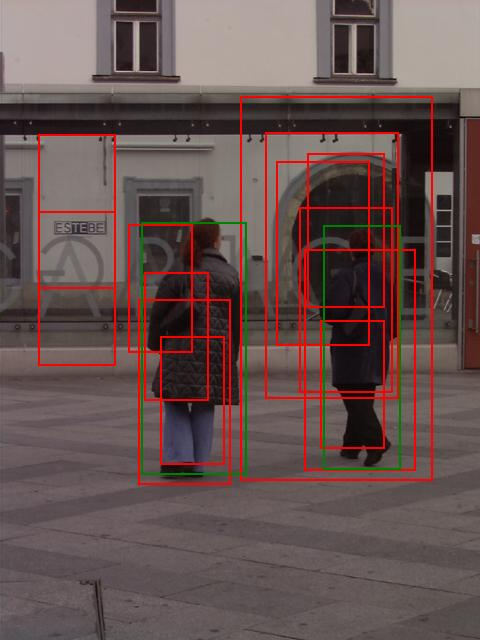

AP@IoU=0.50: 0.6000
AP@IoU=0.55: 0.6000
AP@IoU=0.60: 0.0500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_100.png (Ảnh thứ 222/288): Precision=0.1538, Recall=1.0000, F1=0.2667, Accuracy=0.1538, mAP@0.5:0.95=0.1250, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


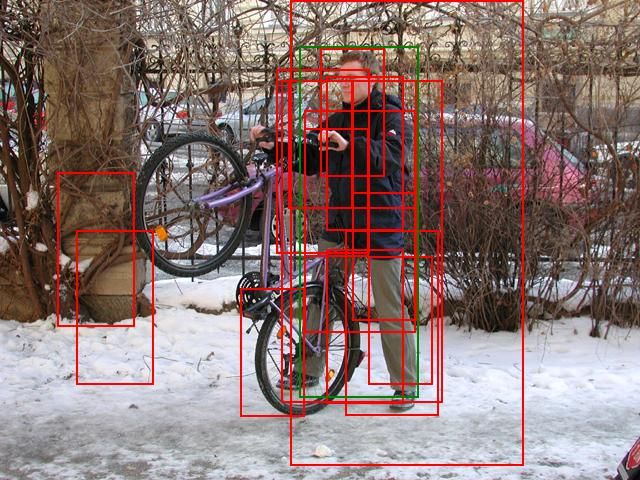

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_042.png (Ảnh thứ 223/288): Precision=0.0625, Recall=1.0000, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


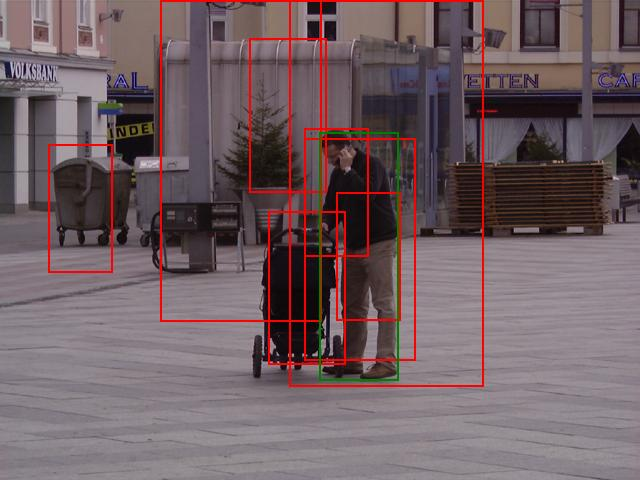

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_058.png (Ảnh thứ 224/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


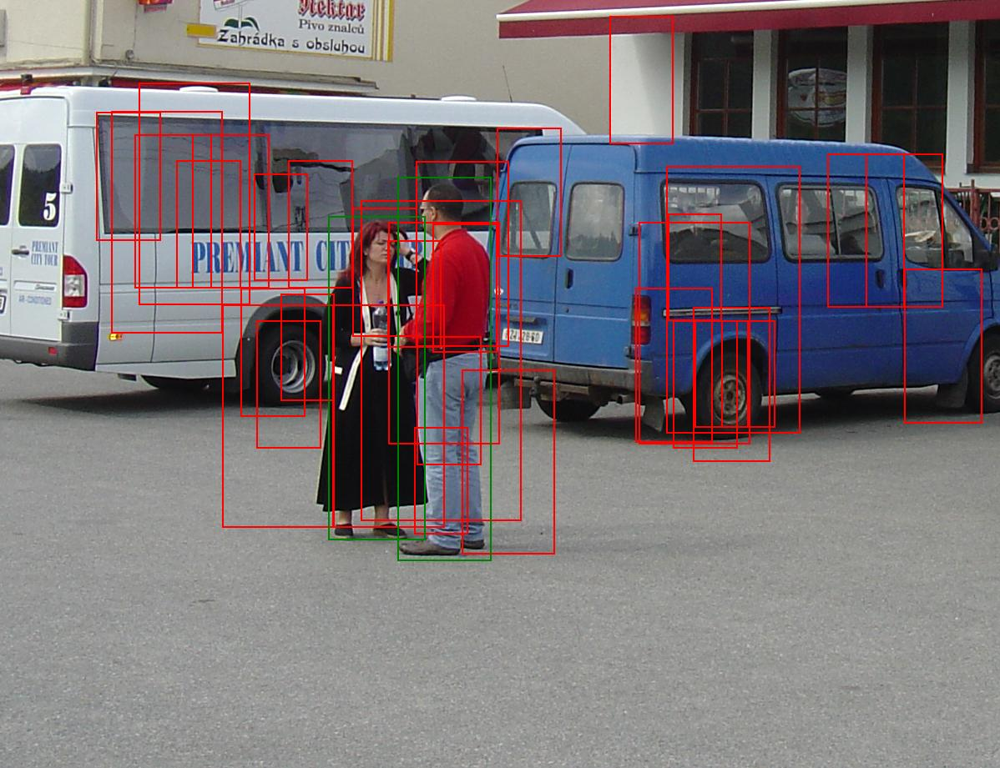

AP@IoU=0.50: 0.2955
AP@IoU=0.55: 0.0227
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001715.png (Ảnh thứ 225/288): Precision=0.0571, Recall=1.0000, F1=0.1081, Accuracy=0.0571, mAP@0.5:0.95=0.0318, mAR@0.5:0.95=0.1500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


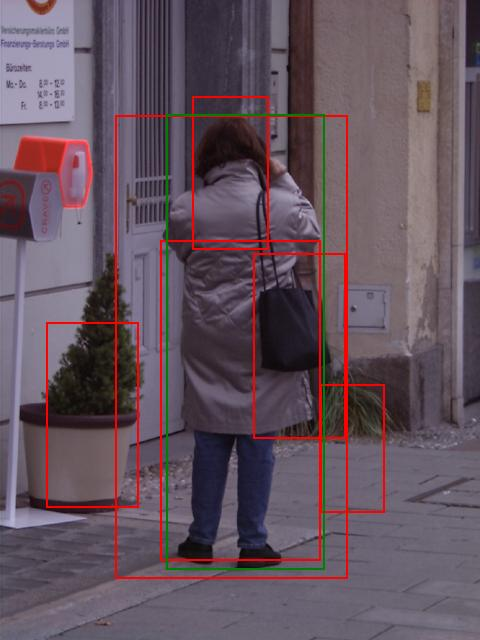

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_008.png (Ảnh thứ 226/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


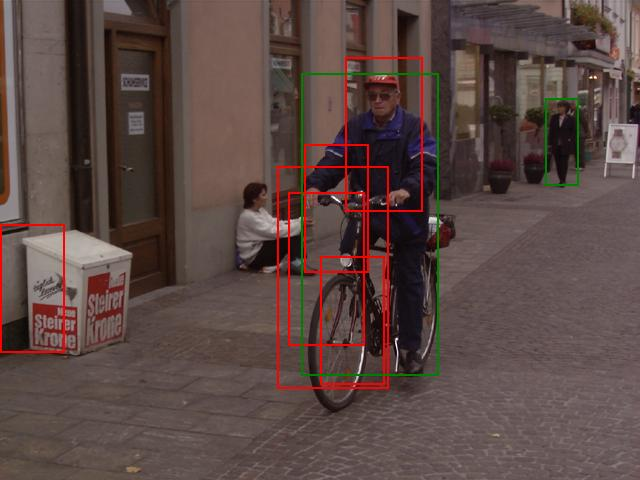

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_014.png (Ảnh thứ 227/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


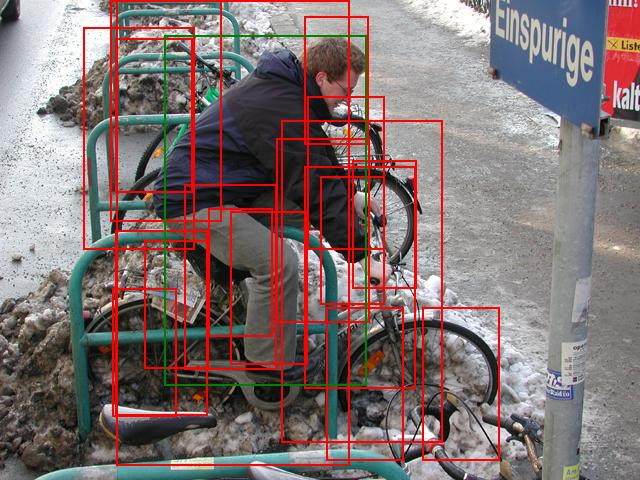

AP@IoU=0.50: 0.2000
AP@IoU=0.55: 0.2000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_091.png (Ảnh thứ 228/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.0400, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


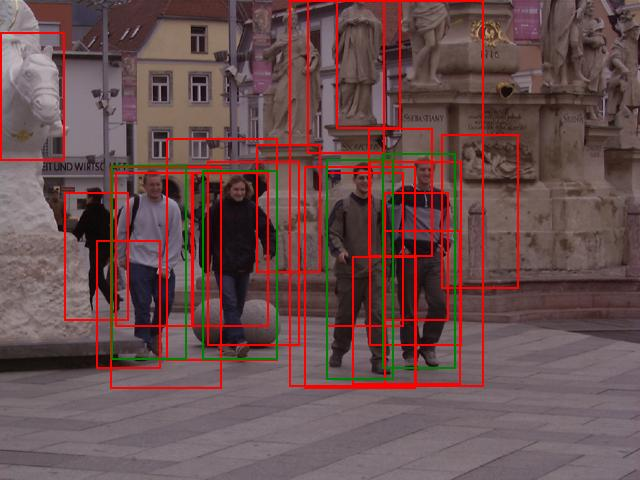

AP@IoU=0.50: 0.8750
AP@IoU=0.55: 0.8750
AP@IoU=0.60: 0.6562
AP@IoU=0.65: 0.2708
AP@IoU=0.70: 0.1875
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.7500
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_136.png (Ảnh thứ 229/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.2865, mAR@0.5:0.95=0.4250
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


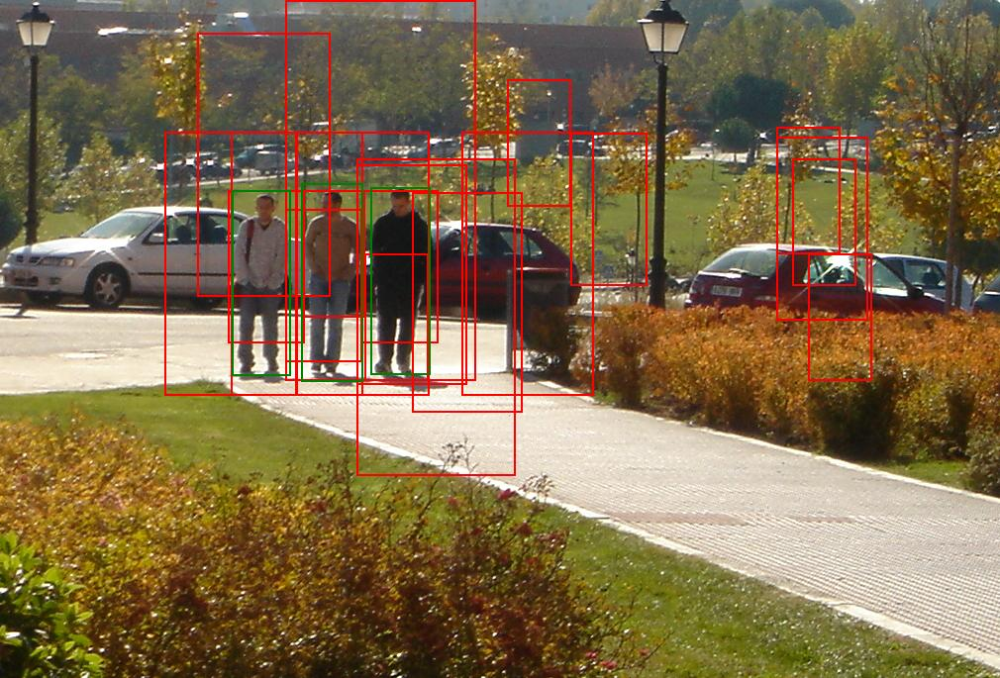

AP@IoU=0.50: 0.6111
AP@IoU=0.55: 0.6111
AP@IoU=0.60: 0.6111
AP@IoU=0.65: 0.4074
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001658.png (Ảnh thứ 230/288): Precision=0.1500, Recall=1.0000, F1=0.2609, Accuracy=0.1500, mAP@0.5:0.95=0.2241, mAR@0.5:0.95=0.3667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


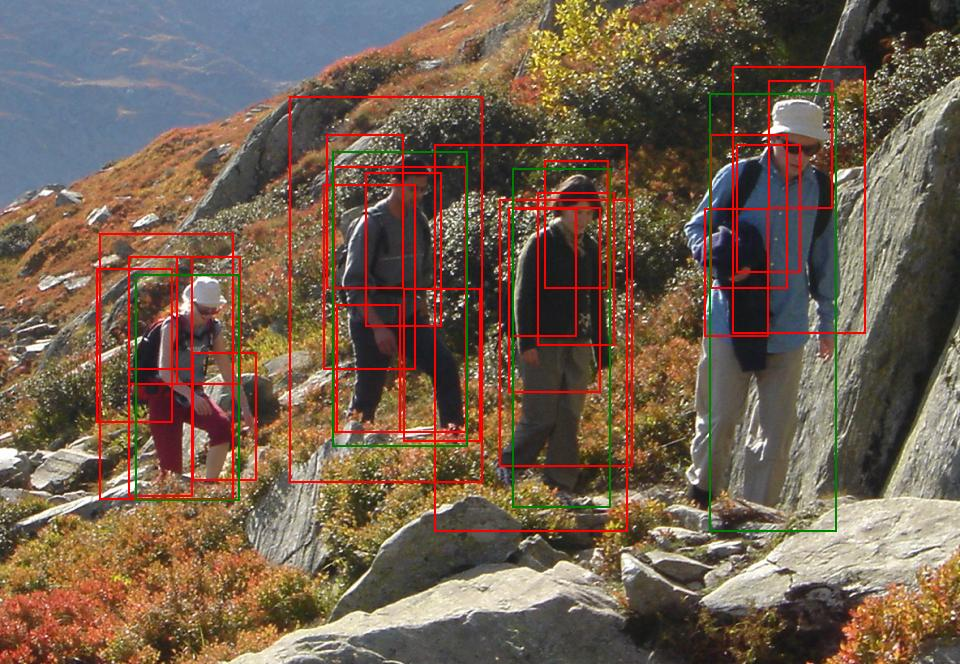

AP@IoU=0.50: 0.5104
AP@IoU=0.55: 0.5104
AP@IoU=0.60: 0.4167
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.2500
AP@IoU=0.80: 0.2500
AP@IoU=0.85: 0.2500
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.7500
Recall@IoU=0.55: 0.7500
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.2500
Recall@IoU=0.70: 0.2500
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.2500
Recall@IoU=0.85: 0.2500
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000026.png (Ảnh thứ 231/288): Precision=0.1250, Recall=0.7500, F1=0.2143, Accuracy=0.1200, mAP@0.5:0.95=0.2687, mAR@0.5:0.95=0.3250
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


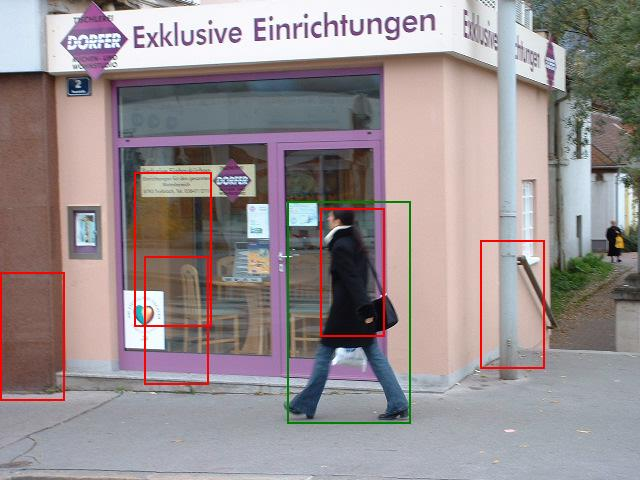

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_073.png (Ảnh thứ 232/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


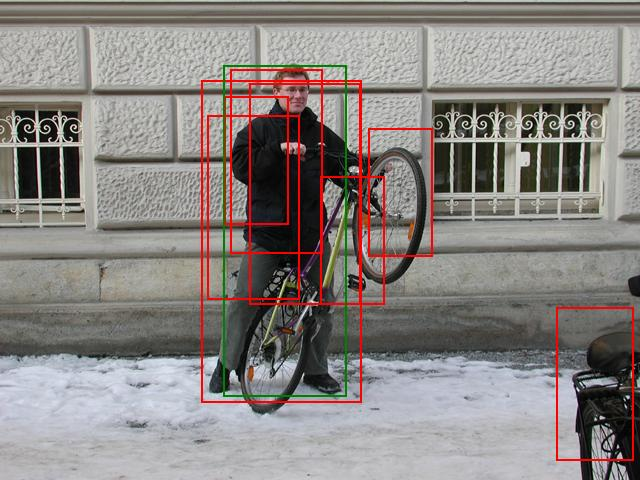

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_055.png (Ảnh thứ 233/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


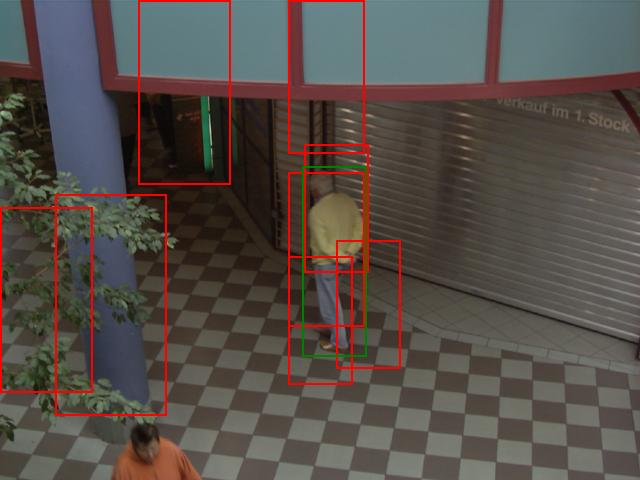

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_212.png (Ảnh thứ 234/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


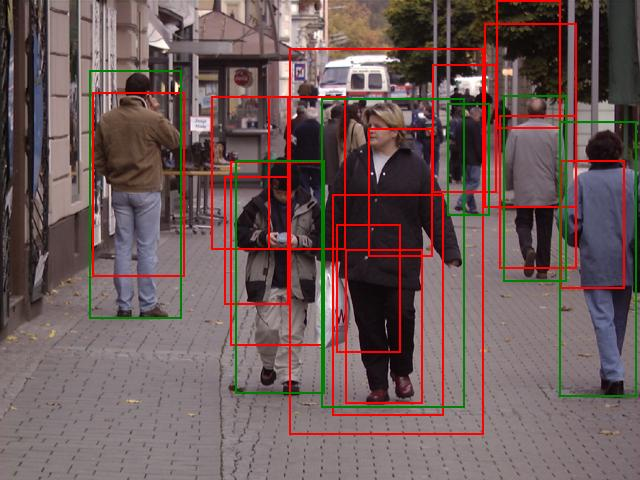

AP@IoU=0.50: 0.5606
AP@IoU=0.55: 0.4634
AP@IoU=0.60: 0.3232
AP@IoU=0.65: 0.3232
AP@IoU=0.70: 0.1970
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_204.png (Ảnh thứ 235/288): Precision=0.2667, Recall=0.6667, F1=0.3810, Accuracy=0.2353, mAP@0.5:0.95=0.1867, mAR@0.5:0.95=0.2667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


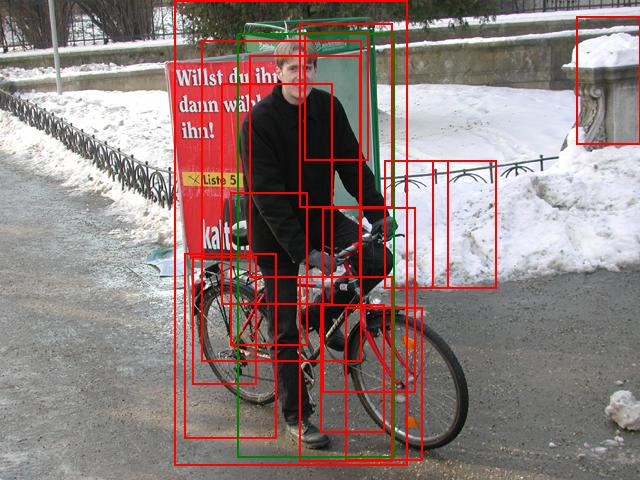

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_083.png (Ảnh thứ 236/288): Precision=0.0625, Recall=1.0000, F1=0.1176, Accuracy=0.0625, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


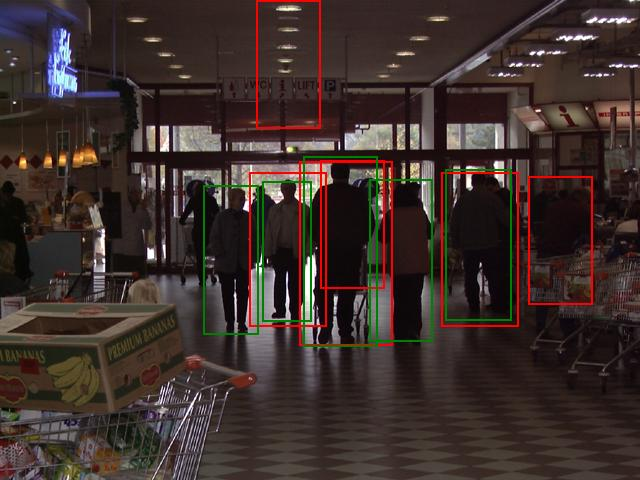

AP@IoU=0.50: 0.3800
AP@IoU=0.55: 0.3800
AP@IoU=0.60: 0.2800
AP@IoU=0.65: 0.2800
AP@IoU=0.70: 0.2800
AP@IoU=0.75: 0.2800
AP@IoU=0.80: 0.2000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6000
Recall@IoU=0.55: 0.6000
Recall@IoU=0.60: 0.4000
Recall@IoU=0.65: 0.4000
Recall@IoU=0.70: 0.4000
Recall@IoU=0.75: 0.4000
Recall@IoU=0.80: 0.2000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_159.png (Ảnh thứ 237/288): Precision=0.5000, Recall=0.6000, F1=0.5455, Accuracy=0.3750, mAP@0.5:0.95=0.2080, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


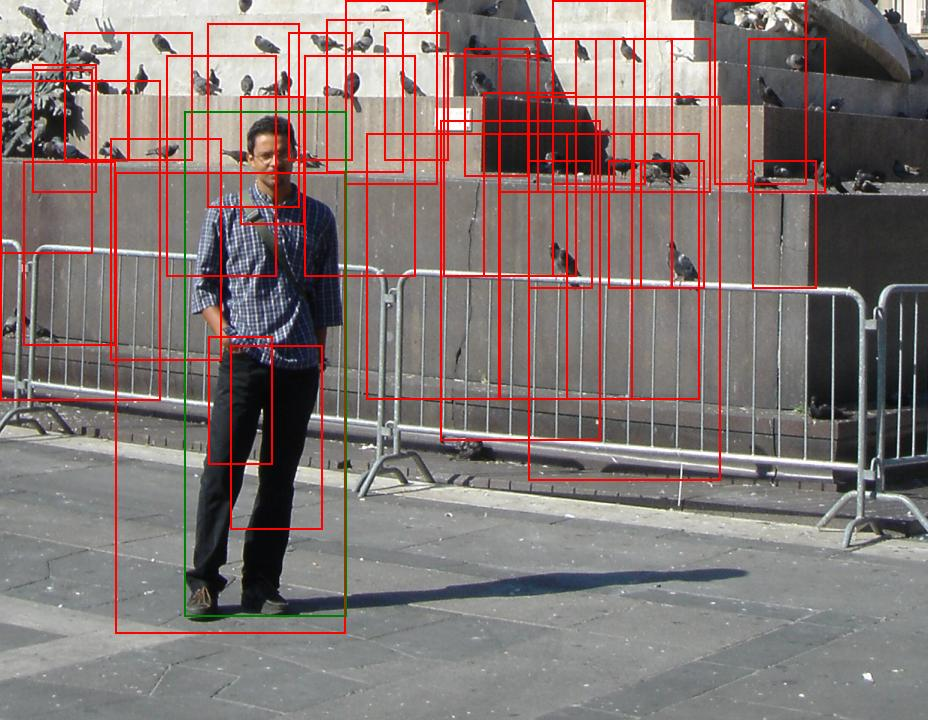

AP@IoU=0.50: 0.0476
AP@IoU=0.55: 0.0476
AP@IoU=0.60: 0.0476
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000024.png (Ảnh thứ 238/288): Precision=0.0270, Recall=1.0000, F1=0.0526, Accuracy=0.0270, mAP@0.5:0.95=0.0143, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


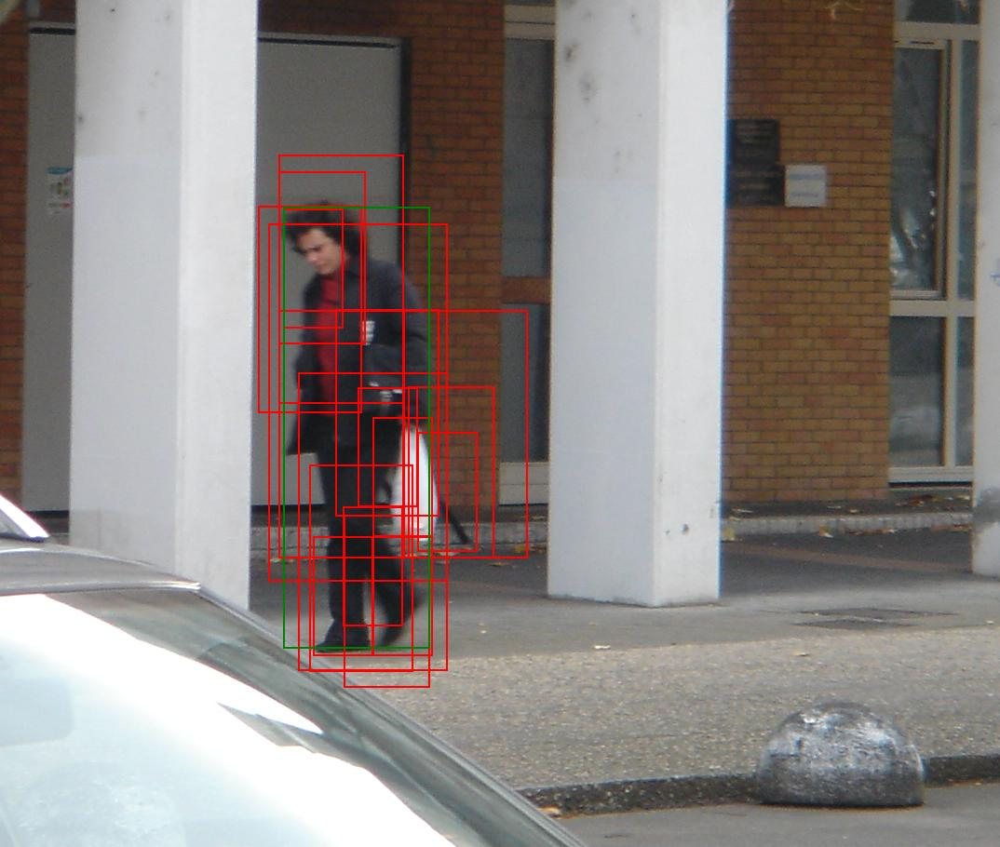

AP@IoU=0.50: 0.1429
AP@IoU=0.55: 0.1429
AP@IoU=0.60: 0.1429
AP@IoU=0.65: 0.1429
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001654.png (Ảnh thứ 239/288): Precision=0.0556, Recall=1.0000, F1=0.1053, Accuracy=0.0556, mAP@0.5:0.95=0.0571, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


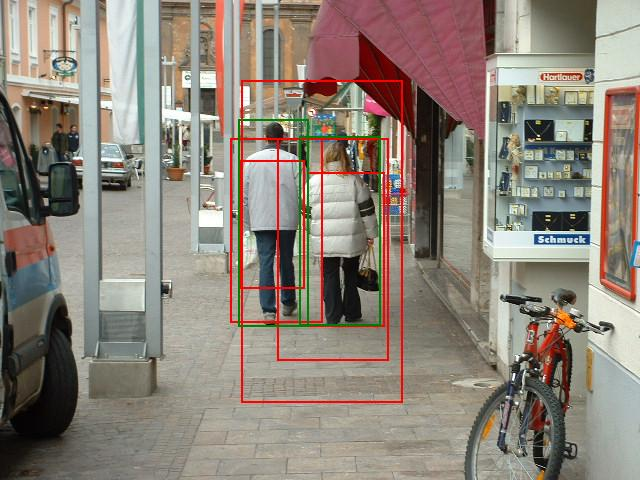

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_027.png (Ảnh thứ 240/288): Precision=0.4000, Recall=1.0000, F1=0.5714, Accuracy=0.4000, mAP@0.5:0.95=0.3625, mAR@0.5:0.95=0.4500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


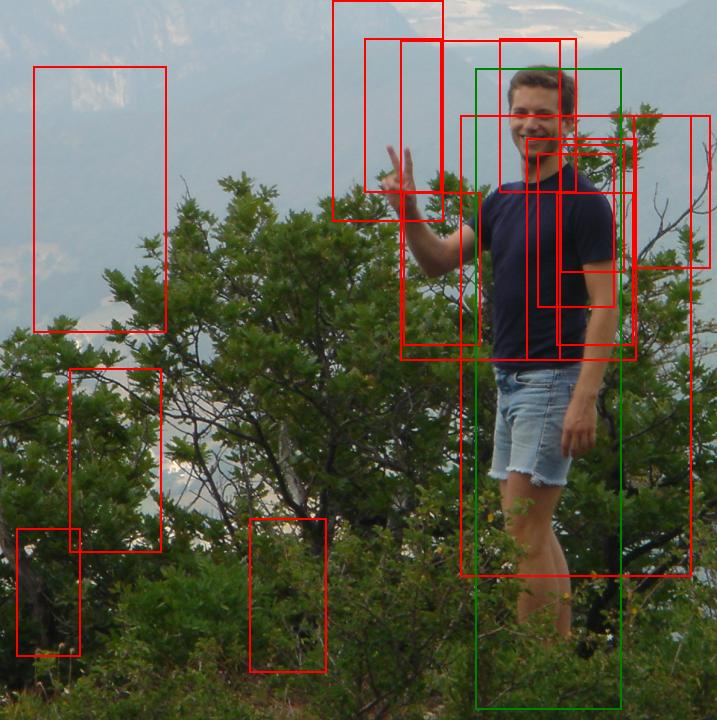

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000008.png (Ảnh thứ 241/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.0250, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


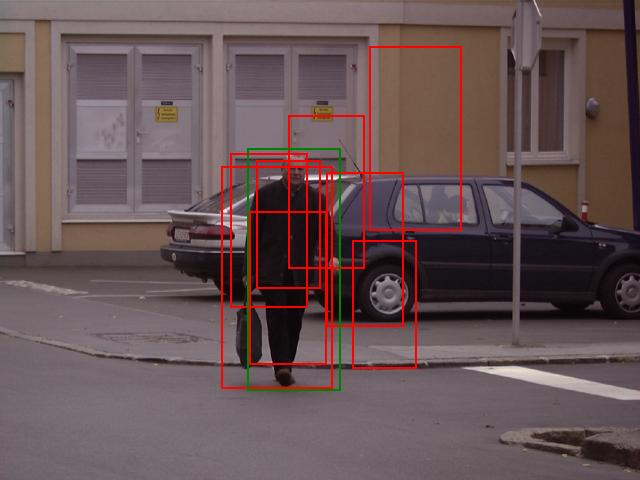

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.5000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_164.png (Ảnh thứ 242/288): Precision=0.1250, Recall=1.0000, F1=0.2222, Accuracy=0.1250, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


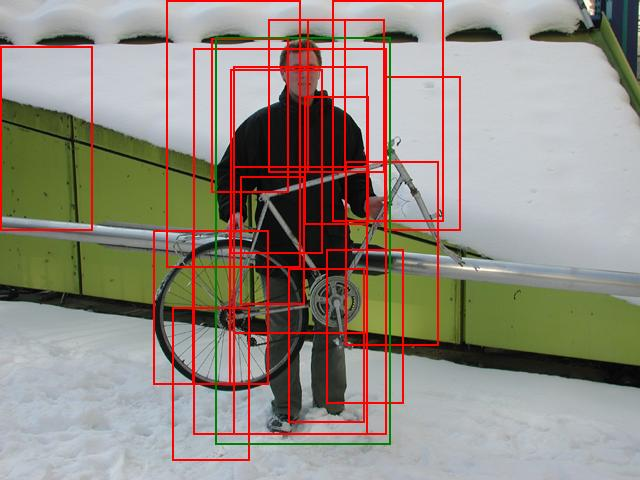

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.3333
AP@IoU=0.80: 0.3333
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_164.png (Ảnh thứ 243/288): Precision=0.0526, Recall=1.0000, F1=0.1000, Accuracy=0.0526, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


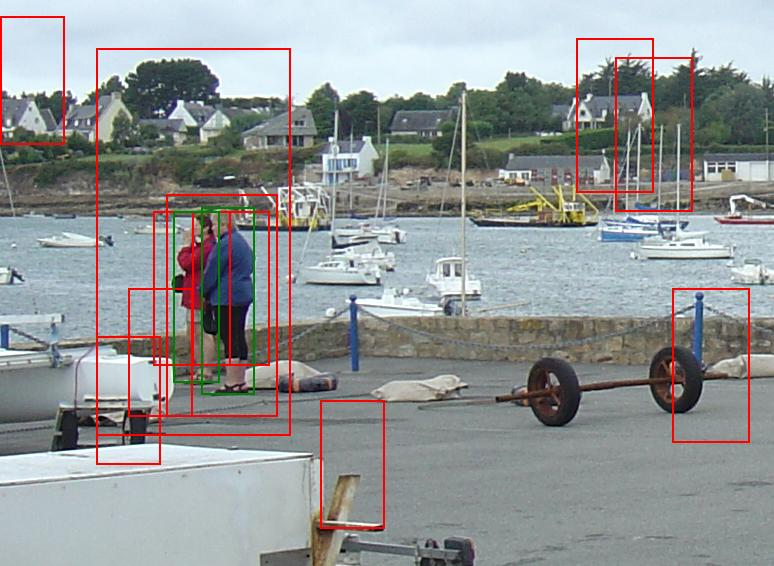

AP@IoU=0.50: 0.6250
AP@IoU=0.55: 0.6250
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001725.png (Ảnh thứ 244/288): Precision=0.1818, Recall=1.0000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.1750, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


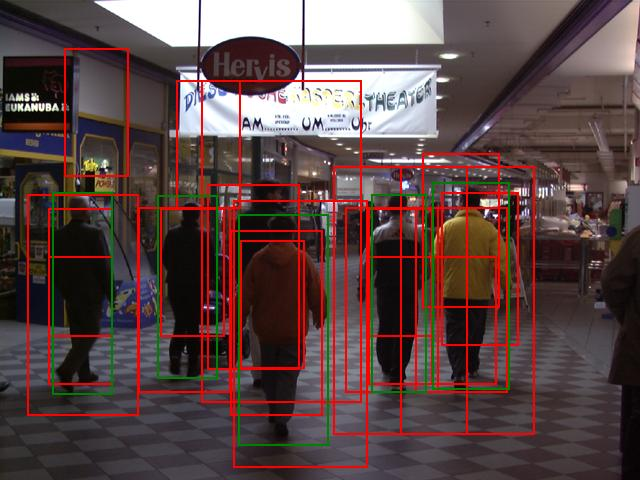

AP@IoU=0.50: 0.7912
AP@IoU=0.55: 0.7912
AP@IoU=0.60: 0.4806
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.8000
Recall@IoU=0.65: 0.4000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_217.png (Ảnh thứ 245/288): Precision=0.2381, Recall=1.0000, F1=0.3846, Accuracy=0.2381, mAP@0.5:0.95=0.2463, mAR@0.5:0.95=0.3400
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


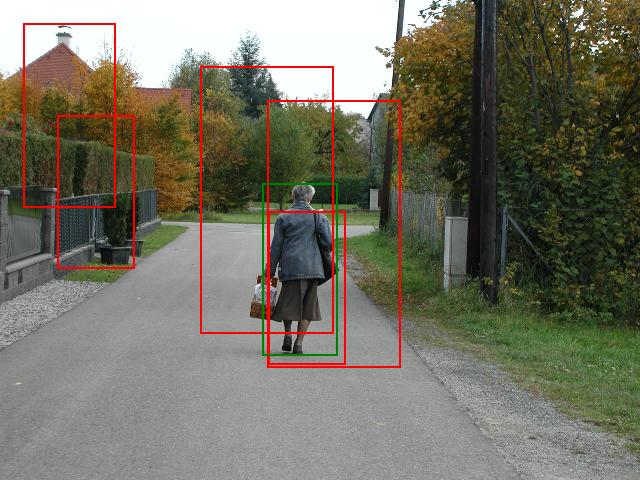

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_075.png (Ảnh thứ 246/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


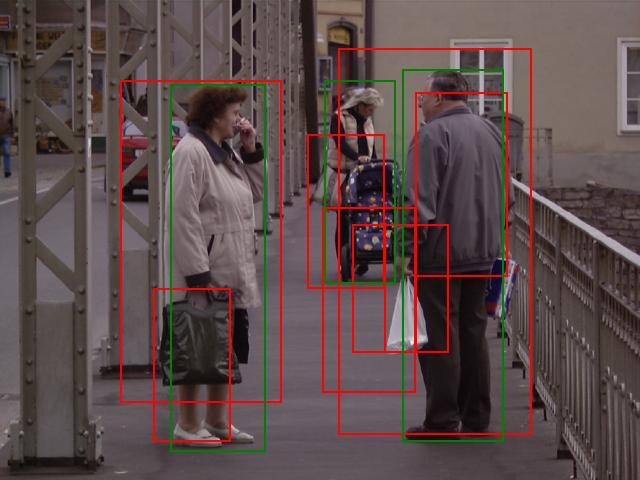

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_222.png (Ảnh thứ 247/288): Precision=0.2500, Recall=0.6667, F1=0.3636, Accuracy=0.2222, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.0667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


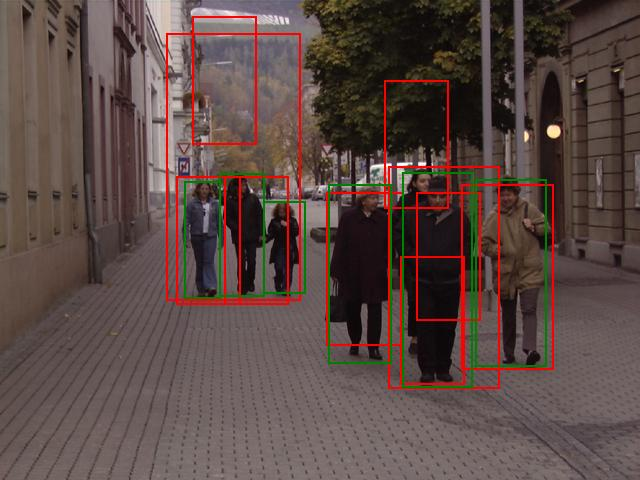

AP@IoU=0.50: 0.8056
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.5000
AP@IoU=0.65: 0.1944
AP@IoU=0.70: 0.1944
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8333
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_191.png (Ảnh thứ 248/288): Precision=0.5000, Recall=0.8333, F1=0.6250, Accuracy=0.4545, mAP@0.5:0.95=0.2194, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


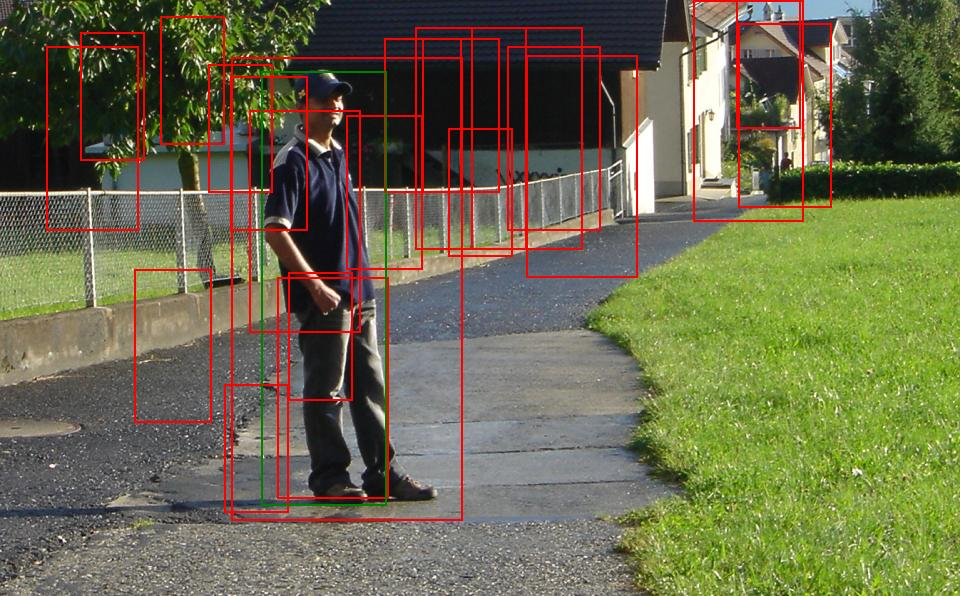

AP@IoU=0.50: 0.1111
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop_000020.png (Ảnh thứ 249/288): Precision=0.0455, Recall=1.0000, F1=0.0870, Accuracy=0.0455, mAP@0.5:0.95=0.0111, mAR@0.5:0.95=0.1000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


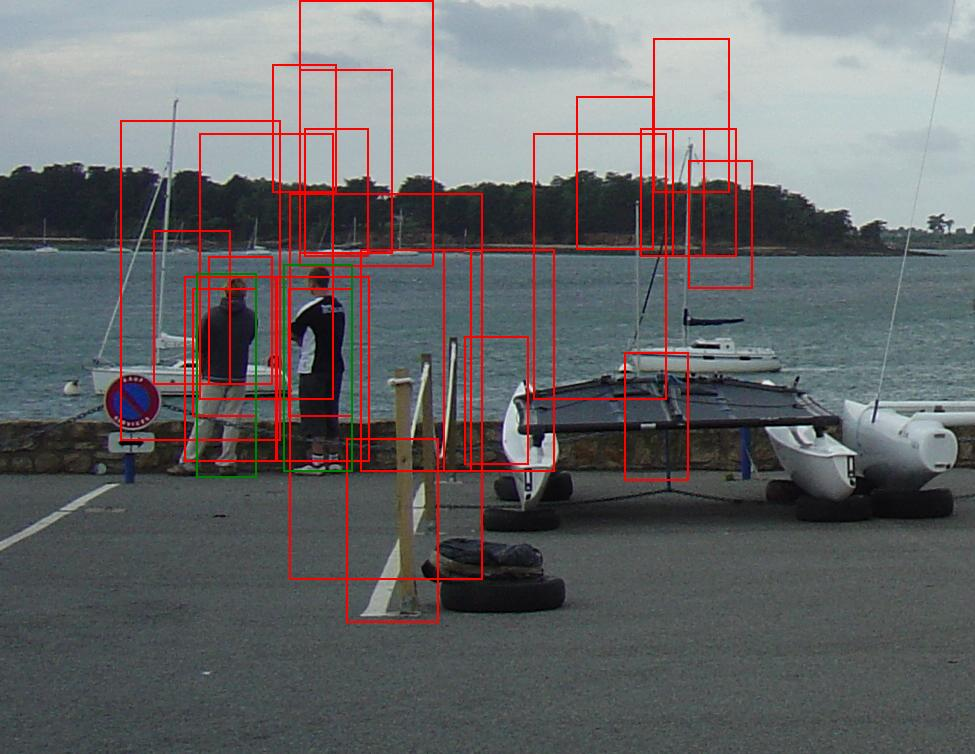

AP@IoU=0.50: 0.8333
AP@IoU=0.55: 0.8333
AP@IoU=0.60: 0.8333
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001631.png (Ảnh thứ 250/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.2667, mAR@0.5:0.95=0.3500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


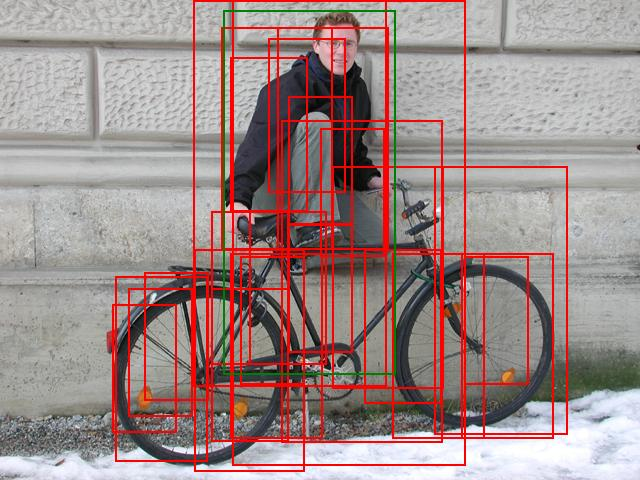

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.0588
AP@IoU=0.60: 0.0588
AP@IoU=0.65: 0.0588
AP@IoU=0.70: 0.0588
AP@IoU=0.75: 0.0588
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_100.png (Ảnh thứ 251/288): Precision=0.0385, Recall=1.0000, F1=0.0741, Accuracy=0.0385, mAP@0.5:0.95=0.0794, mAR@0.5:0.95=0.6000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


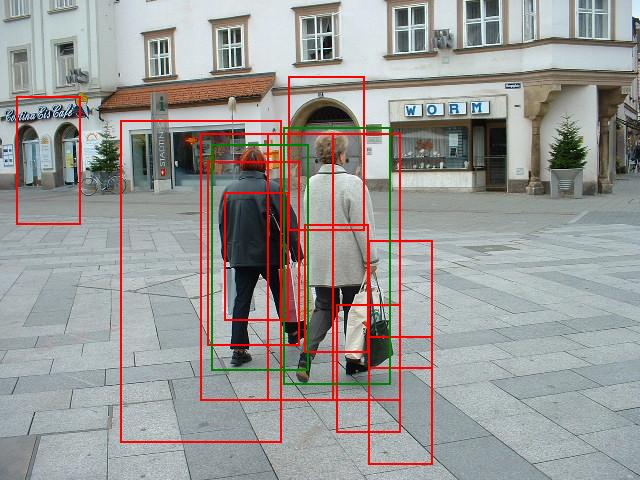

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_190.png (Ảnh thứ 252/288): Precision=0.1818, Recall=1.0000, F1=0.3077, Accuracy=0.1818, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


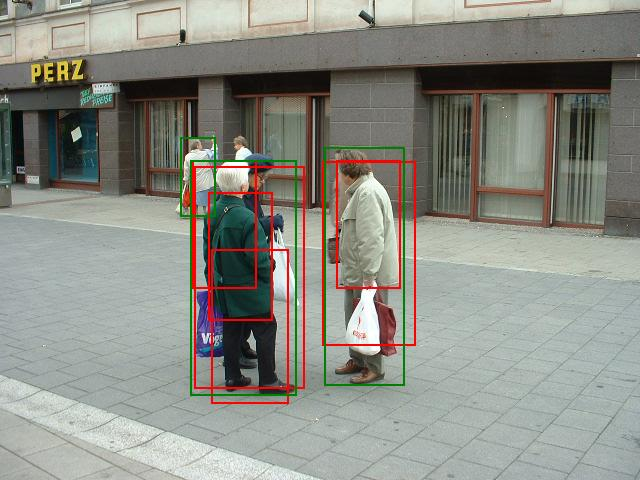

AP@IoU=0.50: 0.5556
AP@IoU=0.55: 0.5556
AP@IoU=0.60: 0.5556
AP@IoU=0.65: 0.5556
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.1111
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.3333
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_317.png (Ảnh thứ 253/288): Precision=0.3333, Recall=0.6667, F1=0.4444, Accuracy=0.2857, mAP@0.5:0.95=0.2556, mAR@0.5:0.95=0.3667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


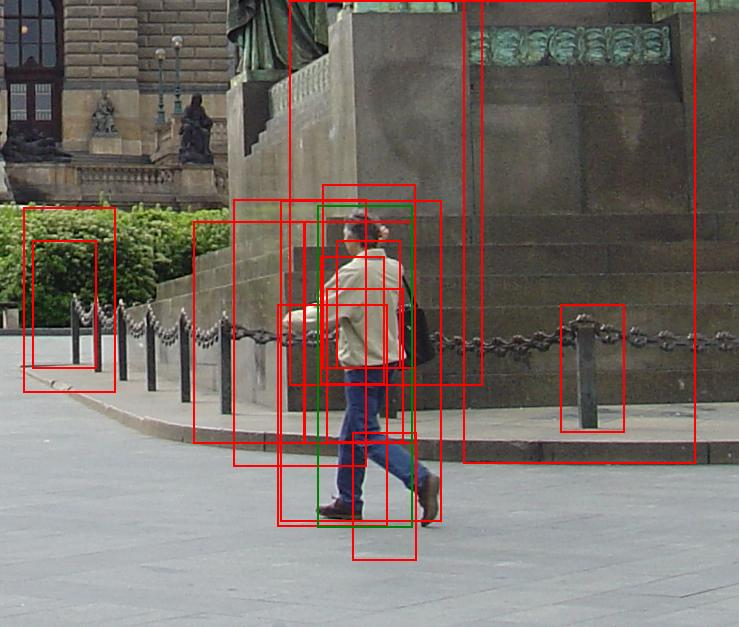

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001604.png (Ảnh thứ 254/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


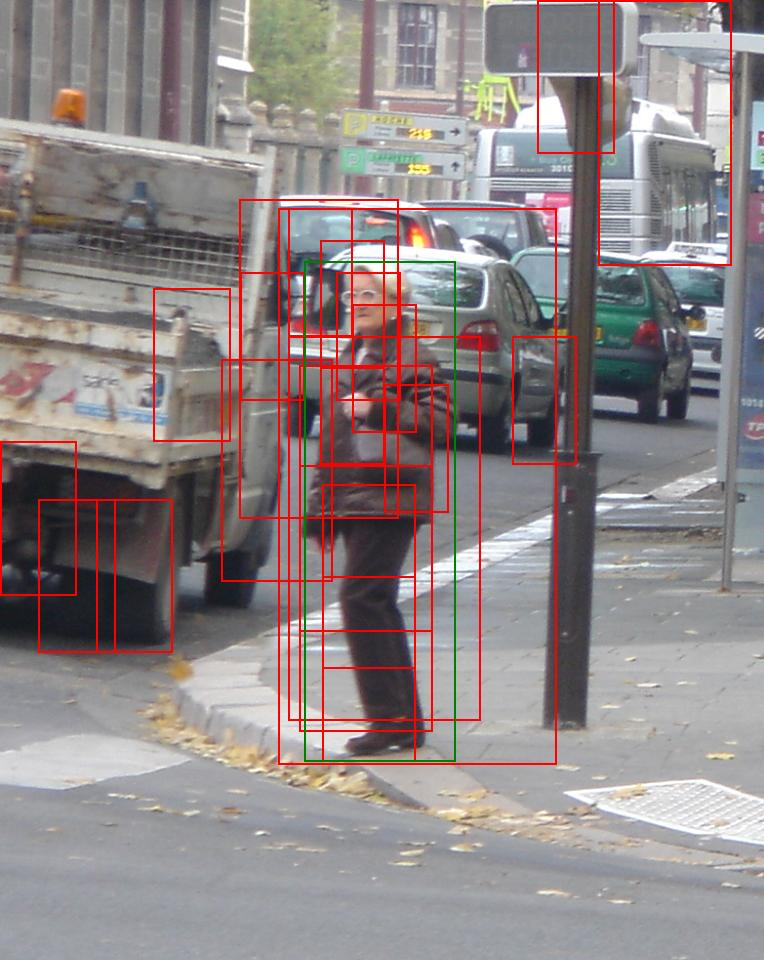

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001511.png (Ảnh thứ 255/288): Precision=0.0455, Recall=1.0000, F1=0.0870, Accuracy=0.0455, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


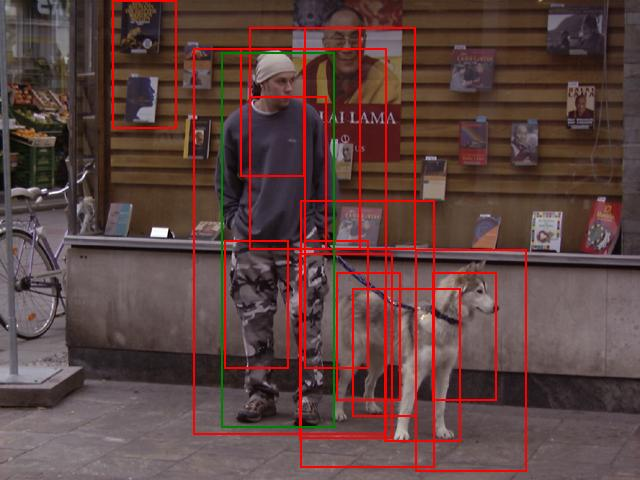

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_141.png (Ảnh thứ 256/288): Precision=0.0667, Recall=1.0000, F1=0.1250, Accuracy=0.0667, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


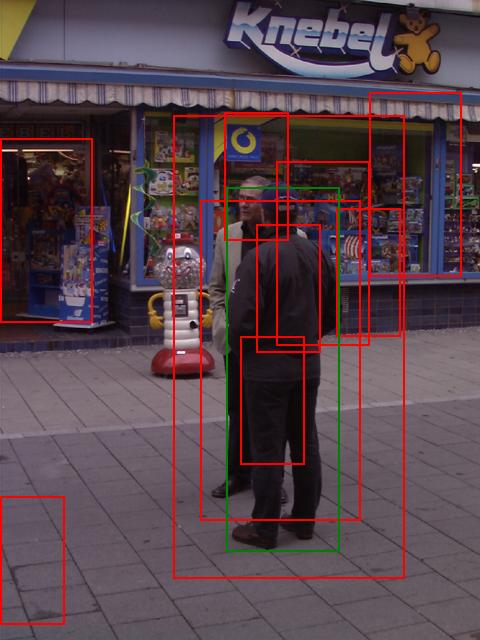

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_087.png (Ảnh thứ 257/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


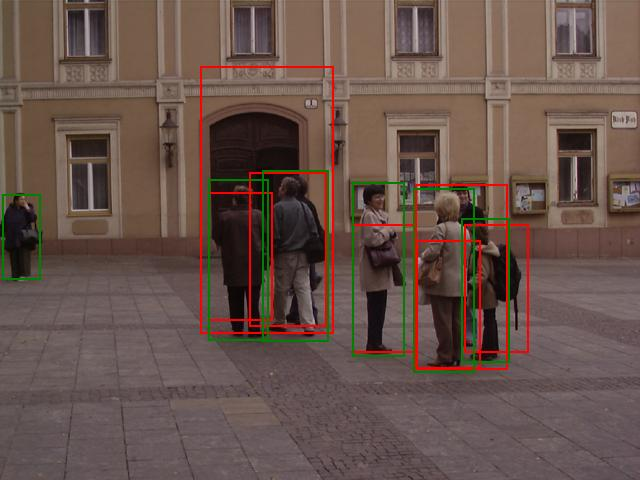

AP@IoU=0.50: 0.8056
AP@IoU=0.55: 0.8056
AP@IoU=0.60: 0.8056
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.3333
AP@IoU=0.75: 0.1667
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8333
Recall@IoU=0.55: 0.8333
Recall@IoU=0.60: 0.8333
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.1667
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_188.png (Ảnh thứ 258/288): Precision=0.7143, Recall=0.8333, F1=0.7692, Accuracy=0.6250, mAP@0.5:0.95=0.3250, mAR@0.5:0.95=0.3333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


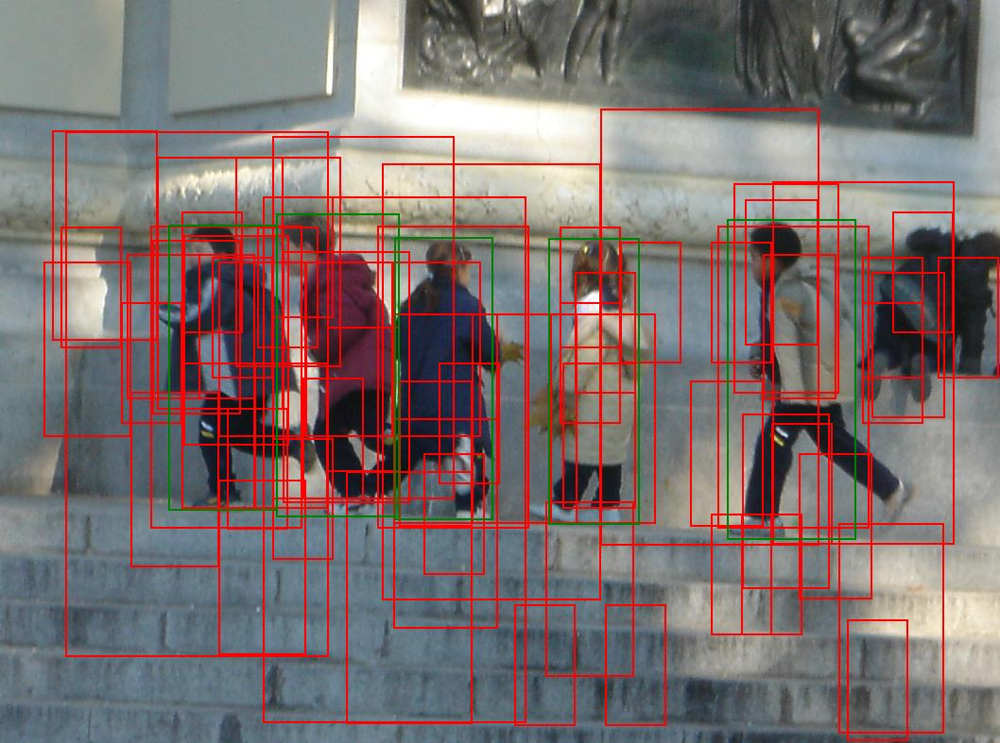

AP@IoU=0.50: 0.5709
AP@IoU=0.55: 0.5709
AP@IoU=0.60: 0.5709
AP@IoU=0.65: 0.2459
AP@IoU=0.70: 0.0848
AP@IoU=0.75: 0.0091
AP@IoU=0.80: 0.0091
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.8000
Recall@IoU=0.70: 0.4000
Recall@IoU=0.75: 0.2000
Recall@IoU=0.80: 0.2000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001670.png (Ảnh thứ 259/288): Precision=0.0735, Recall=1.0000, F1=0.1370, Accuracy=0.0735, mAP@0.5:0.95=0.2062, mAR@0.5:0.95=0.4600
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


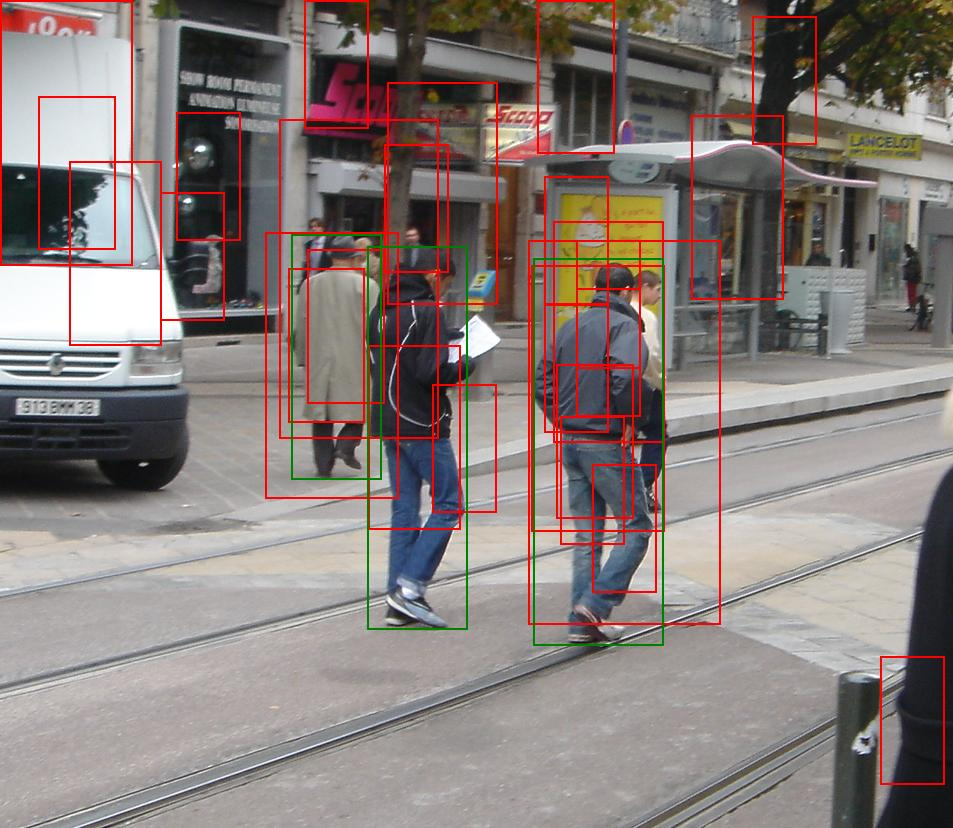

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.6667
AP@IoU=0.60: 0.6667
AP@IoU=0.65: 0.3333
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.3333
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001514.png (Ảnh thứ 260/288): Precision=0.0714, Recall=0.6667, F1=0.1290, Accuracy=0.0690, mAP@0.5:0.95=0.2333, mAR@0.5:0.95=0.2333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


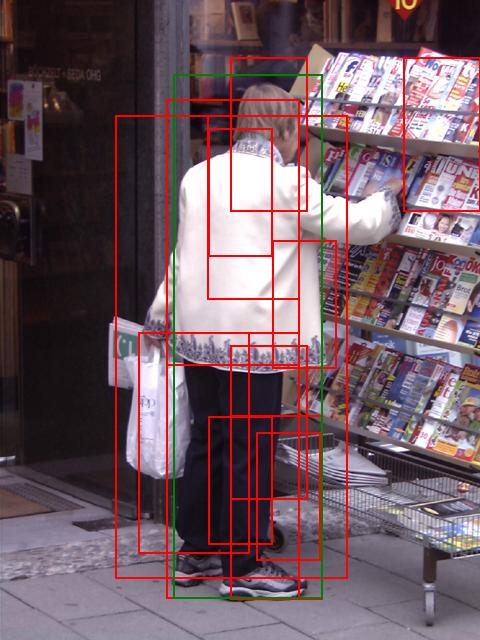

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_009.png (Ảnh thứ 261/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.0667, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


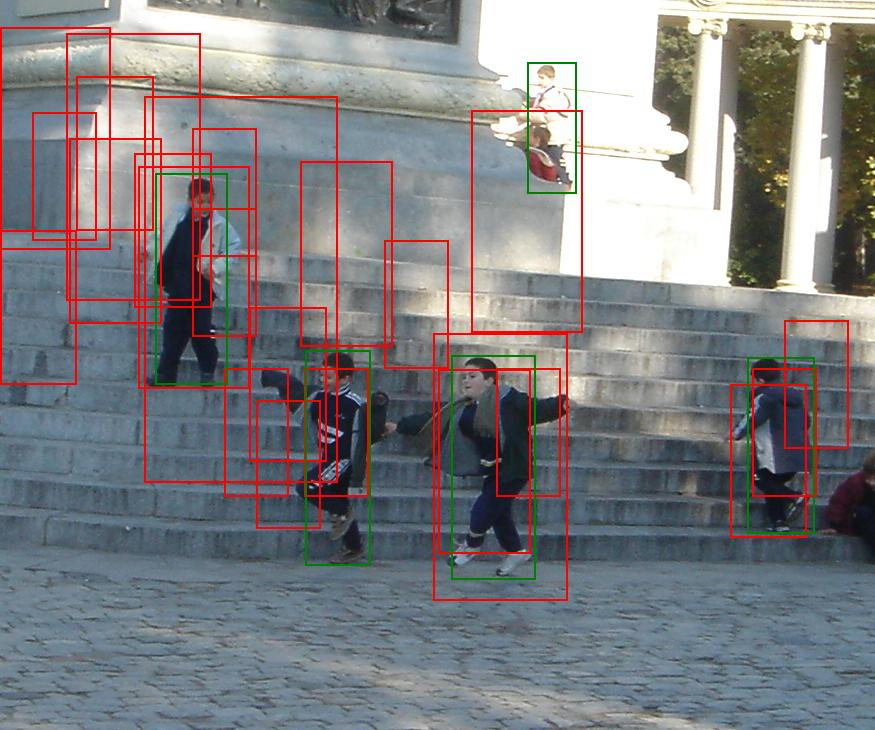

AP@IoU=0.50: 0.5321
AP@IoU=0.55: 0.5321
AP@IoU=0.60: 0.4429
AP@IoU=0.65: 0.2167
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.8000
Recall@IoU=0.55: 0.8000
Recall@IoU=0.60: 0.6000
Recall@IoU=0.65: 0.4000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001555.png (Ảnh thứ 262/288): Precision=0.1667, Recall=0.8000, F1=0.2759, Accuracy=0.1600, mAP@0.5:0.95=0.1724, mAR@0.5:0.95=0.2600
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


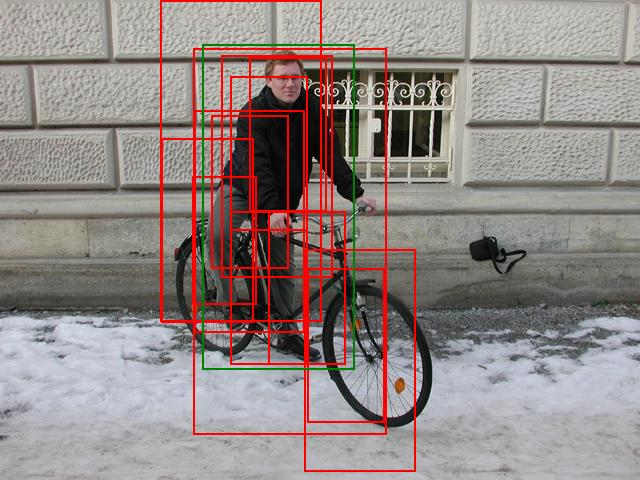

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 0.1667
AP@IoU=0.60: 0.1667
AP@IoU=0.65: 0.1667
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_046.png (Ảnh thứ 263/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.1500, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


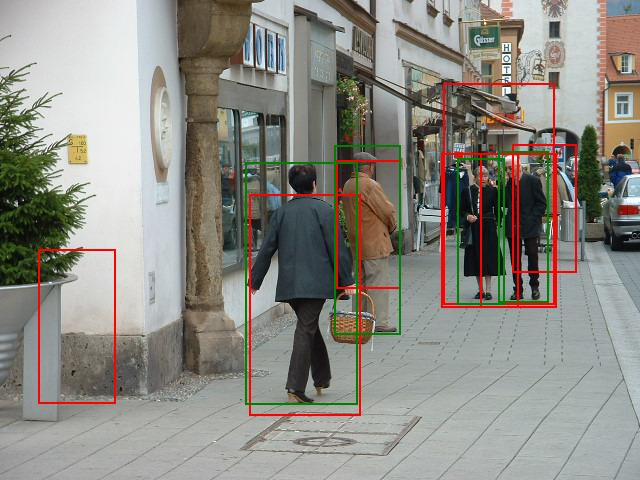

AP@IoU=0.50: 0.8929
AP@IoU=0.55: 0.8929
AP@IoU=0.60: 0.7500
AP@IoU=0.65: 0.2917
AP@IoU=0.70: 0.1250
AP@IoU=0.75: 0.1250
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.7500
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.2500
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_280.png (Ảnh thứ 264/288): Precision=0.5714, Recall=1.0000, F1=0.7273, Accuracy=0.5714, mAP@0.5:0.95=0.3077, mAR@0.5:0.95=0.3750
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


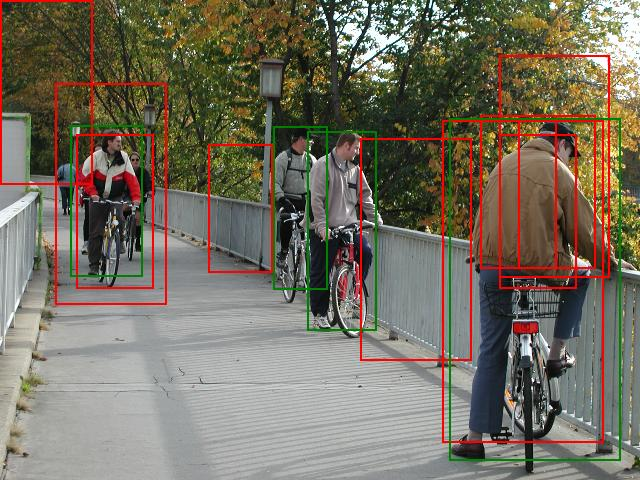

AP@IoU=0.50: 0.4167
AP@IoU=0.55: 0.4167
AP@IoU=0.60: 0.4167
AP@IoU=0.65: 0.4167
AP@IoU=0.70: 0.4167
AP@IoU=0.75: 0.0833
AP@IoU=0.80: 0.0833
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.2500
Recall@IoU=0.80: 0.2500
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_038.png (Ảnh thứ 265/288): Precision=0.2000, Recall=0.5000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.2250, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


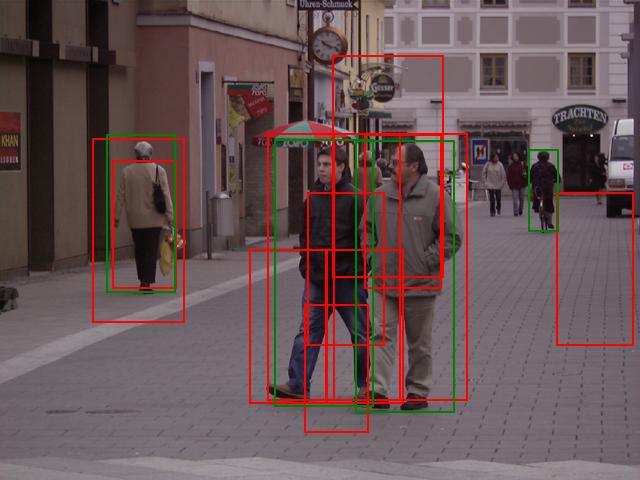

AP@IoU=0.50: 0.5417
AP@IoU=0.55: 0.5417
AP@IoU=0.60: 0.5417
AP@IoU=0.65: 0.5417
AP@IoU=0.70: 0.4167
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.7500
Recall@IoU=0.55: 0.7500
Recall@IoU=0.60: 0.7500
Recall@IoU=0.65: 0.7500
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_126.png (Ảnh thứ 266/288): Precision=0.2727, Recall=0.7500, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.2583, mAR@0.5:0.95=0.3500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


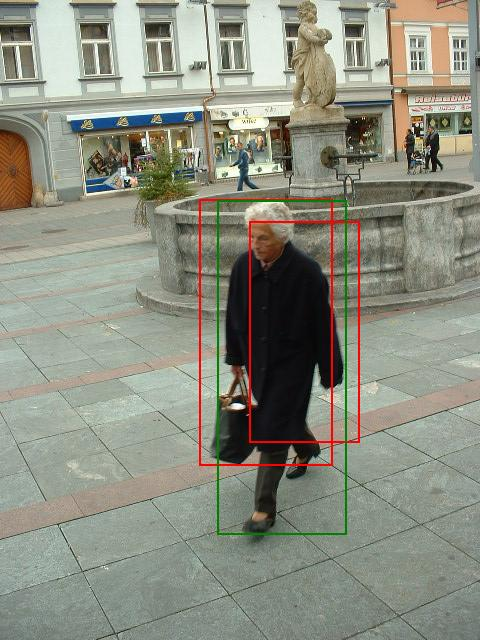

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_038.png (Ảnh thứ 267/288): Precision=0.5000, Recall=1.0000, F1=0.6667, Accuracy=0.5000, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


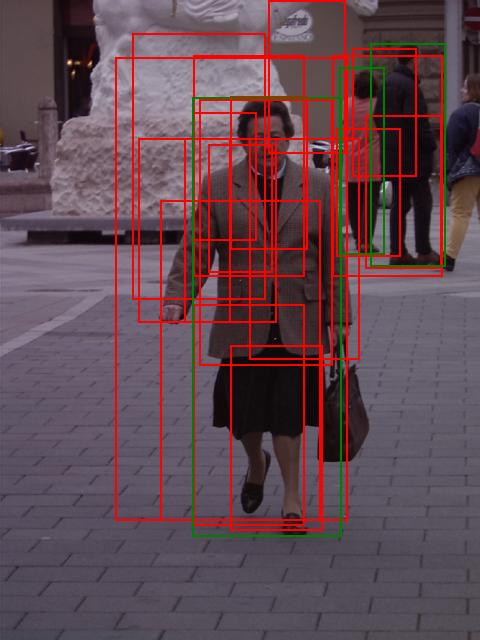

AP@IoU=0.50: 0.4000
AP@IoU=0.55: 0.1407
AP@IoU=0.60: 0.0667
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.3333
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_096.png (Ảnh thứ 268/288): Precision=0.1667, Recall=1.0000, F1=0.2857, Accuracy=0.1667, mAP@0.5:0.95=0.0607, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


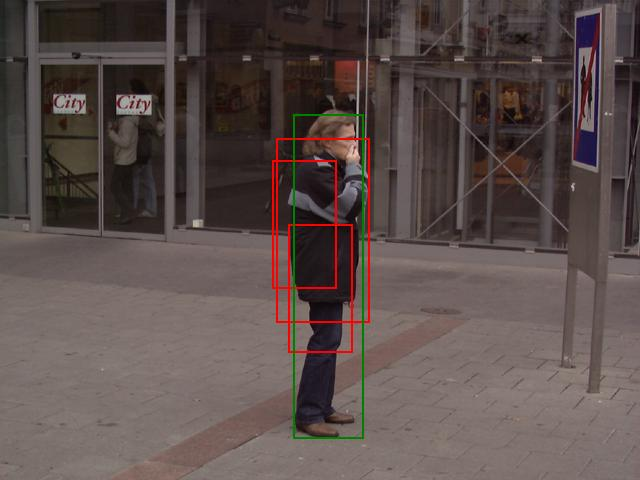

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_052.png (Ảnh thứ 269/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


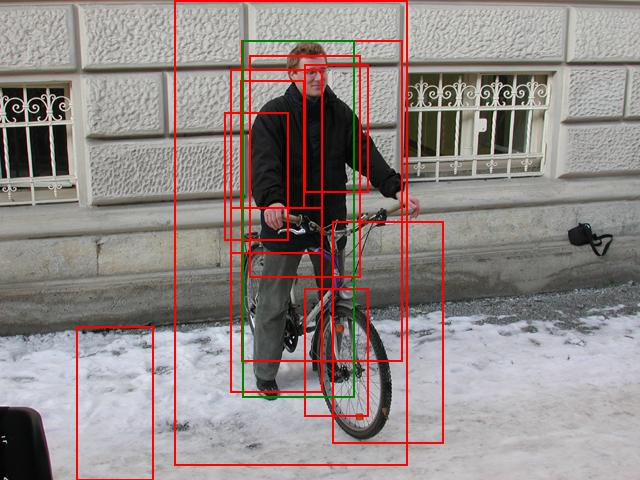

AP@IoU=0.50: 0.5000
AP@IoU=0.55: 0.5000
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_066.png (Ảnh thứ 270/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.1250, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


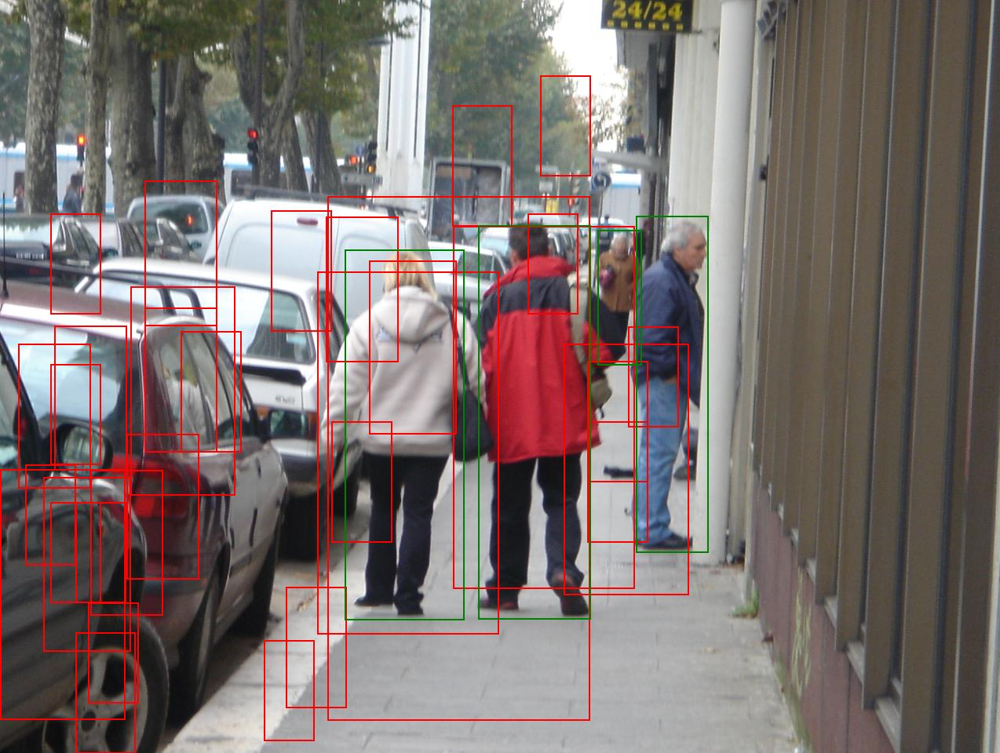

AP@IoU=0.50: 0.3750
AP@IoU=0.55: 0.3750
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.2500
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001638.png (Ảnh thứ 271/288): Precision=0.0606, Recall=0.5000, F1=0.1081, Accuracy=0.0571, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.1250
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


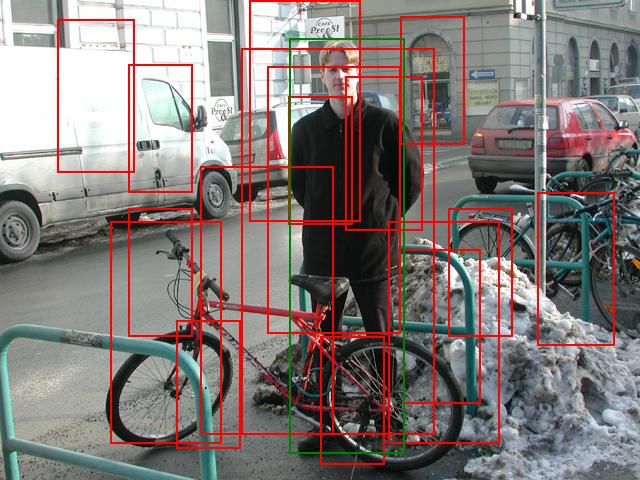

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_069.png (Ảnh thứ 272/288): Precision=0.0588, Recall=1.0000, F1=0.1111, Accuracy=0.0588, mAP@0.5:0.95=0.2000, mAR@0.5:0.95=0.2000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


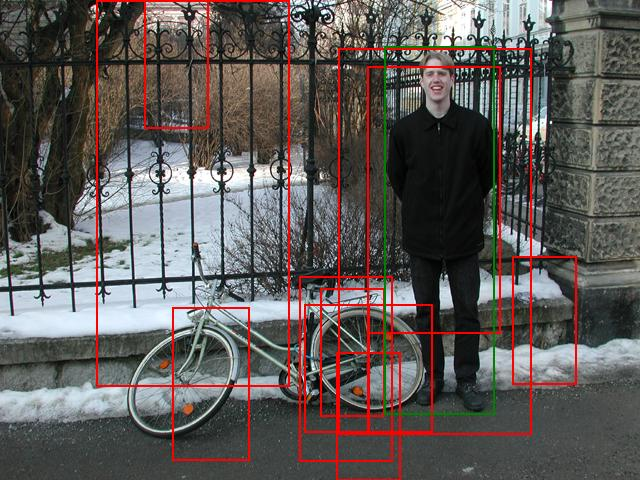

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_072.png (Ảnh thứ 273/288): Precision=0.0909, Recall=1.0000, F1=0.1667, Accuracy=0.0909, mAP@0.5:0.95=0.3000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


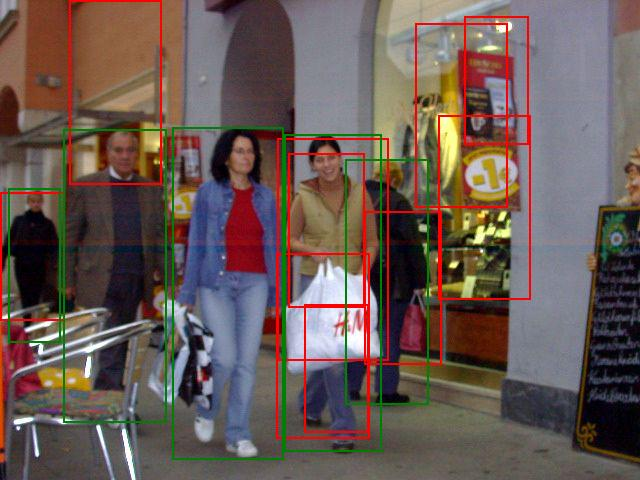

AP@IoU=0.50: 0.2667
AP@IoU=0.55: 0.2667
AP@IoU=0.60: 0.2667
AP@IoU=0.65: 0.2000
AP@IoU=0.70: 0.2000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.4000
Recall@IoU=0.55: 0.4000
Recall@IoU=0.60: 0.4000
Recall@IoU=0.65: 0.2000
Recall@IoU=0.70: 0.2000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_263.png (Ảnh thứ 274/288): Precision=0.2000, Recall=0.4000, F1=0.2667, Accuracy=0.1538, mAP@0.5:0.95=0.1200, mAR@0.5:0.95=0.1600
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


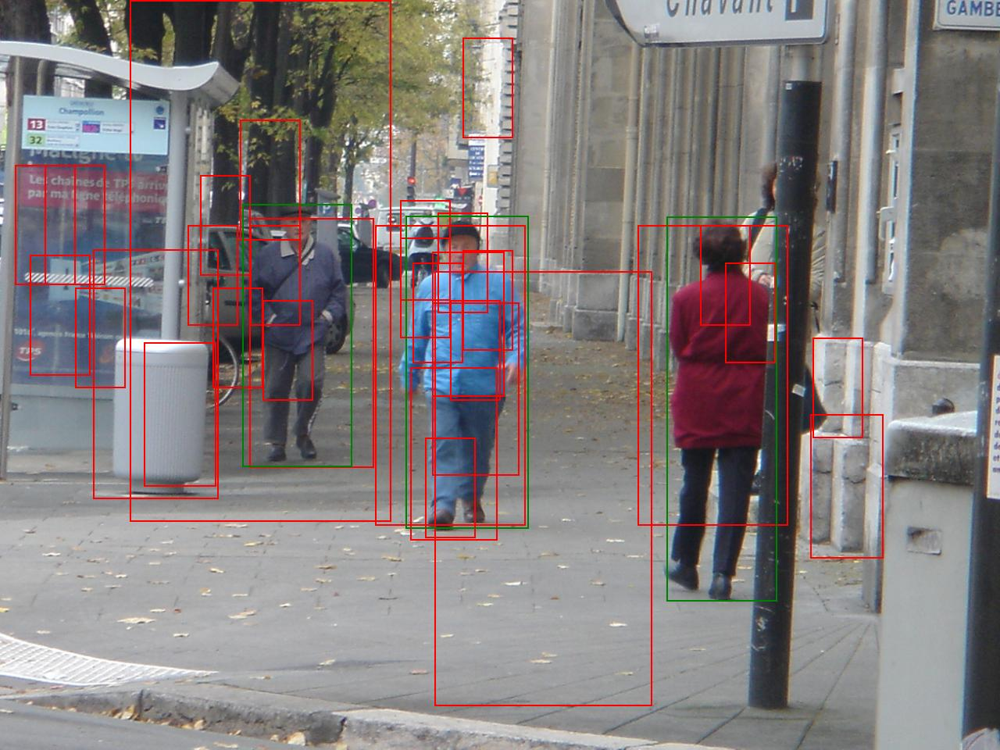

AP@IoU=0.50: 0.5074
AP@IoU=0.55: 0.5074
AP@IoU=0.60: 0.5074
AP@IoU=0.65: 0.4074
AP@IoU=0.70: 0.4074
AP@IoU=0.75: 0.3333
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.6667
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001512.png (Ảnh thứ 275/288): Precision=0.0938, Recall=1.0000, F1=0.1714, Accuracy=0.0938, mAP@0.5:0.95=0.2670, mAR@0.5:0.95=0.4667
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


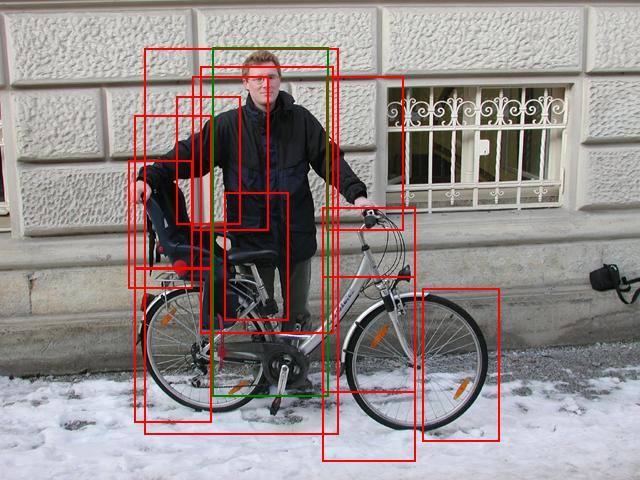

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_048.png (Ảnh thứ 276/288): Precision=0.0833, Recall=1.0000, F1=0.1538, Accuracy=0.0833, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


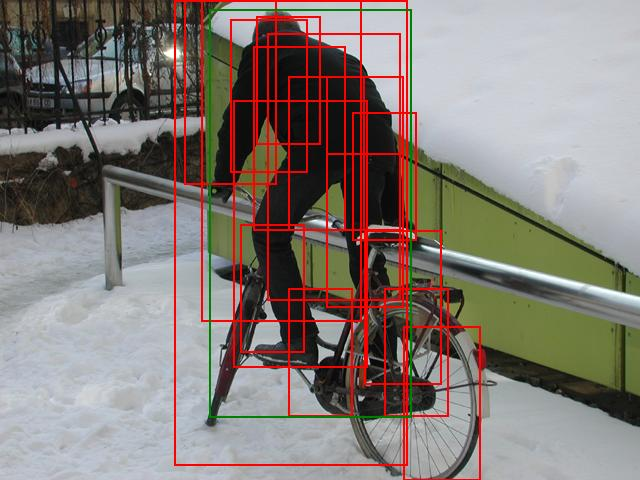

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 0.0667
AP@IoU=0.65: 0.0667
AP@IoU=0.70: 0.0667
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_099.png (Ảnh thứ 277/288): Precision=0.0588, Recall=1.0000, F1=0.1111, Accuracy=0.0588, mAP@0.5:0.95=0.2200, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


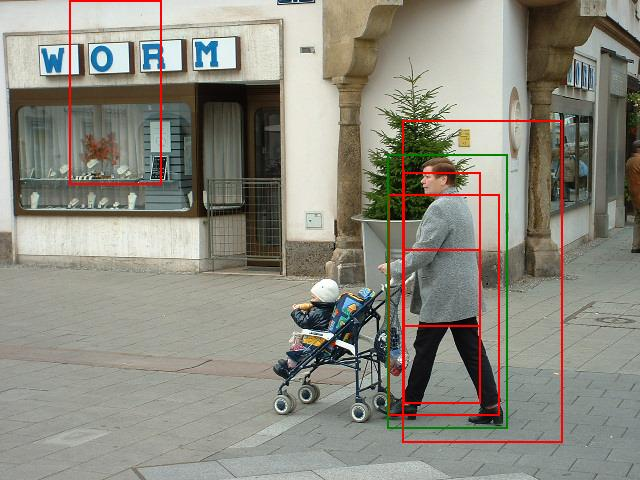

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_062.png (Ảnh thứ 278/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.5000, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


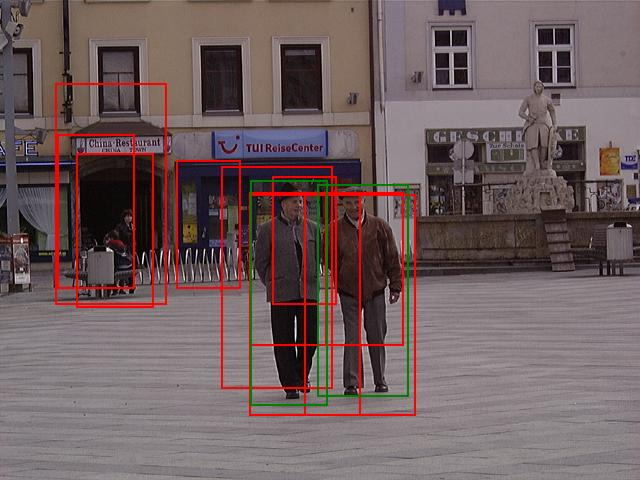

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.5000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_181.png (Ảnh thứ 279/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.4500, mAR@0.5:0.95=0.4500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


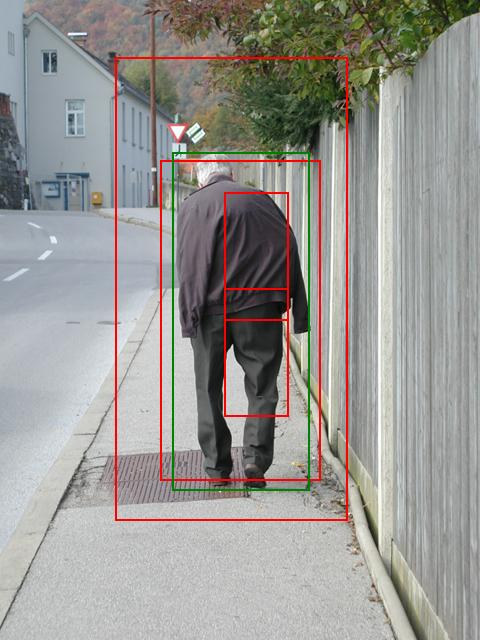

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 1.0000
AP@IoU=0.75: 1.0000
AP@IoU=0.80: 1.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 1.0000
Recall@IoU=0.75: 1.0000
Recall@IoU=0.80: 1.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_040.png (Ảnh thứ 280/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.7000, mAR@0.5:0.95=0.7000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


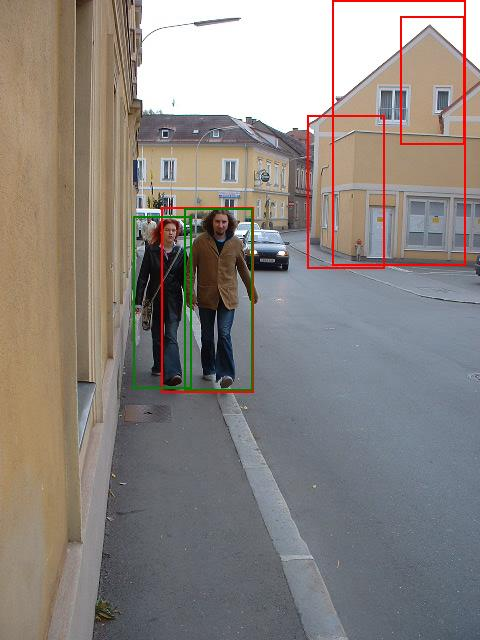

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.2500
AP@IoU=0.70: 0.2500
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.5000
Recall@IoU=0.55: 0.5000
Recall@IoU=0.60: 0.5000
Recall@IoU=0.65: 0.5000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_118.png (Ảnh thứ 281/288): Precision=0.2500, Recall=0.5000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.1250, mAR@0.5:0.95=0.2500
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


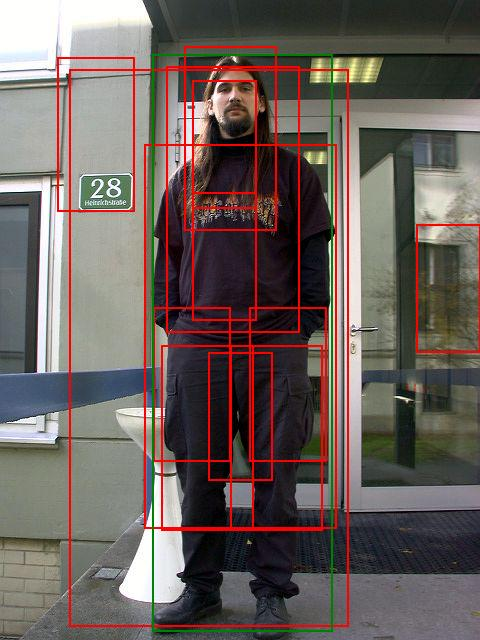

AP@IoU=0.50: 0.3333
AP@IoU=0.55: 0.3333
AP@IoU=0.60: 0.3333
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_032.png (Ảnh thứ 282/288): Precision=0.0769, Recall=1.0000, F1=0.1429, Accuracy=0.0769, mAP@0.5:0.95=0.1000, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


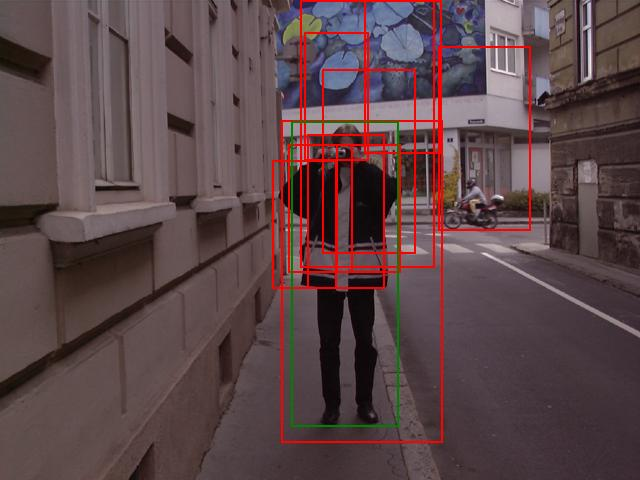

AP@IoU=0.50: 0.2500
AP@IoU=0.55: 0.2500
AP@IoU=0.60: 0.2500
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_053.png (Ảnh thứ 283/288): Precision=0.1000, Recall=1.0000, F1=0.1818, Accuracy=0.1000, mAP@0.5:0.95=0.0750, mAR@0.5:0.95=0.3000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


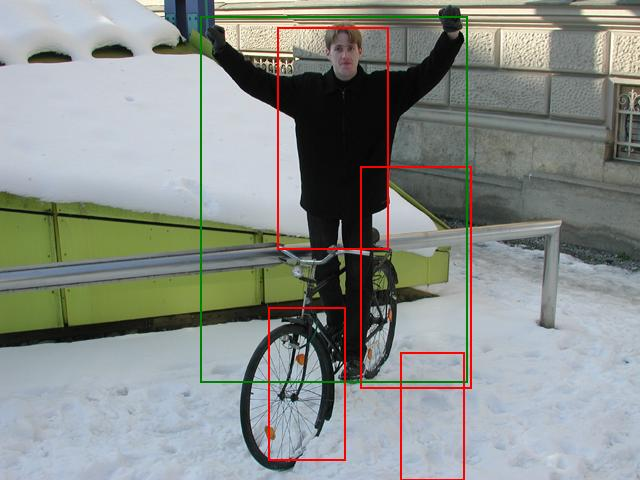

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_and_bike_111.png (Ảnh thứ 284/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


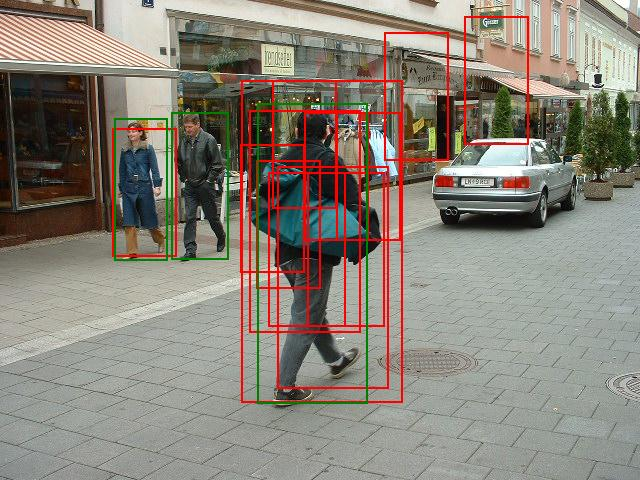

AP@IoU=0.50: 0.5556
AP@IoU=0.55: 0.5556
AP@IoU=0.60: 0.5556
AP@IoU=0.65: 0.1852
AP@IoU=0.70: 0.1111
AP@IoU=0.75: 0.1111
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.6667
Recall@IoU=0.55: 0.6667
Recall@IoU=0.60: 0.6667
Recall@IoU=0.65: 0.6667
Recall@IoU=0.70: 0.3333
Recall@IoU=0.75: 0.3333
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_293.png (Ảnh thứ 285/288): Precision=0.1538, Recall=0.6667, F1=0.2500, Accuracy=0.1429, mAP@0.5:0.95=0.2074, mAR@0.5:0.95=0.3333
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


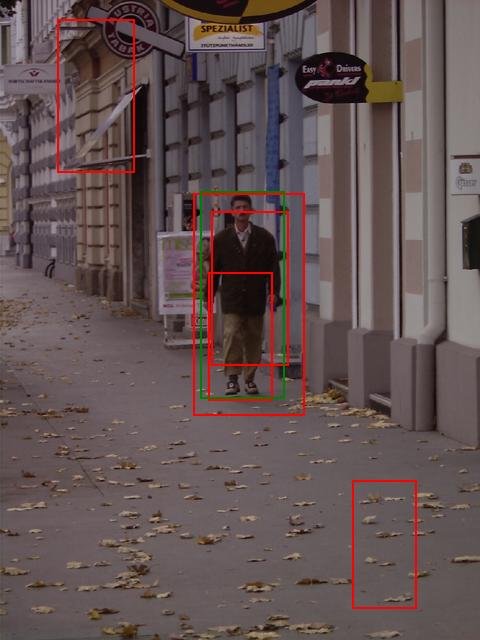

AP@IoU=0.50: 1.0000
AP@IoU=0.55: 1.0000
AP@IoU=0.60: 1.0000
AP@IoU=0.65: 1.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_015.png (Ảnh thứ 286/288): Precision=0.2000, Recall=1.0000, F1=0.3333, Accuracy=0.2000, mAP@0.5:0.95=0.4000, mAR@0.5:0.95=0.4000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


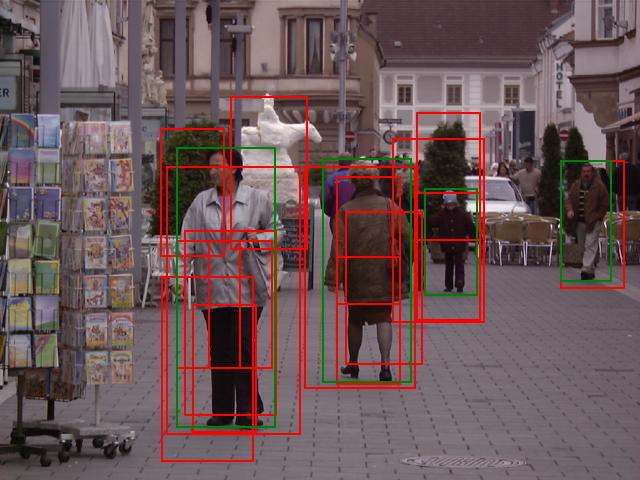

AP@IoU=0.50: 0.6667
AP@IoU=0.55: 0.6667
AP@IoU=0.60: 0.6667
AP@IoU=0.65: 0.6667
AP@IoU=0.70: 0.3056
AP@IoU=0.75: 0.3056
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 1.0000
Recall@IoU=0.55: 1.0000
Recall@IoU=0.60: 1.0000
Recall@IoU=0.65: 1.0000
Recall@IoU=0.70: 0.5000
Recall@IoU=0.75: 0.5000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh person_193.png (Ảnh thứ 287/288): Precision=0.2500, Recall=1.0000, F1=0.4000, Accuracy=0.2500, mAP@0.5:0.95=0.3278, mAR@0.5:0.95=0.5000
Ảnh kết quả đã được lưu tại: /kaggle/working/output_image.jpg


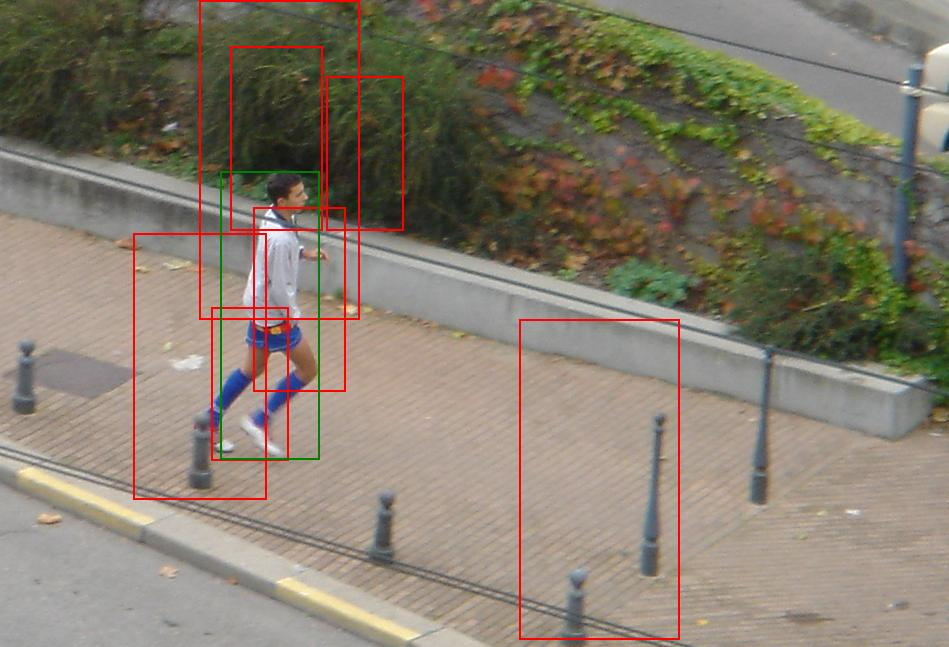

AP@IoU=0.50: 0.0000
AP@IoU=0.55: 0.0000
AP@IoU=0.60: 0.0000
AP@IoU=0.65: 0.0000
AP@IoU=0.70: 0.0000
AP@IoU=0.75: 0.0000
AP@IoU=0.80: 0.0000
AP@IoU=0.85: 0.0000
AP@IoU=0.90: 0.0000
AP@IoU=0.95: 0.0000
Recall@IoU=0.50: 0.0000
Recall@IoU=0.55: 0.0000
Recall@IoU=0.60: 0.0000
Recall@IoU=0.65: 0.0000
Recall@IoU=0.70: 0.0000
Recall@IoU=0.75: 0.0000
Recall@IoU=0.80: 0.0000
Recall@IoU=0.85: 0.0000
Recall@IoU=0.90: 0.0000
Recall@IoU=0.95: 0.0000
Ảnh crop001634.png (Ảnh thứ 288/288): Precision=0.0000, Recall=0.0000, F1=0.0000, Accuracy=0.0000, mAP@0.5:0.95=0.0000, mAR@0.5:0.95=0.0000

Đánh giá trên toàn bộ tập test:
Average Precision: 0.1383
Average Recall: 0.8184
Average F1-score: 0.2179
Average Accuracy: 0.1311
Average mAP@0.5:0.95: 0.2059
Average mAR@0.5:0.95: 0.3125


In [7]:
def calculate_iou(box1, box2):
    x1_min, y1_min, x1_max, y1_max = box1
    x2_min, y2_min, x2_max, y2_max = box2

    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)

    inter_area = max(0, inter_x_max - inter_x_min + 1) * max(0, inter_y_max - inter_y_min + 1)
    area1 = (x1_max - x1_min + 1) * (y1_max - y1_min + 1)
    area2 = (x2_max - x2_min + 1) * (y2_max - y2_min + 1)
    union_area = area1 + area2 - inter_area
    iou = inter_area / union_area if union_area > 0 else 0
    return iou

def compute_ap(pred_boxes, pred_scores, gt_boxes, iou_threshold):
    if len(pred_boxes) == 0 or len(gt_boxes) == 0:
        return 0.0 if len(gt_boxes) > 0 else 1.0

    sorted_indices = np.argsort(pred_scores)[::-1]
    pred_boxes = [pred_boxes[i] for i in sorted_indices]
    pred_scores = [pred_scores[i] for i in sorted_indices]

    TP = 0
    FP = 0
    matched_gt = set()
    precision_recall = []

    for pred_box in pred_boxes:
        best_iou = 0
        best_gt_idx = -1
        for gt_idx, gt_box in enumerate(gt_boxes):
            if gt_idx in matched_gt:
                continue
            iou = calculate_iou(pred_box, gt_box)
            if iou > best_iou:
                best_iou = iou
                best_gt_idx = gt_idx

        if best_iou >= iou_threshold and best_gt_idx >= 0:
            TP += 1
            matched_gt.add(best_gt_idx)
        else:
            FP += 1

        precision = TP / (TP + FP) if (TP + FP) > 0 else 0.0
        recall = TP / len(gt_boxes) if len(gt_boxes) > 0 else 0.0
        precision_recall.append((precision, recall))

    precision_recall.sort(key=lambda x: x[1])
    precisions = [pr[0] for pr in precision_recall]
    recalls = [pr[1] for pr in precision_recall]

    ap = 0.0
    prev_recall = 0.0
    for p, r in zip(precisions, recalls):
        if r > prev_recall:
            ap += p * (r - prev_recall)
            prev_recall = r

    print(f"AP@IoU={iou_threshold:.2f}: {ap:.4f}")
    return ap

def compute_map(pred_boxes, pred_scores, gt_boxes):
    iou_thresholds = np.arange(0.5, 1.0, 0.05)
    aps = []

    for iou_th in iou_thresholds:
        ap = compute_ap(pred_boxes, pred_scores, gt_boxes, iou_th)
        aps.append(ap)

    map_score = np.mean(aps) if aps else 0.0
    return map_score, aps

def compute_mar(pred_boxes, pred_scores, gt_boxes, iou_thresholds=np.arange(0.5, 1.0, 0.05)):
    recalls = []

    for iou_th in iou_thresholds:
        if len(pred_boxes) == 0 or len(gt_boxes) == 0:
            recalls.append(0.0 if len(gt_boxes) > 0 else 1.0)
            continue

        sorted_indices = np.argsort(pred_scores)[::-1]
        pred_boxes_sorted = [pred_boxes[i] for i in sorted_indices]

        TP = 0
        matched_gt = set()

        for pred_box in pred_boxes_sorted:
            best_iou = 0
            best_gt_idx = -1
            for gt_idx, gt_box in enumerate(gt_boxes):
                if gt_idx in matched_gt:
                    continue
                iou = calculate_iou(pred_box, gt_box)
                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = gt_idx

            if best_iou >= iou_th and best_gt_idx >= 0:
                TP += 1
                matched_gt.add(best_gt_idx)

        recall = TP / len(gt_boxes) if len(gt_boxes) > 0 else 0.0
        recalls.append(recall)
        print(f"Recall@IoU={iou_th:.2f}: {recall:.4f}")

    mar = np.mean(recalls) if recalls else 0.0
    return mar, recalls

def evaluate_detections(pred_boxes, pred_scores, gt_boxes, iou_threshold=0.5):
    TP = 0
    FP = 0
    FN = 0

    if len(gt_boxes) == 0 and len(pred_boxes) == 0:
        return 1.0, 1.0, 1.0, 1.0
    if len(gt_boxes) == 0:
        return 0.0, 1.0, 0.0, 0.0
    if len(pred_boxes) == 0:
        return 1.0, 0.0, 0.0, 0.0

    matched_gt = set()

    for pred_box in pred_boxes:
        best_iou = 0
        best_gt_idx = -1
        for gt_idx, gt_box in enumerate(gt_boxes):
            if gt_idx in matched_gt:
                continue
            iou = calculate_iou(pred_box, gt_box)
            if iou > best_iou:
                best_iou = iou
                best_gt_idx = gt_idx

        if best_iou >= iou_threshold and best_gt_idx >= 0:
            TP += 1
            matched_gt.add(best_gt_idx)
        else:
            FP += 1

    FN = len(gt_boxes) - len(matched_gt)

    precision = TP / (TP + FP) if (TP + FP) > 0 else 0.0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0.0
    f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0.0
    accuracy = TP / (TP + FP + FN) if (TP + FP + FN) > 0 else 0.0

    return precision, recall, f1_score, accuracy

test_img_dir = "/kaggle/input/inriaperson/Test/JPEGImages"
test_ann_dir = "/kaggle/input/inriaperson/Test/Annotations"

all_images = [img_file for img_file in os.listdir(test_img_dir) if img_file.endswith((".jpg", ".png"))]
print(f"Tổng số ảnh trong tập test: {len(all_images)}")

all_precision, all_recall, all_f1, all_accuracy, all_maps, all_mars = [], [], [], [], [], []
image_count = 0

for img_file in all_images:
    img_path = os.path.join(test_img_dir, img_file)
    ann_path = os.path.join(test_ann_dir, os.path.splitext(img_file)[0] + ".xml")
    if os.path.exists(ann_path):
        pred_boxes, pred_scores = detect_persons(img_path)
        gt_boxes = get_ground_truth(ann_path)
        image_count += 1
        precision, recall, f1, accuracy = evaluate_detections(pred_boxes, pred_scores, gt_boxes, iou_threshold=0.5)
        all_precision.append(precision)
        all_recall.append(recall)
        all_f1.append(f1)
        all_accuracy.append(accuracy)
        map_score, _ = compute_map(pred_boxes, pred_scores, gt_boxes)
        all_maps.append(map_score)
        mar_score, _ = compute_mar(pred_boxes, pred_scores, gt_boxes)
        all_mars.append(mar_score)
        print(f"Ảnh {img_file} (Ảnh thứ {image_count}/{len(all_images)}): Precision={precision:.4f}, Recall={recall:.4f}, F1={f1:.4f}, Accuracy={accuracy:.4f}, mAP@0.5:0.95={map_score:.4f}, mAR@0.5:0.95={mar_score:.4f}")

avg_precision = np.mean(all_precision) if all_precision else 0.0
avg_recall = np.mean(all_recall) if all_recall else 0.0
avg_f1 = np.mean(all_f1) if all_f1 else 0.0
avg_accuracy = np.mean(all_accuracy) if all_accuracy else 0.0
avg_map = np.mean(all_maps) if all_maps else 0.0
avg_mar = np.mean(all_mars) if all_mars else 0.0

print("\nĐánh giá trên toàn bộ tập test:")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print(f"Average Accuracy: {avg_accuracy:.4f}")
print(f"Average mAP@0.5:0.95: {avg_map:.4f}")
print(f"Average mAR@0.5:0.95: {avg_mar:.4f}")